# Import what we need

In [16]:
import sys
import numpy as np
import pandas as pd
import scanpy.api as sc
import anndata as ad
from scipy.sparse import csr_matrix
import logging
import os
import matplotlib.pyplot as plt
import seaborn as sns
import csv
import scipy.stats as stats
import statsmodels.formula.api as smf
import statsmodels.api as sm
import math
import gc
import random
from sklearn.utils import shuffle
import bbknn
import combat
import patsy

The current input file is /ye/yelabstore3/Richard/PlottingScripts/ez_scanpy/CLUESImmVar_processed.h5ad with a time stamp of 01/03/2019

In [17]:
%matplotlib inline

##################
# Configure file #
##################
sc.settings.verbosity = 2
sc.settings.autoshow = False

##logging.basicConfig(filename="CLUESImmVar_processed.V4.1.log", level=logging.ERROR)
sc.settings.set_figure_params(dpi=100, dpi_save=600, format='png')

plt.rcParams["image.aspect"] = "equal"
##%matplotlib inline

# Read in the data, this could take a while

In [18]:
version = "V5.2"

dirpath = os.getcwd()
name = "CLUESImmVar_processed."+"V5.1"
##processed_path = "/Users/yechun/Downloads/"+name+".h5ad"
processed_path = os.readlink(name+'.h5ad');
# processed_path = os.path.normpath(processed_path)
print(processed_path)
##adata = sc.read(processed_path, cache=True)

adata = sc.read("/Users/yimmieg/Downloads/CLUESImmVar_processed.V5.2.h5ad", cache=True)

##adata = sc.read(processed_path)
adata.shape

figdir = "./figures."+version+"/"
sc.settings.figdir = "./figures."+version+"/"

## order the cell types for plotting purposes
adata.obs.ct_cov = adata.obs.ct_cov.cat.reorder_categories(['cM', 'ncM', 'cDC', 'pDC', 'Th', 'Tc', 'NK', 'ProlifT', 'B', 'MK', 'Progen'])

../../../../../../../Downloads/CLUESImmVar_processed.V5.1.h5ad
Only considering the two last: ['.2', '.h5ad'].
Only considering the two last: ['.2', '.h5ad'].


In [19]:
adata.obs['site'] = pd.Categorical(adata.obs.disease_cov, categories=['Broad','UCSF'])
adata.obs.site[adata.obs.batch_cov.str.contains("immvar")] = "Broad"
adata.obs.site[~adata.obs.batch_cov.str.contains("immvar")] = "UCSF"

adata.obs['disease_pop_site_cov'] = pd.Categorical(adata.obs.apply(lambda row: row['disease_cov'] + row['pop_cov'] + row['site'], axis=1),
                                             categories=['healthyWHITEBroad','healthyWHITEUCSF','sleWHITEUCSF','sleASIANUCSF'],
                                             ordered=True)

In [20]:
## since we have replicates, let's sort adata in a consistent way
adata_obs_sorted = adata.obs.sort_values(by=['disease_cov','ind_cov','batch_cov'], ascending=False);
adata = adata[adata_obs_sorted.index]

In [21]:
adata.obs.to_csv('adata.obs.txt')

## Running Combat

In [8]:
# # mod = patsy.dmatrix("~ disease_cov", adata.obs, return_type="dataframe")
# # mod = mod.reset_index(drop=True)
# # batch = adata.obs['batch_cov']
# # batch = batch.reset_index(drop=True)

# # X_t = adata.X.transpose().toarray()
# # X = adata.X.toarray()

# mod = patsy.dmatrix("~ disease_cov", adata.obs, return_type="dataframe")
# mod = mod.reset_index(drop=True)
# batch = adata.obs['batch_cov']
# batch = batch.reset_index(drop=True)
# adata.X = combat.combat(adata.X.transpose(), batch=batch, model=mod).transpose();

# ##import combat
# ##out = combat.combat(X_t, batch = batch, model=mod)

# # sc.pp.pca(adata, random_state=1, svd_solver='arpack')
# # sc.pp.neighbors(adata, random_state=1)
# # sc.tl.umap(adata, random_state=1)

found 14 batches
found 0 numerical covariates...
found 1 categorical variables:	disease_cov[T.sle]
Standardizing Data across genes.
Fitting L/S model and finding priors
Finding parametric adjustments


Adjusting data


NameError: name 'X_t' is not defined

In [9]:
# sc.pp.pca(adata, random_state=1, svd_solver='arpack')
# sc.pp.neighbors(adata, random_state=1)
# sc.tl.umap(adata, random_state=1)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished (0:08:44.11)
computing UMAP
    finished (0:24:20.53)


# Figure 1B: Projection and dropprint

## Next, make the disease plot

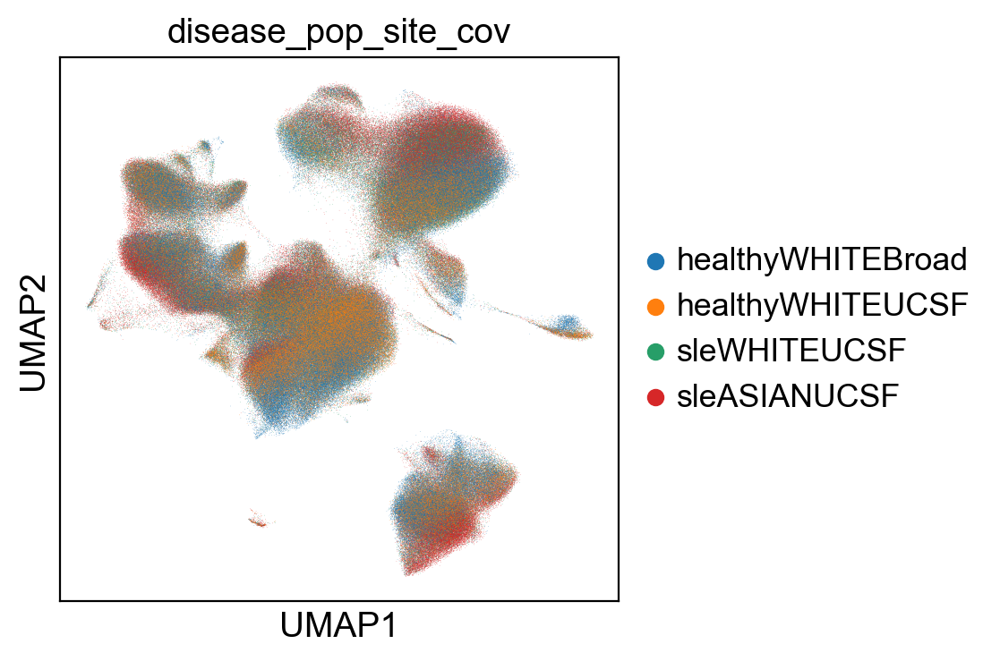

In [22]:
sc.pl.umap(adata, color="disease_pop_site_cov")

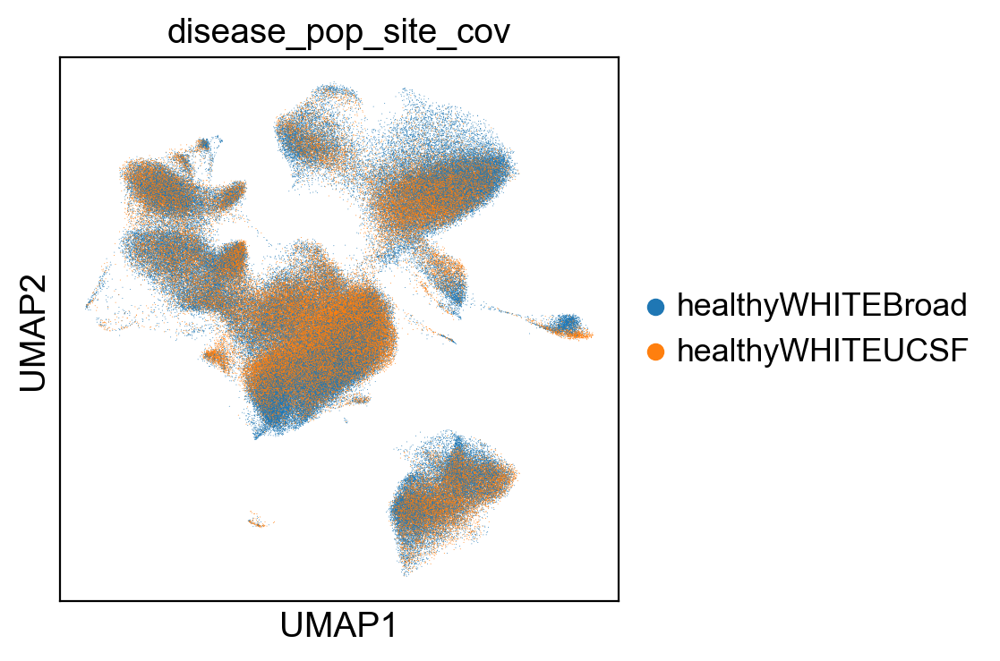

In [23]:
sc.pl.umap(adata[(adata.obs.disease_cov == "healthy")],color="disease_pop_site_cov")

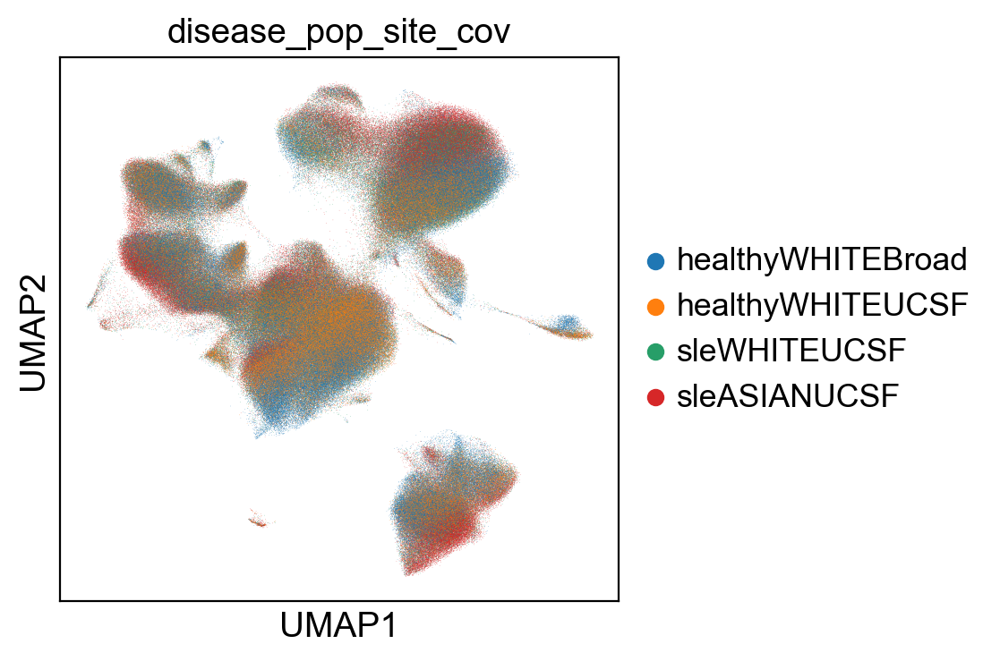

In [10]:
sc.pl.umap(adata, color="disease_pop_site_cov")

saving figure to file ./figures.V5.2/umap.disease.png


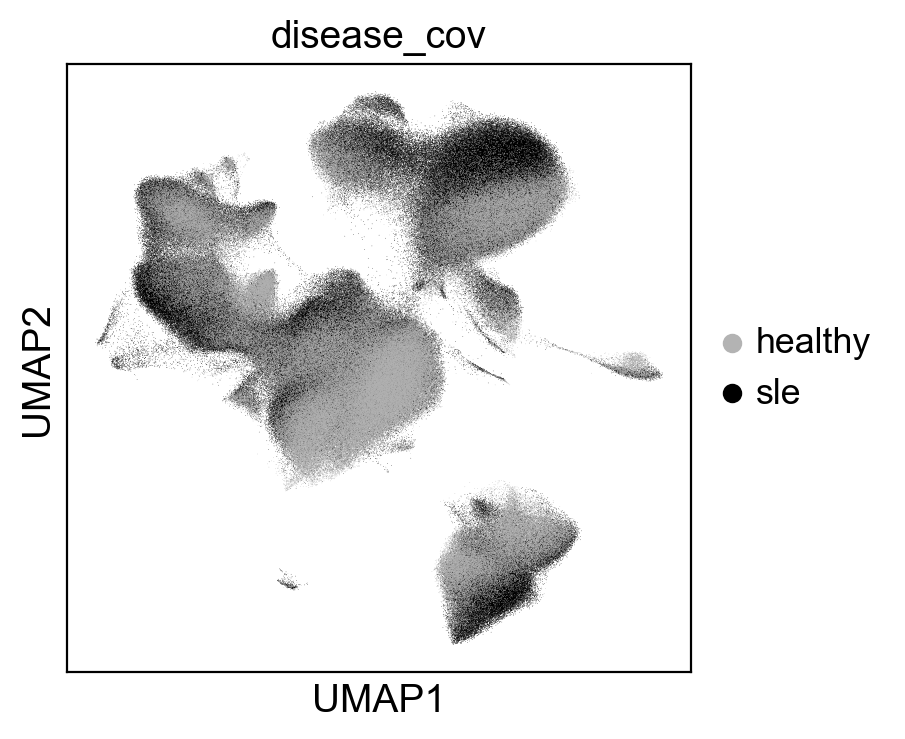

In [13]:
disease_umap = sc.pl.umap(adata, color='disease_cov', size=0.2, edgecolor="none", palette=['#B3B3B3','#000000'])
disease_umap = sc.pl.umap(adata, color='disease_cov', size=0.2, edgecolor="none", palette=['#B3B3B3','#000000'], save='.disease.png')

In [14]:
# ## Make disease plot (Fig. 1B)
# ## flipping the disease labels so that the healthy plots on top of the sle
# adata.obs['disease_cov'] = pd.Categorical(adata.obs['disease_cov'],categories=['sle','healthy'], ordered=True)
# ##adata.uns['disease_cov_colors'] = ['#3A87BC','#ED8A2F'];

# ##disease_tsne = sc.pl.tsne(adata, color='disease_cov', size=0.5)
# ##celltype_umap = sc.pl.umap(adata, color='ct_cov', size=1, edgecolor="none", save='.png')
# disease_umap = sc.pl.umap(adata, color='disease_cov', size=1, edgecolor="none", save='.disease.png')
# disease_umap = sc.pl.umap(adata, color='disease_cov', size=1, edgecolor="none")

# ## testing returning an axes object which should allow for more customization
# ## disease_tsne2 = sc.pl.tsne(adata, color='disease_cov', size=0.5, show=False)

# ## flipping the disease/healthy labels back for all of the downstream analysis
# adata.obs['disease_cov'] = pd.Categorical(adata.obs['disease_cov'],categories=['healthy','sle'], ordered=True)

## Now, let's make a plot for each of the 16 people in batch 1 as a demo of variability

### make all batches

In [15]:
# ## let's plot 16 plots for the individuals in the first batch (Fig. 1B)
# colors = ["#8ED1C6","#FCF6B5", "#BEBAD9", "#F47F72", "#81B1D3", "#FBB463", "#B4D66C", "#F9CEE1", "#DAD9D9", "#BC80B7", "#CDE6C4", "#FEEC6E", "#E31F26", "#387EB9", "#4EAF49", "#984F9F"];
# ##batch_07_19_inds = adata.obs.ind_cov[adata.obs.batch_cov=='lupus7.19'].unique()
# ##batch_07_19_inds = np.sort(batch_07_19_inds.categories.values);

# for batch_i in range(len(adata.obs.batch_cov.unique())) :
#     fig,ax = plt.subplots(nrows=4,ncols=4, figsize=(7,7),sharex=True, sharey=True)
#     fig.tight_layout()
#     ##plt.subplots_adjust(left=0, right=0.1, top=0.1, bottom=0, wspace=0.1, hspace=0.1)
#     plt.subplots_adjust(wspace=-0.1, hspace=0)

#     batch_name = adata.obs.batch_cov.unique()[batch_i]
#     batch = adata.obs.ind_cov[adata.obs.batch_cov==batch_name].unique();
#     batch = np.sort(batch.categories.values)

#     for ind_i in list(range(batch.shape[0])) :
#         ind = batch[ind_i]
#         col = colors[ind_i]
#         sc.pl.umap(adata[adata.obs.ind_cov==ind,], color = "ind_cov", title=None, palette=[col,col], ax=ax[(ind_i-1)%4,math.floor(ind_i/4)], size=20, edgecolor="none")
#         ##ax[(ind_i-1)%4,math.floor(ind_i/4)].label_outer()
#         ax[(ind_i-1)%4,math.floor(ind_i/4)].get_xaxis().set_visible(False)
#         ax[(ind_i-1)%4,math.floor(ind_i/4)].get_yaxis().set_visible(False)
#         ax[(ind_i-1)%4,math.floor(ind_i/4)].get_legend().remove()
#         ax[(ind_i-1)%4,math.floor(ind_i/4)].set_title("")
#         ax[(ind_i-1)%4,math.floor(ind_i/4)].set_aspect("equal")
    
#     fig.savefig(figdir+'/'+batch_name+'.ind.png')

### make only the first batch

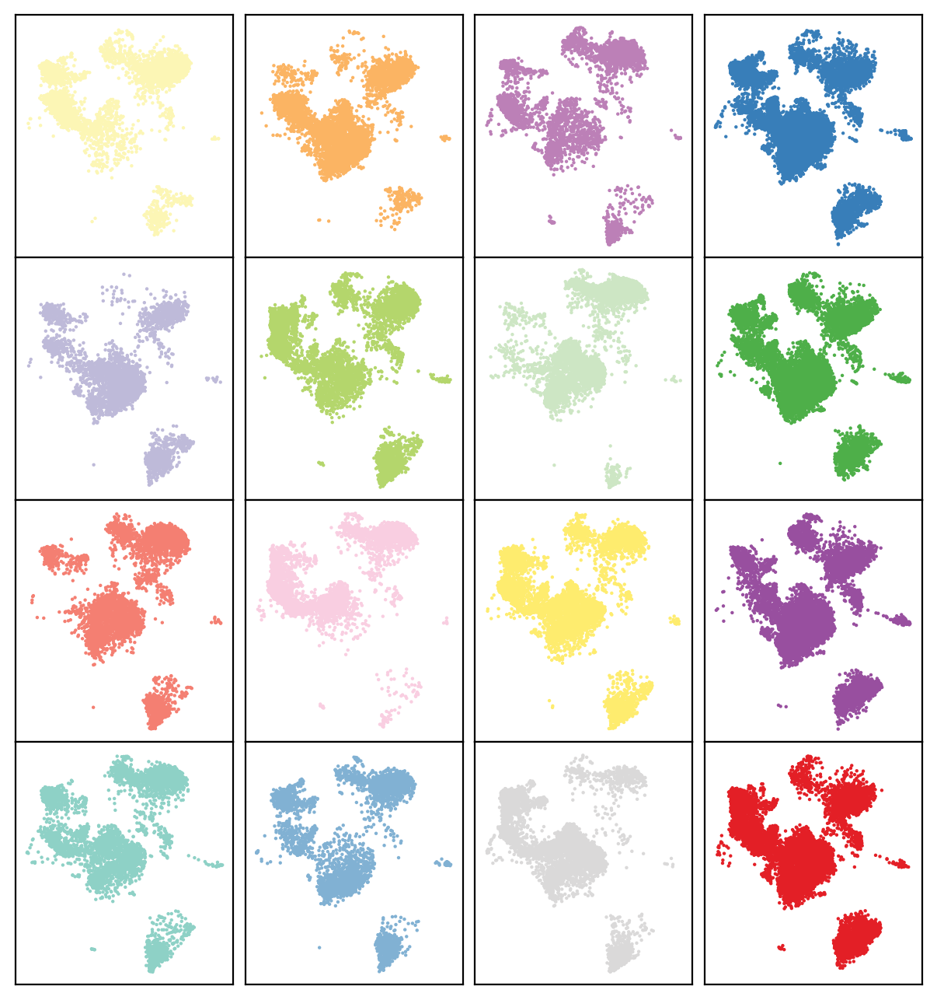

In [16]:
##sc.pl.umap(adata, color=['batch_cov'])
colors = ["#8ED1C6","#FCF6B5", "#BEBAD9", "#F47F72", "#81B1D3", "#FBB463", "#B4D66C", "#F9CEE1", "#DAD9D9", "#BC80B7", "#CDE6C4", "#FEEC6E", "#E31F26", "#387EB9", "#4EAF49", "#984F9F"];

batch_07_19_inds = adata.obs.ind_cov[adata.obs.batch_cov=='lupus7.19'].unique()
batch_07_19_inds = np.sort(batch_07_19_inds.categories.values);

fig,ax = plt.subplots(nrows=4,ncols=4, figsize=(7,7), sharex=True, sharey=True)
fig.tight_layout()
##plt.subplots_adjust(left=0, right=0.1, top=0.1, bottom=0, wspace=0.1, hspace=0.1)
plt.subplots_adjust(wspace=-0.1, hspace=0)

for ind_i in list(range(batch_07_19_inds.shape[0])) :
    ind = batch_07_19_inds[ind_i]
    col = colors[ind_i]
    sc.pl.umap(adata[adata.obs.ind_cov==ind,], color = "ind_cov", title=None, palette=[col,col], ax=ax[(ind_i-1)%4,math.floor(ind_i/4)], size=10, edgecolor="none")
    ##ax[(ind_i-1)%4,math.floor(ind_i/4)].label_outer()
    ax[(ind_i-1)%4,math.floor(ind_i/4)].get_xaxis().set_visible(False)
    ax[(ind_i-1)%4,math.floor(ind_i/4)].get_yaxis().set_visible(False)
    ax[(ind_i-1)%4,math.floor(ind_i/4)].get_legend().remove()
    ax[(ind_i-1)%4,math.floor(ind_i/4)].set_title("")
    ax[(ind_i-1)%4,math.floor(ind_i/4)].set_aspect("equal")

fig.savefig(figdir+'/umap.ind.png')

# Figure 1C: Cell type annotation of projection

## First, let's make the louvain plot

saving figure to file ./figures.V5.2/umap.louvain.png


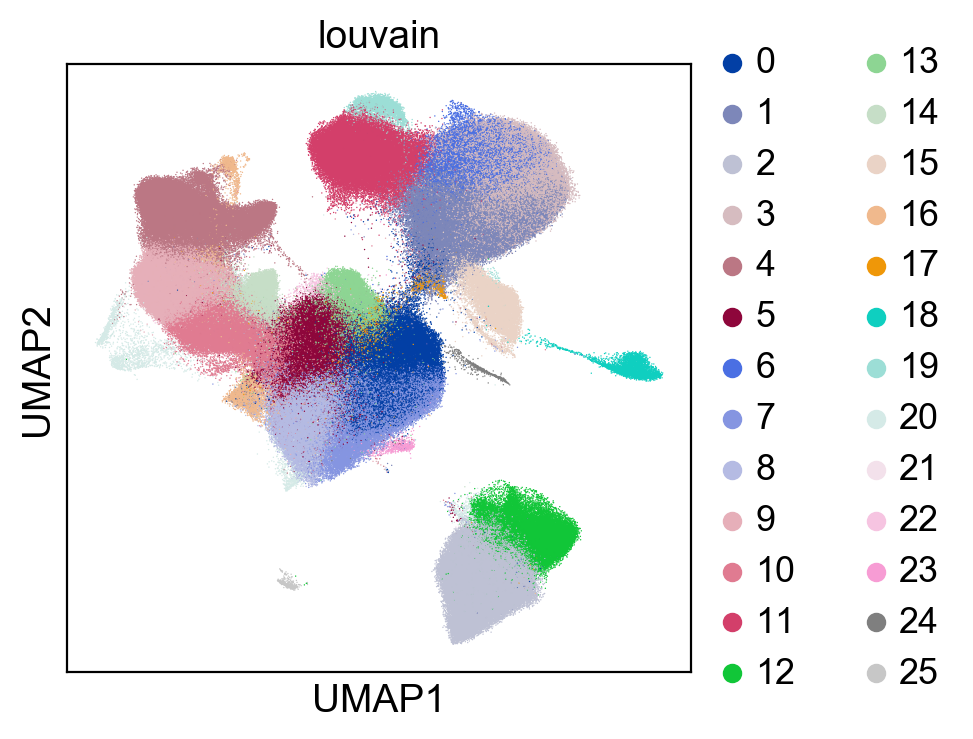

In [17]:
# sc.tl.louvain(adata, random_state=30, resolution=1.5)
sc.pl.umap(adata, color='louvain',size=1, edgecolor="none")
sc.pl.umap(adata, color='louvain', size=1, edgecolor="none", save='.louvain.png')

In [111]:
sc.tl.leiden(adata, random_state=30, resolution=4)
##adata.write("./CLUESImmVar_processed.V5.2.h5ad",compression="gzip")

running Leiden clustering
    finished (4:42:58.50)


In [21]:
np.std(adata.obs.groupby("ind_cov").agg(['count']),axis=0)[1]

1571.9979785674943

saving figure to file ./figures.V5.2/umap.leiden.png


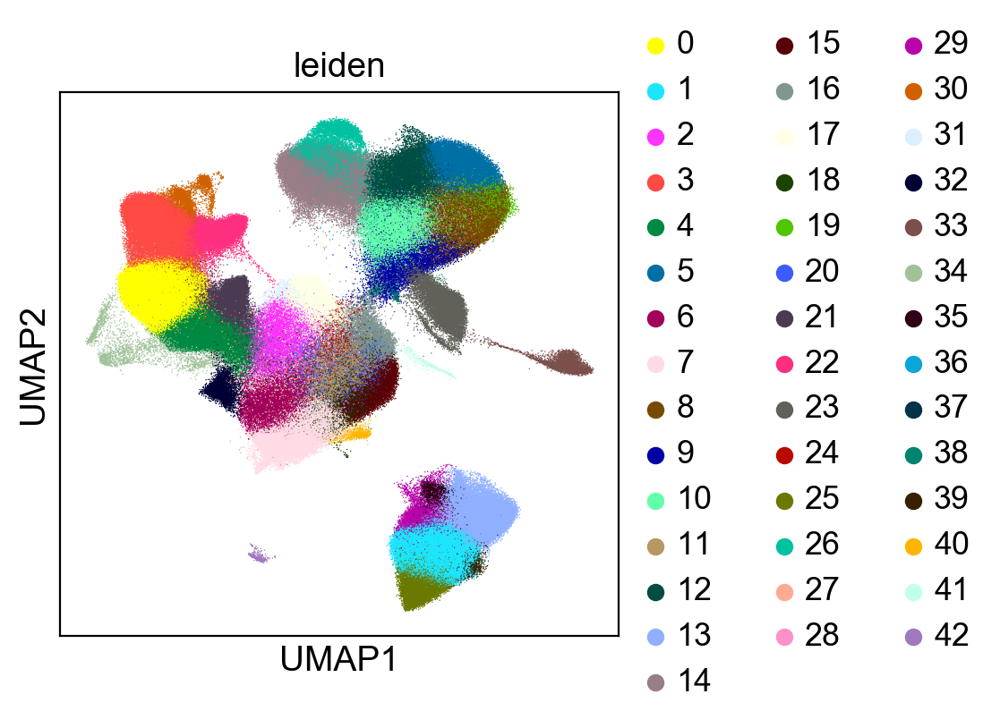

In [24]:
# sc.tl.louvain(adata, random_state=30, resolution=1.5)
sc.pl.umap(adata, color='leiden',size=1, edgecolor="none")
sc.pl.umap(adata, color='leiden', size=1, edgecolor="none", save='.leiden.png')

ranking genes
    finished (0:15:51.22)


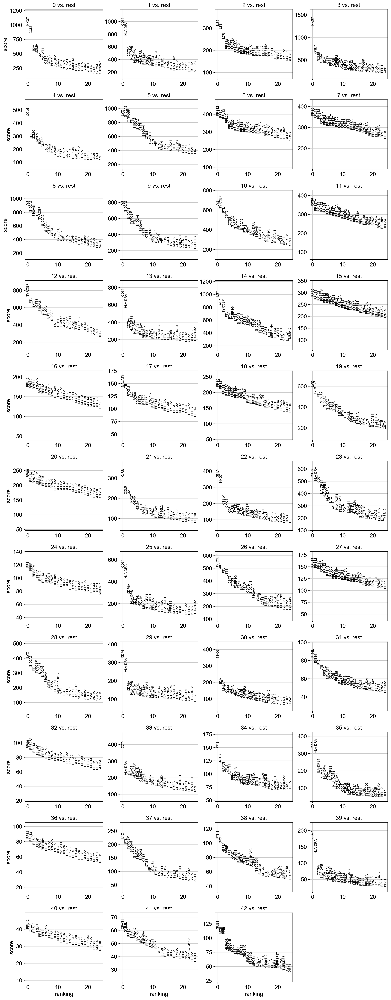

In [25]:
sc.tl.rank_genes_groups(adata, 'leiden', method='t-test')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [71]:
adata.obs.ct_cov = adata.obs.ct_cov.astype("str")
# ## do some manual cell type assignment
adata.obs.ct_cov.loc[adata.obs.leiden == "0"] = "Tc" ## good                                                                                    
adata.obs.ct_cov.loc[adata.obs.leiden == "1"] = "B" ## good                                                                                    
adata.obs.ct_cov.loc[adata.obs.leiden == "2"] = "Th" ## good                                                                                     
adata.obs.ct_cov.loc[adata.obs.leiden == "3"] = "NK" ## good                                                                                    
adata.obs.ct_cov.loc[adata.obs.leiden == "4"] = "Tc" ## good                                                                                    
adata.obs.ct_cov.loc[adata.obs.leiden == "5"] = "cM" ## good                                                                                    
adata.obs.ct_cov.loc[adata.obs.leiden == "6"] = "Tc" ## good                                                                                    
adata.obs.ct_cov.loc[adata.obs.leiden == "7"] = "Th" ## good                                                                                    
adata.obs.ct_cov.loc[adata.obs.leiden == "8"] = "cM" ## good                                                                                    
adata.obs.ct_cov.loc[adata.obs.leiden == "9"] = "cM" ## good                                                                                    
adata.obs.ct_cov.loc[adata.obs.leiden == "10"] = "cM" ## good                                                                                  
adata.obs.ct_cov.loc[adata.obs.leiden == "11"] = "Th" ## good                                                                                    
adata.obs.ct_cov.loc[adata.obs.leiden == "12"] = "cM" ## good 
##adata.obs.ct_cov.loc[adata.obs.leiden == "12"] = "Th" ## good 
adata.obs.ct_cov.loc[adata.obs.leiden == "13"] = "B" ## good                                                                                   
adata.obs.ct_cov.loc[adata.obs.leiden == "14"] = "ncM" ## good 
adata.obs.ct_cov.loc[adata.obs.leiden == "15"] = "Th" ## good                                                                                   
adata.obs.ct_cov.loc[adata.obs.leiden == "16"] = "Th" ## good                                                                                
adata.obs.ct_cov.loc[adata.obs.leiden == "17"] = "Th" ## good                                                                                  
adata.obs.ct_cov.loc[adata.obs.leiden == "18"] = "Th" ## good                                                                              
adata.obs.ct_cov.loc[adata.obs.leiden == "19"] = "cM" ## good                                                                               
adata.obs.ct_cov.loc[adata.obs.leiden == "20"] = "Th" ## good                                                                                   
adata.obs.ct_cov.loc[adata.obs.leiden == "21"] = "Tc" ## doublets or IFN activated T?                                                            
adata.obs.ct_cov.loc[adata.obs.leiden == "22"] = "NK" ## good                                                                                   
adata.obs.ct_cov.loc[adata.obs.leiden == "23"] = "cDC" ## good                                                                                    
adata.obs.ct_cov.loc[adata.obs.leiden == "24"] = "MK" ## good                                                                                    
adata.obs.ct_cov.loc[adata.obs.leiden == "25"] = "B" ## good
adata.obs.ct_cov.loc[adata.obs.leiden == "26"] = "ncM" ## good
adata.obs.ct_cov.loc[adata.obs.leiden == "27"] = "Th" ## good
adata.obs.ct_cov.loc[adata.obs.leiden == "28"] = "cM" ## good
adata.obs.ct_cov.loc[adata.obs.leiden == "29"] = "B" ## good
adata.obs.ct_cov.loc[adata.obs.leiden == "30"] = "NK" ## good
adata.obs.ct_cov.loc[adata.obs.leiden == "31"] = "Th" ## good
adata.obs.ct_cov.loc[adata.obs.leiden == "32"] = "Th" ## good
adata.obs.ct_cov.loc[adata.obs.leiden == "33"] = "pDC" ## good
adata.obs.ct_cov.loc[adata.obs.leiden == "34"] = "ProlifT" ## good
adata.obs.ct_cov.loc[adata.obs.leiden == "35"] = "B" ## good
adata.obs.ct_cov.loc[adata.obs.leiden == "36"] = "Th" ## good
adata.obs.ct_cov.loc[adata.obs.leiden == "37"] = "cM" ## good
adata.obs.ct_cov.loc[adata.obs.leiden == "38"] = "MK" ## good
adata.obs.ct_cov.loc[adata.obs.leiden == "39"] = "B" ## good
adata.obs.ct_cov.loc[adata.obs.leiden == "40"] = "Th" ## good
adata.obs.ct_cov.loc[adata.obs.leiden == "41"] = "Progen" ## good
adata.obs.ct_cov.loc[adata.obs.leiden == "42"] = "B" ## good

adata.obs.ct_cov = adata.obs.ct_cov.astype('category')

... storing 'ct_cov' as categorical


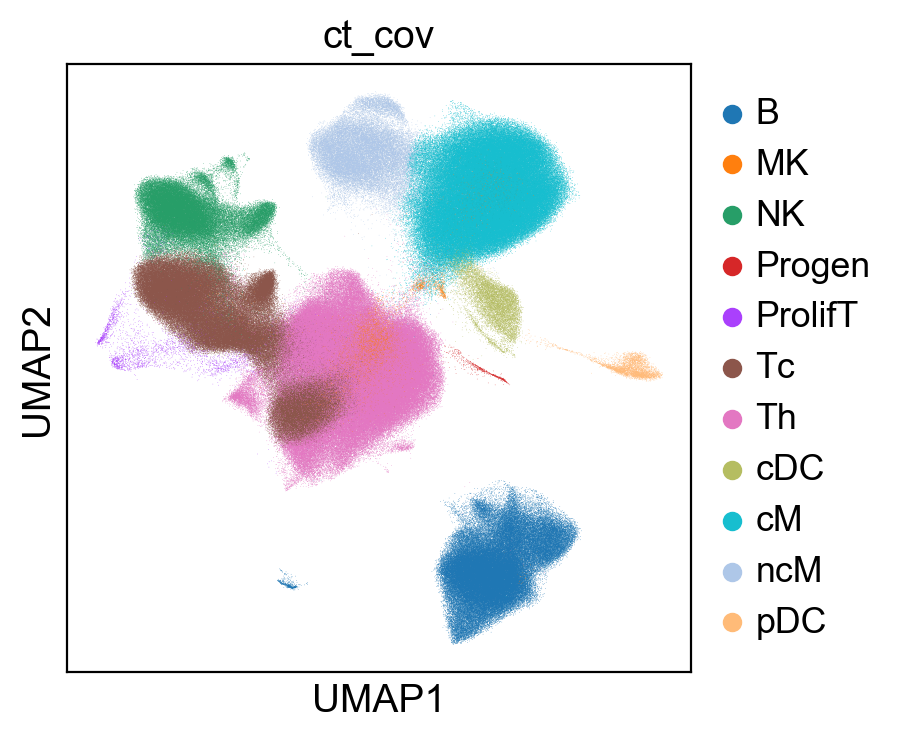

In [72]:
## Make cell type plot (Fig. 1C)
adata.obs.ct_cov = adata.obs.ct_cov.astype("str")
adata.uns['ct_cov_colors'] = sc.pl.palettes.vega_20_scanpy;
celltype_umap = sc.pl.umap(adata, color='ct_cov',size=0.2, edgecolor="none")

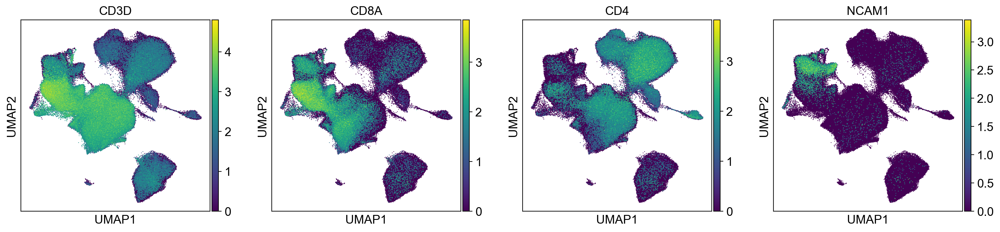

In [68]:
sc.pl.umap(adata, color=["CD3D","CD8A","CD4","NCAM1"],size=3)

saving figure to file ./figures.V5.2/umap.celltype.png


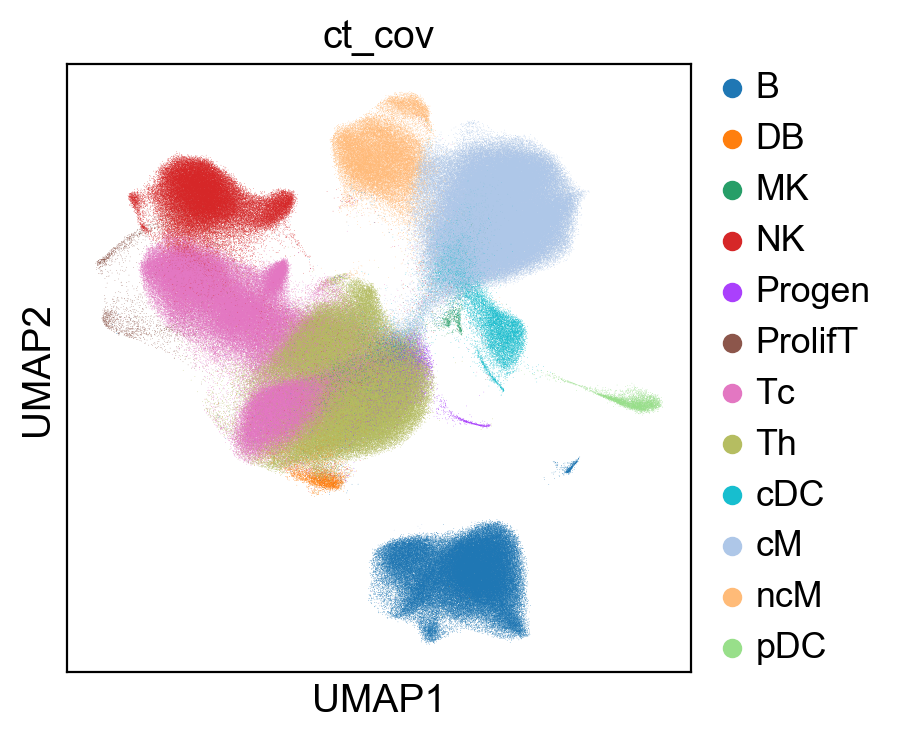

In [971]:
## Make cell type plot (Fig. 1C)
adata.uns['ct_cov_colors'] = sc.pl.palettes.vega_20_scanpy;
celltype_umap = sc.pl.umap(adata, color='ct_cov',size=0.2, edgecolor="none")
celltype_umap = sc.pl.umap(adata, color='ct_cov', size=0.2, edgecolor="none", save='.celltype.png')


saving figure to file ./figures.V5.1/umap.celltype.png


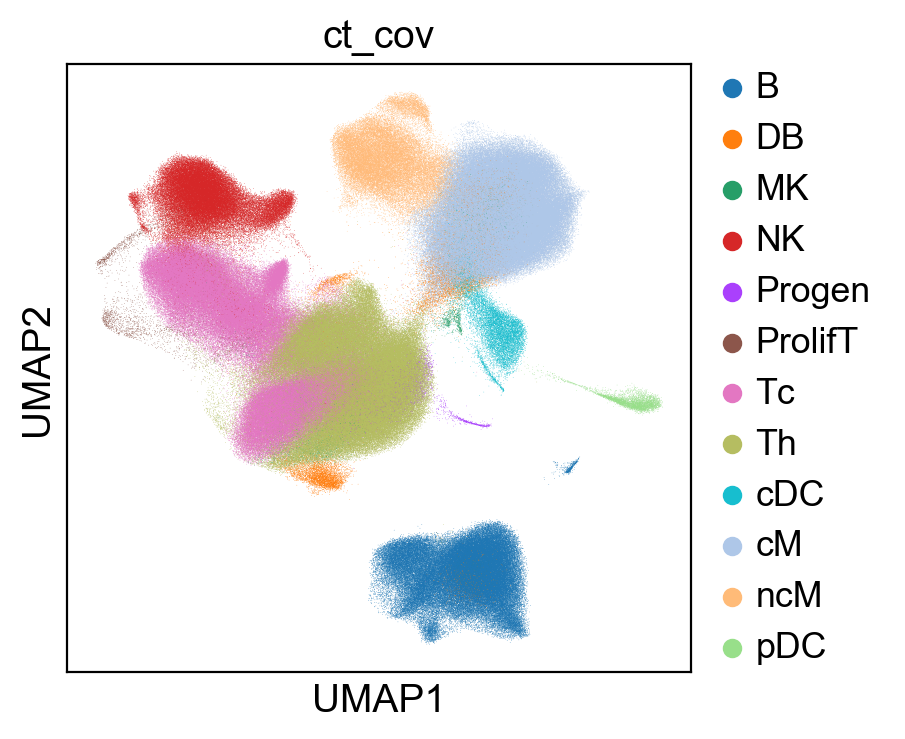

In [825]:
## Make cell type plot (Fig. 1C)
adata.uns['ct_cov_colors'] = sc.pl.palettes.vega_20_scanpy;
celltype_umap = sc.pl.umap(adata, color='ct_cov', size=0.2, edgecolor="none", save='.celltype.png')
celltype_umap = sc.pl.umap(adata, color='ct_cov',size=0.2, edgecolor="none")

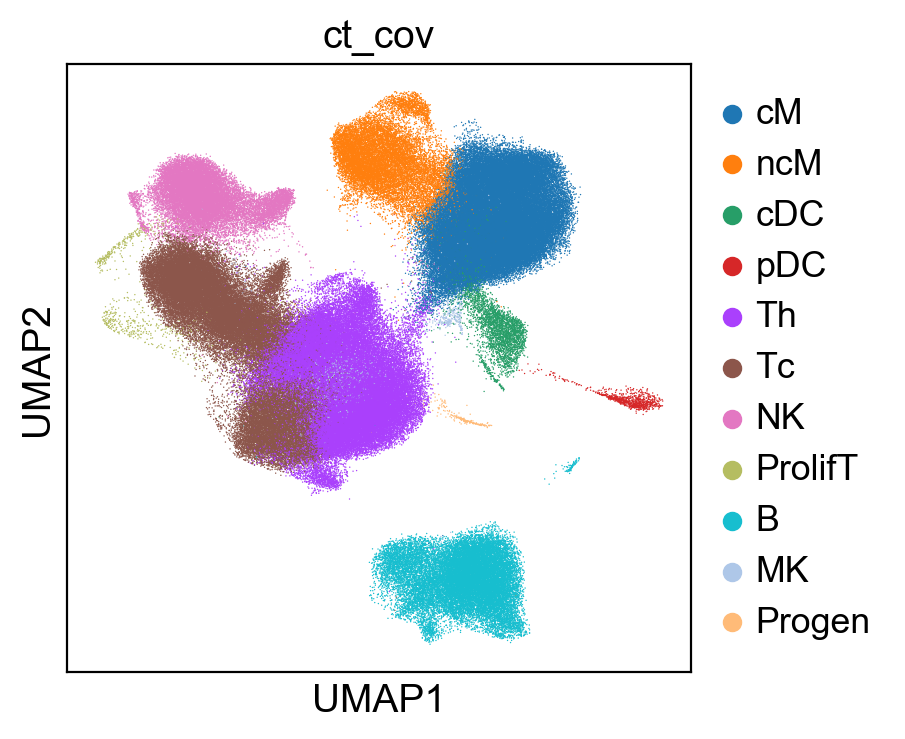

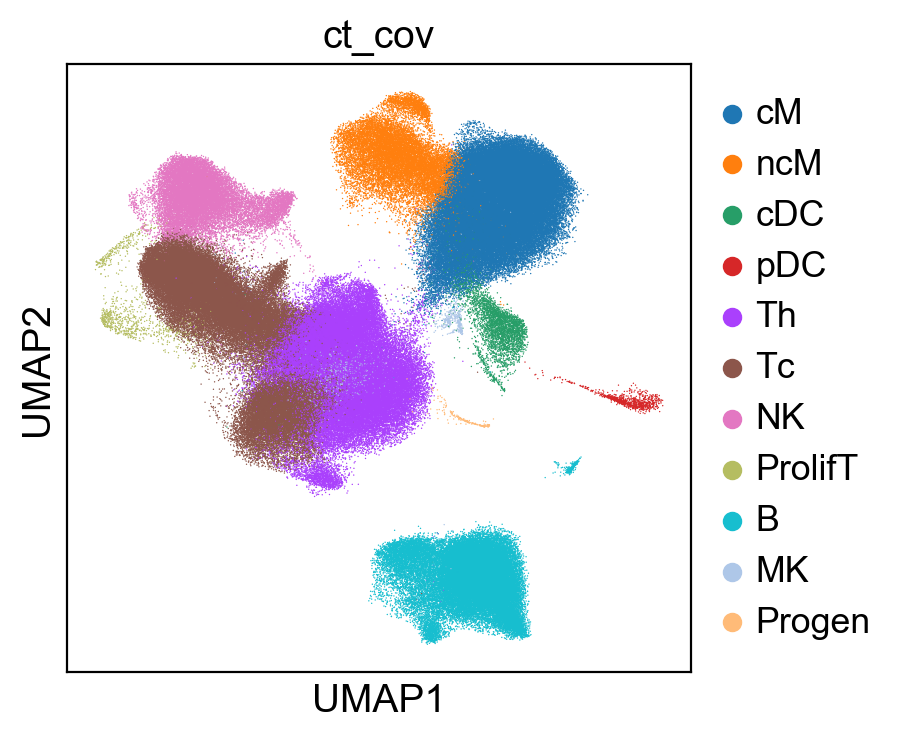

In [19]:
celltype_umap = sc.pl.umap(adata[(adata.obs.disease_cov=="sle") & (adata.obs.pop_cov=="WHITE")], color='ct_cov',size=1, edgecolor="none")
celltype_umap = sc.pl.umap(adata[(adata.obs.disease_cov=="sle") & (adata.obs.pop_cov=="ASIAN")], color='ct_cov',size=1, edgecolor="none")

saving figure to file ./figures.V5.1/umap.platelet.png


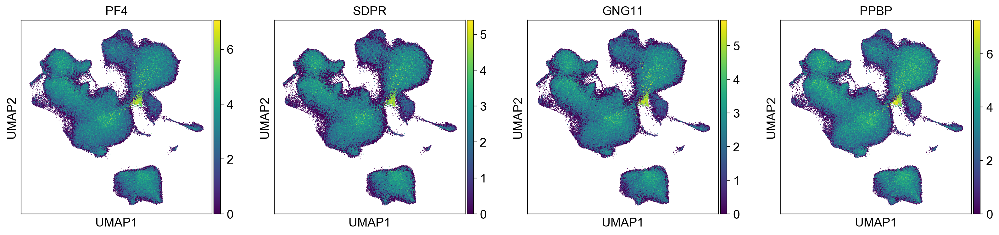

In [20]:
## platelet effect
sc.pl.umap(adata, color=["PF4", "SDPR", "GNG11", "PPBP"], size=3)
sc.pl.umap(adata, color=["PF4", "SDPR", "GNG11", "PPBP"], size=3, save='.platelet.png')

saving figure to file ./figures.V5.1/umap.cycling.png


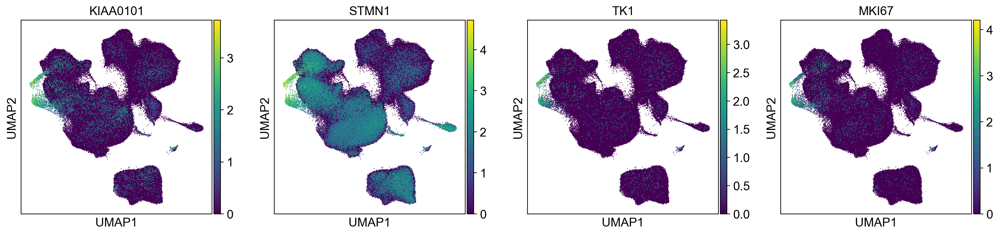

In [21]:
## cycling
sc.pl.umap(adata, color=["KIAA0101","STMN1","TK1","MKI67"], size=3)
sc.pl.umap(adata, color=["KIAA0101","STMN1","TK1","MKI67"], size=3, save='.cycling.png')

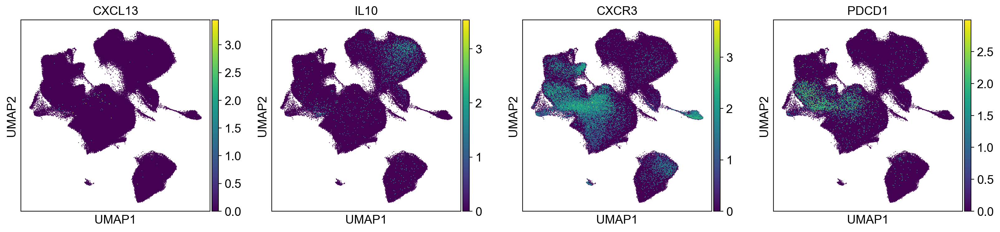

In [115]:
sc.pl.umap(adata, color=["CXCL13", "IL10", "CXCR3", "PDCD1"], size=3)

saving figure to file ./figures.V5.1/umap.TNK.png


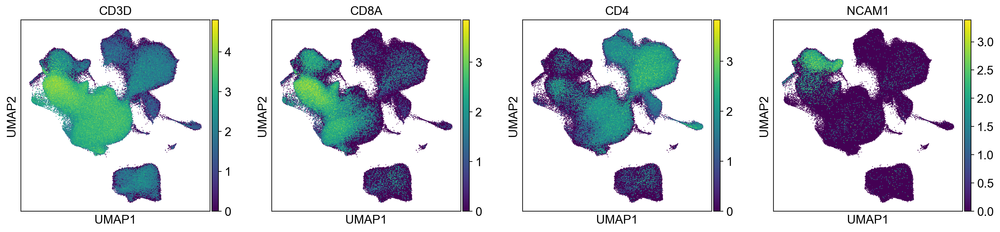

In [22]:
## CD4, CD8 and NK axis
sc.pl.umap(adata, color=["CD3D","CD8A","CD4","NCAM1"],size=3)
sc.pl.umap(adata, color=["CD3D","CD8A","CD4","NCAM1"],size=3, save=".TNK.png")

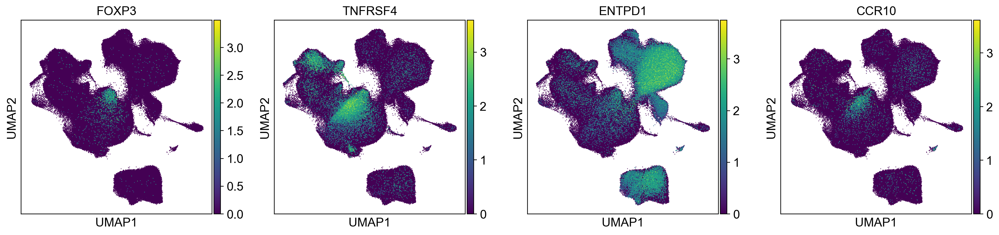

In [23]:
## treg
sc.pl.umap(adata, color=["FOXP3","TNFRSF4","ENTPD1","CCR10"],size=3)

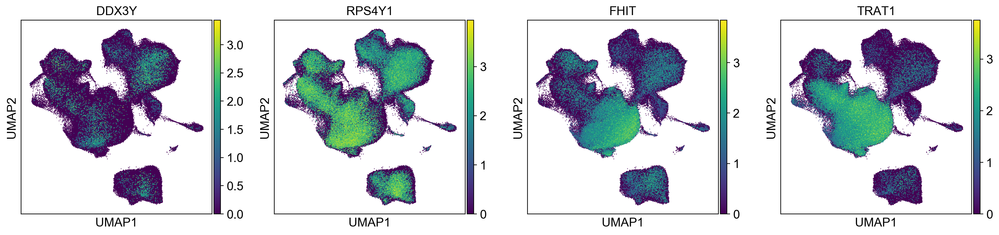

In [24]:
## y chromosome gender effect
sc.pl.umap(adata, color=["DDX3Y", "RPS4Y1", "FHIT","TRAT1"], size =3)

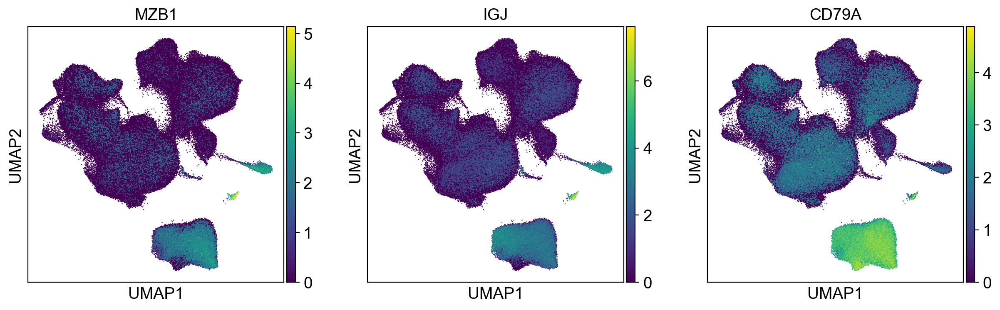

In [25]:
## b cells, plasmablasts and pdcs
sc.pl.umap(adata, color=["MZB1", "IGJ", "CD79A"],size=3)

# Figure 1D: Cell type proportion differences between case/control

## Cell proportion analysis using Broad ImmVar

In [73]:
## Make proportion plots (Fig. 1D)

adata_obs_small = adata.obs[(adata.obs.well.str.contains("immvar")) & (adata.obs.ind_cov.str.contains("IGTB")) | (~adata.obs.ind_cov.str.contains("IGTB") & ~adata.obs.well.str.contains("immvar"))]
##adata_obs_small = adata.obs[(adata.obs.batch_cov.str.contains("lupus"))]

##ind_count = adata_obs_small.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov','batch_cov'])['ct_cov'].count()

## no batch_cov so that we aggregate the count for the two healthy controls
ind_count = adata_obs_small.groupby(['ind_cov','ct_cov','disease_cov','pop_cov',"batch_cov"])['ct_cov'].count()

##ind_count = adata.obs.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()
##ind_count = adata.obs.groupby(['ind_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()

##ind_count = ind_count.reset_index(name="counts")
ind_count_sums = ind_count.groupby(level=[0]).sum()
ind_count_sums = ind_count_sums.reset_index(name="counts")

ind_perc = ind_count/ind_count.groupby(level=[0]).transform(sum)*100
ind_perc = ind_perc.reset_index(name="ct_perc")

## filter samples that have < 100 cells
ind_perc = ind_perc[ind_perc.ind_cov.isin(ind_count_sums.ind_cov[ind_count_sums.counts > 100])]

##ct_group = pd.DataFrame( {'ct_cov':['B','CD14 Monoc','CD16 Monoc', 'CD4+ T', 'CD8+ T', 'MK', 'NK', 'cDC', 'pDC','Progenitor','Proliferat'], 'ct_group':['lymph', 'mono', 'mono', 'lymph','lymph', 'mkc','lymph','dc','pdc','progen','lymph']})
cg_cov = pd.DataFrame( {'ct_cov':['B','cM','ncM', 'Th', 'Tc', 'NK', 'ProlifT', 'cDC', 'pDC', 'MK', 'Progen'], 'cg_cov':['lymph', 'mono', 'mono', 'lymph','lymph', 'lymph', 'lymph', 'cdc','pdc', 'mk', 'progen']})
ind_perc.ind_cov = ind_perc.ind_cov.apply(lambda x: x.split('_')[0])
ind_count_sums.ind_cov = ind_count_sums.ind_cov.apply(lambda x: x.split('_')[0])
ind_perc = ind_perc.set_index('ct_cov').join(cg_cov.set_index('ct_cov'))
ind_perc.ind_cov = ind_perc.ind_cov.astype("str")
##ind_perc.batch_cov = ind_perc.batch_cov.astype("str")
ind_perc.reset_index(inplace=True)
ind_perc.ct_cov = ind_perc.ct_cov.astype('category')
ind_perc.ct_cov = ind_perc.ct_cov.cat.reorder_categories(adata.obs.ct_cov.cat.categories.values)

print('as a proportion of total PBMC ')

all_out = pd.DataFrame();

for ct_i in list(range(11)) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = ind_perc.ct_perc[ind_perc.ct_cov==ct]
    disease = ind_perc.disease_cov[ind_perc.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    ##print('Cell type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), disease.astype(float))
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    all_out = all_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval)}), ignore_index=True)
    
print(all_out)

print('\nwhite sle vs white healthy')

white_out = pd.DataFrame();

for ct_i in list(range(11)) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = ind_perc[ind_perc.pop_cov=="WHITE"].ct_perc[ind_perc.ct_cov==ct]
    disease = ind_perc[ind_perc.pop_cov=="WHITE"].disease_cov[ind_perc.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    ##print('Cell type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), disease.astype(float))
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    white_out = white_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval)}), ignore_index=True)
    
print(white_out)

print('\nasian sle vs white healthy')

for ct_i in list(range(11)) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = ind_perc[((ind_perc.pop_cov=="WHITE") & (ind_perc.disease_cov=="healthy")) | ((ind_perc.pop_cov=="ASIAN") & (ind_perc.disease_cov=="sle"))].ct_perc[ind_perc.ct_cov==ct]
    disease = ind_perc[((ind_perc.pop_cov=="WHITE") & (ind_perc.disease_cov=="healthy")) | ((ind_perc.pop_cov=="ASIAN") & (ind_perc.disease_cov=="sle"))].disease_cov[ind_perc.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    print('Cell type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), disease.astype(float))
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    print('Beta='+str(effect)+', pvalue='+str(pval))
    
    
print('\nwhite sle vs asian sle')

for ct_i in list(range(11)) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = ind_perc[ind_perc.disease_cov=="sle"].ct_perc[ind_perc.ct_cov==ct]
    pop = ind_perc[ind_perc.disease_cov=="sle"].pop_cov[ind_perc.ct_cov==ct]
    pop = pop.astype("str")
    pop.values[pop=="ASIAN"] = 0
    pop.values[pop=="WHITE"] = 1
    pop = sm.add_constant(pop)
    ##data = data.assign(ct_perc=ct_perc)
    print('Cell type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), pop.astype(float))
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    print('Beta='+str(effect)+', pvalue='+str(pval))

as a proportion of total PBMC 
                     Beta     Cell                    Pval
0      0.9195172470632356        B      0.5113651028027564
1     -0.3072435605189028       MK   0.0034280138044874213
2      1.0844119703960167       NK     0.13821194049705293
3   -0.014893752443362485   Progen     0.18909846596752672
4    -0.22518791027438181  ProlifT   0.0011259285440851363
5      -3.513169794983077       Tc     0.01392056051161612
6      13.303653186022634       Th  5.9040271118060524e-15
7     0.19907374778215864      cDC     0.08614575286645751
8      -10.68884208662353       cM   3.158033591806458e-09
9     -1.3073865605498025      ncM   0.0036939001812869455
10     0.5510669903734158      pDC   6.608244957942902e-23

white sle vs white healthy
                     Beta     Cell                    Pval
0       3.564978605372984        B    0.005734347426359119
1     -0.4515246037372054       MK  0.00026728419827955923
2     0.10496000437998698       NK      0.90272105857252

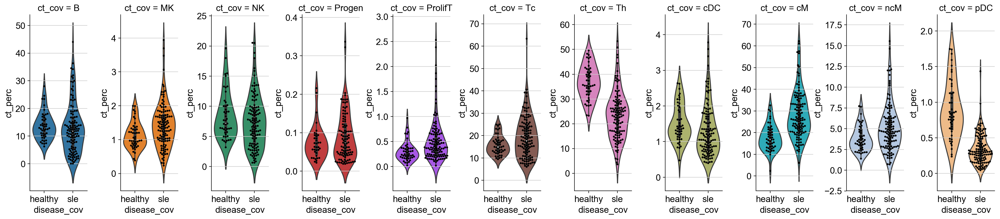

In [74]:
perc_plot = sns.catplot(x='disease_cov', y='ct_perc', hue='ct_cov', data=ind_perc, kind='violin', col='ct_cov', dodge=False, aspect=0.4, sharex=False, sharey=False)

for ct_i in list(range(len(ind_perc.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    sns.swarmplot(x="disease_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color="0", size=3, ax=perc_plot.axes[0,ct_i])

perc_plot.savefig(figdir+"/violin.ct_cov.png")
#fig,ax = plt.subplots(nrows=1,ncols=10, figsize=(20,5))
#fig.tight_layout()

##for ct_i in list(range(10)) :
##    ct = ind_perc.ct_cov.cat.categories[ct_i]
##    sns.boxplot(x="disease_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color=sc.pl.palettes.vega_20_scanpy[ct_i], ax=ax[ct_i])
##    sns.swarmplot(x="disease_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color="0", size=3, ax=ax[ct_i])

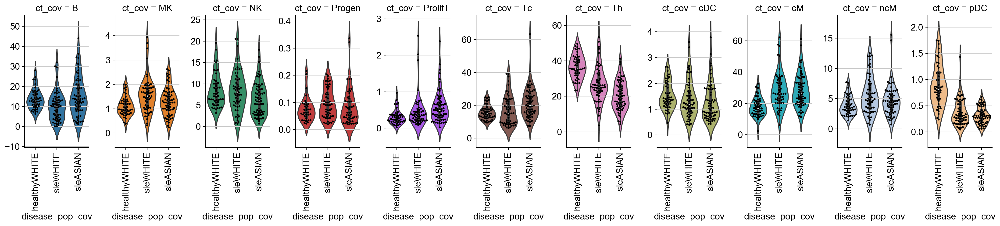

In [75]:
ind_perc['disease_pop_cov'] = pd.Categorical(ind_perc.apply(lambda row: row['disease_cov'] + row['pop_cov'], axis=1),
                                             categories=['healthyWHITE','sleWHITE','sleASIAN'],
                                             ordered=True)
perc_plot = sns.catplot(x='disease_pop_cov', y='ct_perc', hue='ct_cov', data=ind_perc, kind='violin', col='ct_cov', aspect=0.5, height=4, 
                        dodge=False, sharex=False, sharey=False)
perc_plot.set_xticklabels(rotation=90)
perc_plot.fig.subplots_adjust(wspace=0.4)
##perc_plot.tight_layout()

for ct_i in list(range(len(ind_perc.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    sns.swarmplot(x="disease_pop_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color="0", size=3, ax=perc_plot.axes[0,ct_i])
    perc_plot.axes[0,ct_i].get_yaxis().label.set_visible(False)


perc_plot.savefig(figdir+"/violin.ct_cov_pop.png")

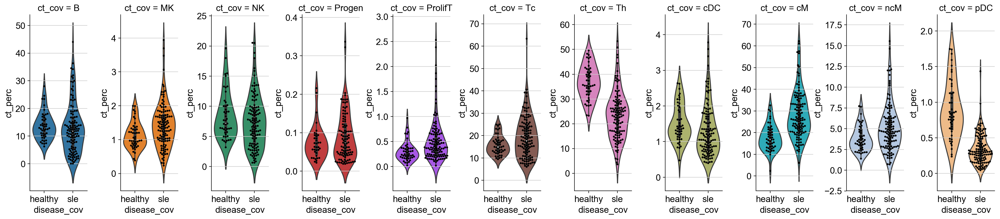

In [76]:
perc_plot = sns.catplot(x='disease_cov', y='ct_perc', hue='ct_cov', data=ind_perc, kind='violin', col='ct_cov', dodge=False, aspect=0.4, sharex=False, sharey=False)

for ct_i in list(range(len(ind_perc.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    sns.swarmplot(x="disease_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color="0", size=3, ax=perc_plot.axes[0,ct_i])

perc_plot.savefig(figdir+"/violin.ct_cov.png")
#fig,ax = plt.subplots(nrows=1,ncols=10, figsize=(20,5))
#fig.tight_layout()

##for ct_i in list(range(10)) :
##    ct = ind_perc.ct_cov.cat.categories[ct_i]
##    sns.boxplot(x="disease_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color=sc.pl.palettes.vega_20_scanpy[ct_i], ax=ax[ct_i])
##    sns.swarmplot(x="disease_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color="0", size=3, ax=ax[ct_i])

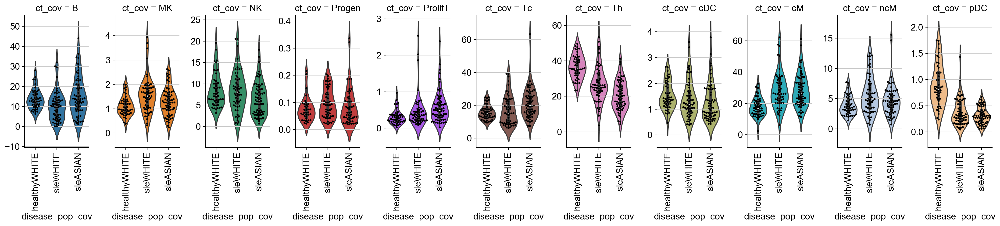

In [77]:
ind_perc['disease_pop_cov'] = pd.Categorical(ind_perc.apply(lambda row: row['disease_cov'] + row['pop_cov'], axis=1),
                                             categories=['healthyWHITE','sleWHITE','sleASIAN'],
                                             ordered=True)
perc_plot = sns.catplot(x='disease_pop_cov', y='ct_perc', hue='ct_cov', data=ind_perc, kind='violin', col='ct_cov', aspect=0.5, height=4, 
                        dodge=False, sharex=False, sharey=False)
perc_plot.set_xticklabels(rotation=90)
perc_plot.fig.subplots_adjust(wspace=0.4)
##perc_plot.tight_layout()

for ct_i in list(range(len(ind_perc.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    sns.swarmplot(x="disease_pop_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color="0", size=3, ax=perc_plot.axes[0,ct_i])
    perc_plot.axes[0,ct_i].get_yaxis().label.set_visible(False)


perc_plot.savefig(figdir+"/violin.ct_cov_pop.png")

In [78]:
# fig,ax = plt.subplots(nrows=1,ncols=11, figsize=(20,5))
# fig.tight_layout()


# for ct_i in list(range(11)) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ax[ct_i].set_yscale('log')
#     ax[ct_i].set_ylim(0.1,100)
#     sns.boxplot(x="disease_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color=sc.pl.palettes.vega_20_scanpy[ct_i], ax=ax[ct_i])
#     sns.swarmplot(x="disease_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color="0", size=3, ax=ax[ct_i])

## Cell proportion analysis of replicated healthy individuals at UCSF

In [79]:
adata_obs_small = adata.obs[(adata.obs.batch_cov.str.contains("lupus"))& (adata.obs.ind_cov.str.contains("IGTB"))]

ind_count2 = adata_obs_small.groupby(['ind_cov','ct_cov','disease_cov','pop_cov',"batch_cov"])['ct_cov'].count()

##ind_count = ind_count.reset_index(name="counts")
ind_count2_sums = ind_count2.groupby(["ind_cov","batch_cov"]).sum()
ind_count2_sums = ind_count2_sums.reset_index(name="counts")

##ind_count2_sums = ind_count2.groupby(level=[0]).sum()
##ind_count2_sums = ind_count2_sums.reset_index(name="counts")

ind_perc2 = ind_count2/ind_count2.groupby(["ind_cov","batch_cov"]).transform(sum)*100
##ind_perc2 = ind_count2/ind_count2_sums*100
ind_perc2 = ind_perc2.reset_index(name="ct_perc")
ind_perc2['disease_pop_cov'] = pd.Categorical(ind_perc2.apply(lambda row: row['disease_cov'] + row['pop_cov'], axis=1),
                                             categories=['healthyWHITE','sleWHITE','sleASIAN'],
                                             ordered=True)

cg_cov = pd.DataFrame( {'ct_cov':['B','cM','ncM', 'Th', 'Tc', 'NK', 'ProlifT', 'cDC', 'pDC', 'MK', 'Progen'], 'cg_cov':['lymph', 'mono', 'mono', 'lymph','lymph', 'lymph', 'lymph', 'cdc','pdc', 'mk', 'progen']})
ind_perc2.ind_cov = ind_perc2.ind_cov.apply(lambda x: x.split('_')[0])
ind_count2_sums.ind_cov = ind_count2_sums.ind_cov.apply(lambda x: x.split('_')[0])
ind_perc2 = ind_perc2.set_index('ct_cov').join(cg_cov.set_index('ct_cov'))
ind_perc2.ind_cov = ind_perc2.ind_cov.astype("str")
##ind_perc.batch_cov = ind_perc.batch_cov.astype("str")
ind_perc2.reset_index(inplace=True)
ind_perc2.ct_cov = ind_perc2.ct_cov.astype('category')
ind_perc2.ct_cov = ind_perc2.ct_cov.cat.reorder_categories(adata.obs.ct_cov.cat.categories.values)

ind_perc_all_healthy = ind_perc[ind_perc.disease_cov=="healthy"].append(ind_perc2)
ind_perc_all_healthy_pivot = ind_perc_all_healthy.pivot_table(index=["ct_cov"], columns=["ind_cov","batch_cov"], values="ct_perc")

ind_perc2_pivot = ind_perc2.pivot_table(index=["ct_cov"], columns=["ind_cov","batch_cov"], values="ct_perc")
ind_perc2_pivot_cg_cov = ind_perc2.pivot_table(index=["cg_cov"], columns=["ind_cov","batch_cov"], values="ct_perc")
## filter samples that have < 100 cells
##ind_perc2 = ind_perc2[ind_perc2.ind_cov.isin(ind_count2_sums.ind_cov[ind_count2_sums.counts > 100])]

# g = sns.FacetGrid(ind_perc2, col="ct_cov",  hue="ct_cov", aspect=0.8, height=3, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy)
# g = g.map(plt.scatter, "", "ct_percs", edgecolor="w")
# g.fig.subplots_adjust(wspace=0.2)
# g.savefig(figdir+"/ifn.ct_cov.png")

In [80]:
# ind_perc2_pivot_cor = ind_perc2_pivot.corr()
# ##np.fill_diagonal(ind_perc2_pivot_cor.values,np.nan)
# ind_perc2_pivot_cor_norm=(ind_perc2_pivot_cor-ind_perc2_pivot_cor.mean())/ind_perc2_pivot_cor.std()

# fig, ax = plt.subplots(figsize=(15,15))
# ax = sns.heatmap(ind_perc2_pivot_cor_norm)

### looking at the UCSF samples with themselves

In [81]:
ind_perc2_ucsf_duplicated = ind_perc2[ind_perc2.duplicated(["ct_cov","ind_cov"], keep=False)]

ind_perc2_ucsf_rep1 = ind_perc2_ucsf_duplicated[ind_perc2_ucsf_duplicated.duplicated(["ct_cov","ind_cov"], keep="first")]
ind_perc2_ucsf_rep2 = ind_perc2_ucsf_duplicated[ind_perc2_ucsf_duplicated.duplicated(["ct_cov","ind_cov"], keep="last")]

ind_perc2_ucsf_rep1_pivot = ind_perc2_ucsf_rep1.pivot_table(index=["ct_cov"], columns=["ind_cov","batch_cov"], values="ct_perc")
ind_perc2_ucsf_rep1_cg_cov = ind_perc2_ucsf_rep1.groupby(["ind_cov","batch_cov","cg_cov"])["ct_perc"].sum()
ind_perc2_ucsf_rep1_cg_cov = ind_perc2_ucsf_rep1_cg_cov.reset_index(name="cg_perc")
ind_perc2_ucsf_rep1_cg_cov_pivot = ind_perc2_ucsf_rep1_cg_cov.pivot_table(index=["cg_cov"], columns=["ind_cov","batch_cov"], values="cg_perc")

ind_perc2_ucsf_rep2_pivot = ind_perc2_ucsf_rep2.pivot_table(index=["ct_cov"], columns=["ind_cov","batch_cov"], values="ct_perc")
ind_perc2_ucsf_rep2_cg_cov = ind_perc2_ucsf_rep2.groupby(["ind_cov","batch_cov","cg_cov"])["ct_perc"].sum()
ind_perc2_ucsf_rep2_cg_cov = ind_perc2_ucsf_rep2_cg_cov.reset_index(name="cg_perc")
ind_perc2_ucsf_rep2_cg_cov_pivot = ind_perc2_ucsf_rep2_cg_cov.pivot_table(index=["cg_cov"], columns=["ind_cov","batch_cov"], values="cg_perc")

print(ind_perc2_ucsf_rep1.shape)
print(ind_perc2_ucsf_rep2.shape)

(186, 8)
(186, 8)


## leiden proportion analysis

In [82]:
# ct_counts=adata_obs_small.groupby(['ind_cov', 'pop_cov', 'disease_cov', 'batch_cov', 'leiden'])['leiden'].count()

# ##ind_count = ind_count.reset_index(name="counts")
# ct_counts_sums = ct_counts.groupby(["ind_cov","batch_cov"]).sum()
# ct_counts_sums = ct_counts_sums.reset_index(name="counts")

# ct_percs = ct_counts/ct_counts.groupby(["ind_cov","batch_cov"]).transform(sum)*100
# ct_percs = ct_percs.reset_index(name='ct_percs')

# ct_percs.ind_cov = ct_percs.ind_cov.apply(lambda x: x.split('_')[0])
# ct_percs.ind_cov = ct_percs.ind_cov.astype("str")
# ct_percs.reset_index(inplace=True)
# ct_percs.leiden = ct_percs.leiden.astype("category")
# ct_df=ct_percs.unstack(level=2, fill_value=0)

# ct_percs['site'] = pd.Categorical(ct_percs.disease_cov, categories=['Broad','UCSF'])
# ct_percs.site[ct_percs.batch_cov.str.contains("immvar")] = "Broad"
# ct_percs.site[~ct_percs.batch_cov.str.contains("immvar")] = "UCSF"

# ct_percs['disease_pop_cov'] = pd.Categorical(ct_percs.apply(lambda row: row['disease_cov'] + row['pop_cov'], axis=1),
#                                              categories=['healthyWHITE','sleWHITE','sleASIAN'],
#                                              ordered=True)

# ct_percs['disease_pop_site_cov'] = pd.Categorical(ct_percs.apply(lambda row: row['disease_cov'] + row['pop_cov'] + row['site'], axis=1),
#                                              categories=['healthyWHITEBroad','healthyWHITEUCSF','sleWHITEUCSF','sleASIANUCSF'],
#                                              ordered=True)


# ##plt.figure(figsize=(20,8))
# plot=sns.catplot(x='disease_pop_site_cov', y='ct_percs', hue='leiden', data=ct_percs, kind='violin', col='leiden', dodge=False, aspect=0.5, height=4, sharex=False, sharey=False, palette=adata.uns['leiden_colors'], cut=0) #, palette=sc.pl.palettes.vega_20_scanpy
# plot.set_xticklabels(rotation=90)
# plot.fig.subplots_adjust(wspace=0.4)

# for ct_i in list(range(len(ct_percs.leiden.cat.categories))) :
#     ct = ct_percs.leiden.cat.categories[ct_i]
#     sns.swarmplot(x="disease_pop_site_cov", y="ct_percs", data=ct_percs[ct_percs.leiden == ct], color="0", size=3, ax=plot.axes[0,ct_i])
#     plot.axes[0,ct_i].get_yaxis().label.set_visible(False)

# #plot.savefig(figdir+"/violin.cd4_pop.png")
# #plt.subplots_adjust(wspace=0.03)

cM     0.771697
ncM    0.841226
Th     0.675113
Tc     0.906029
B      0.897623
NK     0.597410
cDC    0.493283
pDC    0.624500
dtype: float64


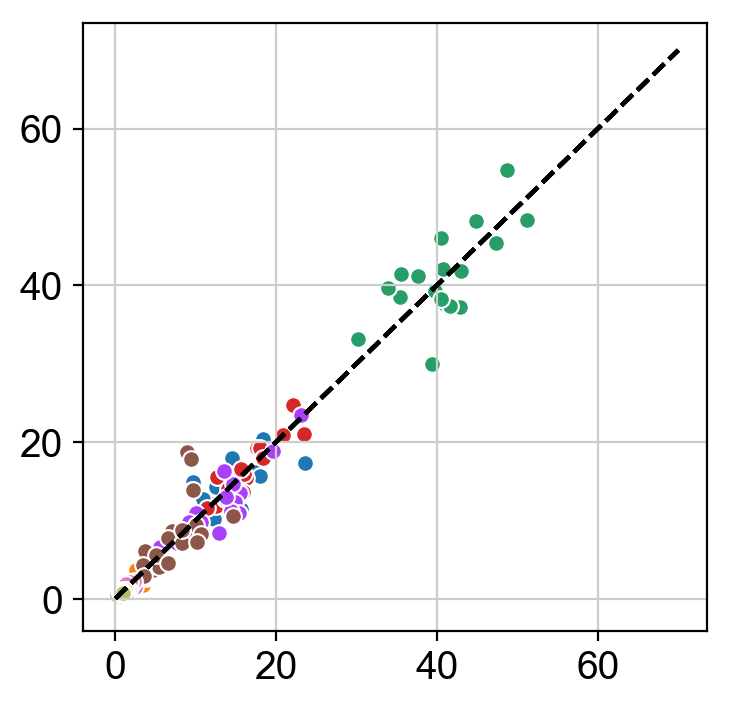

In [83]:
cors = pd.Series()
for ct in ["cM","ncM","Th","Tc","B","NK","cDC","pDC"] :
    ax = sns.scatterplot(ind_perc2_ucsf_rep1_pivot.loc[ct].values, ind_perc2_ucsf_rep2_pivot.loc[ct].values)
    cors[ct] = np.corrcoef(ind_perc2_ucsf_rep1_pivot.loc[ct].values,ind_perc2_ucsf_rep2_pivot.loc[ct].values)[0,1]
    ax.plot([0,70], [0,70], '--', color='#000000')
print(cors)

In [84]:
ind_perc2_ucsf_rep1_pivot

ind_cov,IGTB1290,IGTB141,IGTB143,IGTB1506,IGTB1539,IGTB1540,IGTB1575,IGTB1650,IGTB195,IGTB256,IGTB469,IGTB498,IGTB508,IGTB514,IGTB645,IGTB826,IGTB884,IGTB986
batch_cov,lupus8.23,lupus8.9,lupus7.26,lupus7.26,lupus8.16,lupus7.19,lupus8.16,lupus7.19,lupus7.20,lupus8.23,lupus8.3,lupus7.20,lupus8.3,lupus8.17,lupus8.17,lupus8.9,lupus8.2,lupus8.2
ct_cov,,,,,,,,,,,,,,,,,,
B,15.538392,14.890614,12.887344,15.343915,23.057486,13.645353,8.790170,9.966900,9.414062,14.647577,7.652355,10.609481,9.148936,14.325178,5.560382,19.657423,13.525836,13.707296
MK,2.544298,2.046577,2.780191,2.947846,2.526848,2.669743,2.788280,2.868702,3.281250,2.422907,2.562327,3.966462,3.120567,1.578532,2.953953,2.283850,3.191489,2.277520
NK,3.725579,4.728299,5.357660,10.052910,8.843967,10.580092,9.451796,14.600956,7.031250,6.534508,9.660665,5.030635,3.439716,6.511444,3.605560,8.319739,10.182371,8.308730
Progen,0.136302,NaN,0.144802,NaN,NaN,0.065920,NaN,NaN,NaN,NaN,0.069252,NaN,NaN,NaN,0.043440,NaN,NaN,0.042176
ProlifT,0.272603,0.282287,0.202722,0.377929,0.505370,0.263678,0.094518,0.147113,0.117188,0.146843,0.657895,0.257981,0.212766,0.078927,0.260643,0.081566,0.557244,0.168705
Tc,12.630622,17.642908,15.377932,18.291761,12.507896,19.611074,23.393195,17.984553,11.445312,16.299559,18.317175,16.027088,20.851064,22.138911,14.031277,15.660685,15.805471,14.213412
Th,41.026806,37.685251,48.711266,35.374150,42.893241,35.530653,39.413989,40.676719,51.210938,39.794420,41.620499,47.307320,40.425532,33.938437,44.874023,30.179445,40.526849,43.019823
cDC,2.180827,1.129146,1.766580,1.209373,2.463677,1.549110,1.181474,0.956234,1.015625,2.092511,1.488920,1.612383,1.134752,2.249408,1.824500,1.305057,1.671733,1.433994


mono      0.797573
lymph     0.862602
mk        0.163201
progen         NaN
cdc       0.493283
pdc       0.624500
dtype: float64


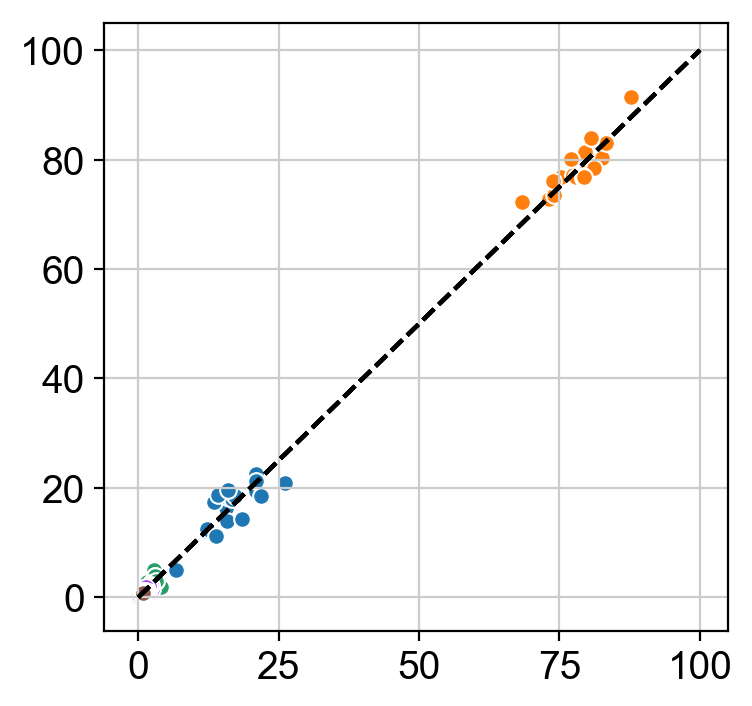

In [85]:
cors = pd.Series()
for ct in ["mono","lymph","mk","progen","cdc","pdc"] :
    ax=sns.scatterplot(ind_perc2_ucsf_rep1_cg_cov_pivot.loc[ct].values, ind_perc2_ucsf_rep2_cg_cov_pivot.loc[ct].values)
    cors[ct] = np.corrcoef(ind_perc2_ucsf_rep1_cg_cov_pivot.loc[ct].values,ind_perc2_ucsf_rep2_cg_cov_pivot.loc[ct].values)[0,1]
    ax.plot([0,100], [0,100], '--', color='#000000')
print(cors)

cM     0.266619
ncM   -0.110671
Th     0.118136
Tc     0.445291
B     -0.279766
NK     0.144465
cDC   -0.062747
pDC    0.238911
dtype: float64


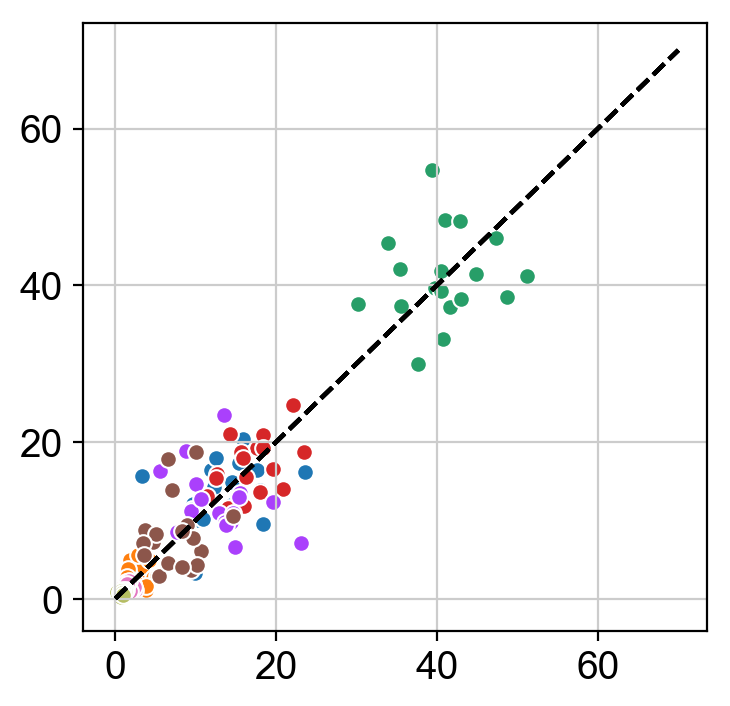

In [86]:
cors = pd.Series()
for ct in ["cM","ncM","Th","Tc","B","NK","cDC","pDC"] :
    shuffled = shuffle(ind_perc2_ucsf_rep2_pivot.loc[ct].values);
    ax = sns.scatterplot(ind_perc2_ucsf_rep1_pivot.loc[ct].values, shuffled)
    cors[ct] = np.corrcoef(ind_perc2_ucsf_rep1_pivot.loc[ct].values, shuffled)[0,1]
    ax.plot([0,70], [0,70], '--', color='#000000')
print(cors)

mono     -0.036176
lymph     0.299975
mk       -0.083878
progen         NaN
cdc       0.124969
pdc      -0.102074
dtype: float64


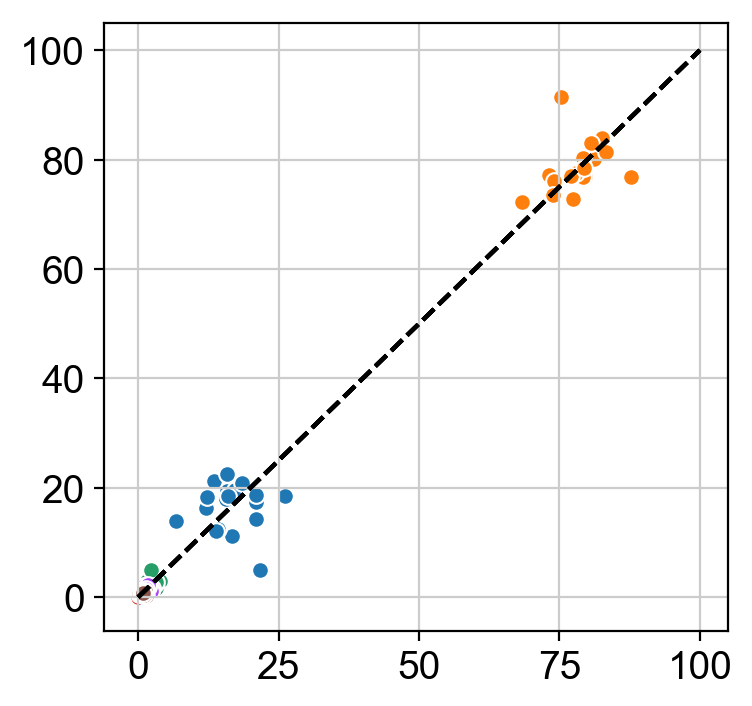

In [87]:
cors = pd.Series()
for ct in ["mono","lymph","mk","progen","cdc","pdc"] :
    shuffled = shuffle(ind_perc2_ucsf_rep2_cg_cov_pivot.loc[ct].values);
    ax = sns.scatterplot(ind_perc2_ucsf_rep1_cg_cov_pivot.loc[ct].values, shuffled)
    cors[ct] = np.corrcoef(ind_perc2_ucsf_rep1_cg_cov_pivot.loc[ct].values, shuffled)[0,1]
    ax.plot([0,100], [0,100], '--', color='#000000')
print(cors)

### looking at UCSF samples with Broad

In [88]:
ind_perc2_sorted = ind_perc2.sort_values(by=["ind_cov","batch_cov"],ascending=True)
ind_perc_all = ind_perc[ind_perc.disease_cov=="healthy"].append(ind_perc2_sorted[~ind_perc2_sorted.duplicated(["ct_cov","ind_cov"], keep="first")])

ind_perc_all_duplicated = ind_perc_all[ind_perc_all.duplicated(["ct_cov","ind_cov"], keep=False)]

ind_perc_all_rep1 = ind_perc_all_duplicated[ind_perc_all_duplicated.duplicated(["ct_cov","ind_cov"], keep="first")]
ind_perc_all_rep2 = ind_perc_all_duplicated[ind_perc_all_duplicated.duplicated(["ct_cov","ind_cov"], keep="last")]

ind_perc_all_rep1_pivot = ind_perc_all_rep1.pivot_table(index=["ct_cov"], columns=["ind_cov"], values="ct_perc")
ind_perc_all_rep1_cg_cov = ind_perc_all_rep1.groupby(["ind_cov","cg_cov"])["ct_perc"].sum()
ind_perc_all_rep1_cg_cov = ind_perc_all_rep1_cg_cov.reset_index(name="cg_perc")
ind_perc_all_rep1_cg_cov_pivot = ind_perc_all_rep1_cg_cov.pivot_table(index=["cg_cov"], columns=["ind_cov"], values="cg_perc")

ind_perc_all_rep2_pivot = ind_perc_all_rep2.pivot_table(index=["ct_cov"], columns=["ind_cov"], values="ct_perc")
ind_perc_all_rep2_cg_cov = ind_perc_all_rep2.groupby(["ind_cov","cg_cov"])["ct_perc"].sum()
ind_perc_all_rep2_cg_cov = ind_perc_all_rep2_cg_cov.reset_index(name="cg_perc")
ind_perc_all_rep2_cg_cov_pivot = ind_perc_all_rep2_cg_cov.pivot_table(index=["cg_cov"], columns=["ind_cov"], values="cg_perc")

print(ind_perc_all_rep1.shape)
print(ind_perc_all_rep2.shape)

(204, 8)
(204, 8)


In [89]:
ind_perc_all_rep1_pivot.shape

(11, 19)

cM     0.846355
ncM    0.885245
Th     0.905989
Tc     0.905644
B      0.954911
NK     0.859856
cDC    0.641224
pDC    0.466792
dtype: float64


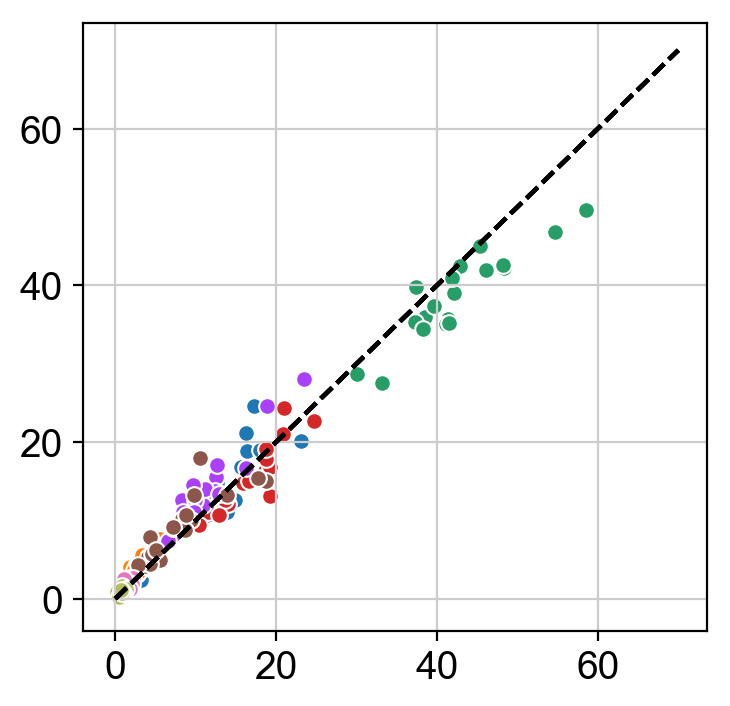

In [90]:
cors = pd.Series()
for ct in ["cM","ncM","Th","Tc","B","NK","cDC","pDC"] :
    ax = sns.scatterplot(ind_perc_all_rep1_pivot.loc[ct].values, ind_perc_all_rep2_pivot.loc[ct].values)
    cors[ct] = np.corrcoef(ind_perc_all_rep1_pivot.loc[ct].values, ind_perc_all_rep2_pivot.loc[ct].values)[0,1]
    ax.plot([0,70], [0,70], '--', color='#000000')
print(cors)

/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is sepa

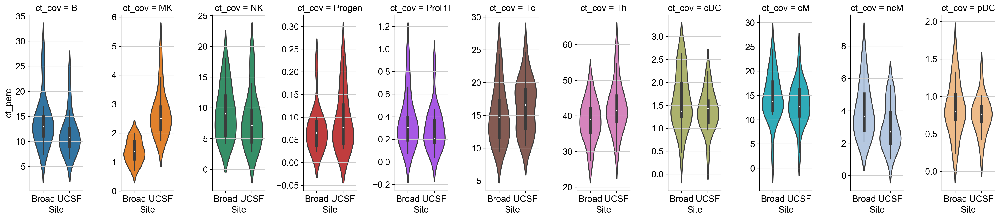

In [91]:
ind_perc_all_duplicated['Site'] = pd.Categorical(pd.Series(['Broad']).repeat(ind_perc_all_duplicated.shape[0]), categories=['Broad','UCSF'],ordered=True)
ind_perc_all_duplicated.Site[ind_perc_all_duplicated.batch_cov.str.contains("immvar")] = "Broad";
ind_perc_all_duplicated.Site[~ind_perc_all_duplicated.batch_cov.str.contains("immvar")] = "UCSF";

blah = sns.catplot(x='Site', y='ct_perc', hue='ct_cov', data=ind_perc_all_duplicated, kind='violin', col='ct_cov', dodge=False, aspect=0.4, sharex=False, sharey=False)

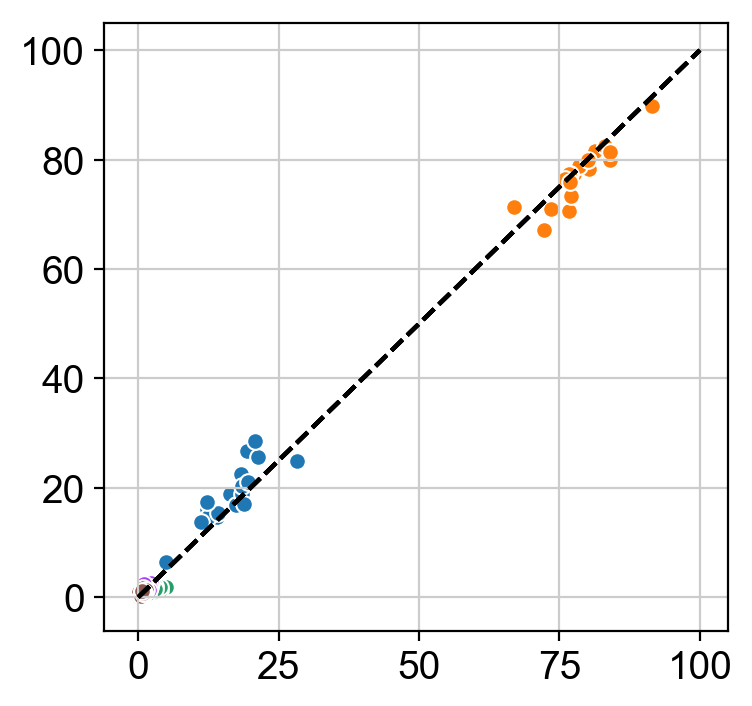

In [92]:
for ct in ["mono","lymph","mk","progen","cdc","pdc"] :
    ax = sns.scatterplot(ind_perc_all_rep1_cg_cov_pivot.loc[ct].values, ind_perc_all_rep2_cg_cov_pivot.loc[ct].values)
    ax.plot([0,100], [0,100], '--', color='#000000')

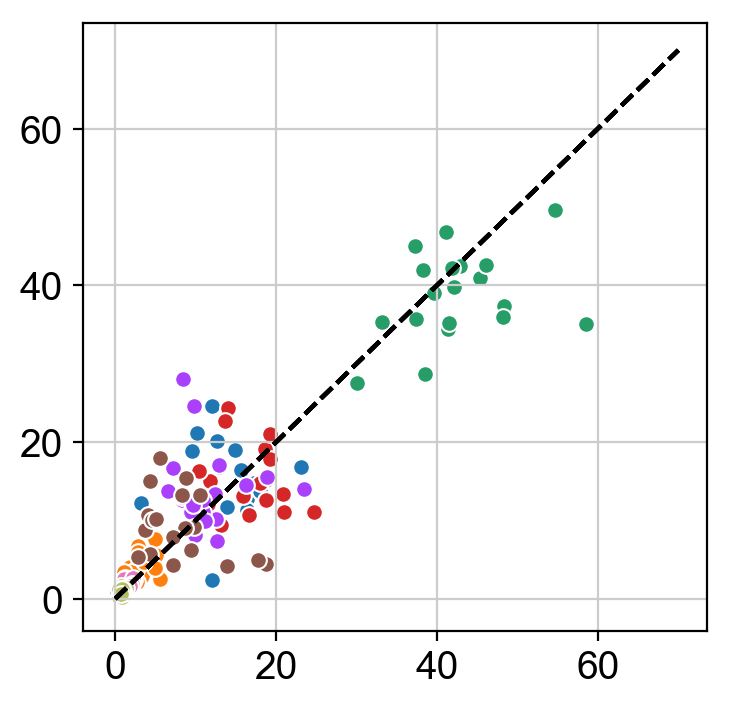

In [93]:
for ct in ["cM","ncM","Th","Tc","B","NK","cDC","pDC"] :
    ax = sns.scatterplot(ind_perc_all_rep1_pivot.loc[ct].values, shuffle(ind_perc_all_rep2_pivot.loc[ct].values))
    ax.plot([0,70], [0,70], '--', color='#000000')

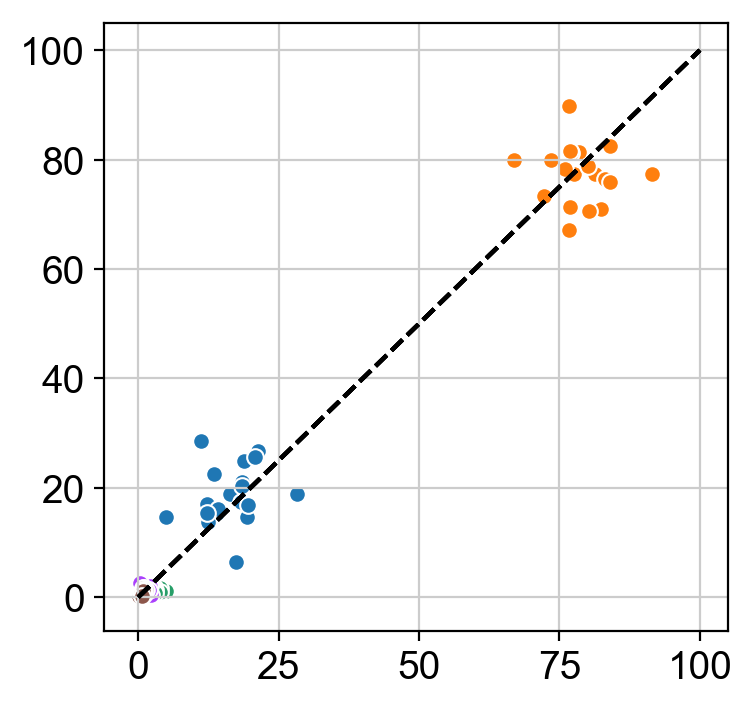

In [94]:
for ct in ["mono","lymph","mk","progen","cdc","pdc"] :
    ax = sns.scatterplot(ind_perc_all_rep1_cg_cov_pivot.loc[ct].values, shuffle(ind_perc_all_rep2_cg_cov_pivot.loc[ct].values))
    ax.plot([0,100], [0,100], '--', color='#000000')

## Cell proportion analysis using only the UCSF multiplexed samples

### here, we are going to use only one of the two replicates for analyses

In [95]:
## Make proportion plots (Fig. 1D)

##adata_obs_small = adata.obs[(adata.obs.study_cov=="ImmVar") & (adata.obs.ind_cov.str.contains("IGTB")) | (~adata.obs.ind_cov.str.contains("IGTB") & (adata.obs.study_cov=="CLUES"))]
##adata_obs_small = adata.obs[(adata.obs.well.str.contains("immvar")) & (adata.obs.ind_cov.str.contains("IGTB")) | (~adata.obs.ind_cov.str.contains("IGTB") & ~adata.obs.well.str.contains("immvar"))]
adata_obs_small = adata.obs[(adata.obs.batch_cov.str.contains("lupus"))]

##ind_count = adata_obs_small.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov','batch_cov'])['ct_cov'].count()

## no batch_cov so that we aggregate the count for the two healthy controls
ind_count = adata_obs_small.groupby(['ind_cov','ct_cov','disease_cov','pop_cov','batch_cov'])['ct_cov'].count()

##ind_count = adata.obs.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()
##ind_count = adata.obs.groupby(['ind_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()

##ind_count = ind_count.reset_index(name="counts")
ind_count_sums = ind_count.groupby(["ind_cov","batch_cov"]).sum()
ind_count_sums = ind_count_sums.reset_index(name="counts")

##ind_perc = ind_count/ind_count.groupby(["ind_cov","batch_cov"]).transform(sum)*100
ind_perc = ind_count/ind_count.groupby(["ind_cov","batch_cov"]).transform(sum)*100
ind_perc = ind_perc.reset_index(name="ct_perc")

## filter samples that have < 100 cells
ind_perc = ind_perc[ind_perc.ind_cov.isin(ind_count_sums.ind_cov[ind_count_sums.counts > 100])]


In [96]:
## for now, let's filter out one of the reps for the healthies
ind_perc = ind_perc.drop_duplicates(subset=['ct_cov','ind_cov'])
ind_count_sums = ind_count_sums.drop_duplicates(subset=['ind_cov'])
##ind_count = ind_count.drop_duplicates(subset=['ct_cov','ind_cov'])

In [97]:
##ct_group = pd.DataFrame( {'ct_cov':['B','CD14 Monoc','CD16 Monoc', 'CD4+ T', 'CD8+ T', 'MK', 'NK', 'cDC', 'pDC','Progenitor','Proliferat'], 'ct_group':['lymph', 'mono', 'mono', 'lymph','lymph', 'mkc','lymph','dc','pdc','progen','lymph']})
cg_cov = pd.DataFrame( {'ct_cov':['B','cM','ncM', 'Th', 'Tc', 'NK', 'ProlifT', 'cDC', 'pDC', 'MK', 'Progen'], 'cg_cov':['lymph', 'mono', 'mono', 'lymph','lymph', 'lymph', 'lymph', 'cdc','pdc', 'mk', 'progen']})
ind_perc.ind_cov = ind_perc.ind_cov.apply(lambda x: x.split('_')[0])
ind_count_sums.ind_cov = ind_count_sums.ind_cov.apply(lambda x: x.split('_')[0])
ind_perc = ind_perc.set_index('ct_cov').join(cg_cov.set_index('ct_cov'))
ind_perc.ind_cov = ind_perc.ind_cov.astype("str")
ind_perc.batch_cov = ind_perc.batch_cov.astype("str")
ind_perc.reset_index(inplace=True)
ind_perc.ct_cov = ind_perc.ct_cov.astype('category')
ind_perc.ct_cov = ind_perc.ct_cov.cat.reorder_categories(adata.obs.ct_cov.cat.categories.values)

print('as a proportion of total PBMC ')

for ct_i in list(range(11)) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = ind_perc.ct_perc[ind_perc.ct_cov==ct]
    disease = ind_perc.disease_cov[ind_perc.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    print('Cell type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), disease.astype(float))
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    print('Beta='+str(effect)+', pvalue='+str(pval))
    
    
    
print('\nwhite sle vs white healthy')

for ct_i in list(range(11)) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = ind_perc[ind_perc.pop_cov=="WHITE"].ct_perc[ind_perc.ct_cov==ct]
    disease = ind_perc[ind_perc.pop_cov=="WHITE"].disease_cov[ind_perc.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    print('Cell type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), disease.astype(float))
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    print('Beta='+str(effect)+', pvalue='+str(pval))
    
    
print('\nasian sle vs white healthy')

for ct_i in list(range(11)) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = ind_perc[((ind_perc.pop_cov=="WHITE") & (ind_perc.disease_cov=="healthy")) | ((ind_perc.pop_cov=="ASIAN") & (ind_perc.disease_cov=="sle"))].ct_perc[ind_perc.ct_cov==ct]
    disease = ind_perc[((ind_perc.pop_cov=="WHITE") & (ind_perc.disease_cov=="healthy")) | ((ind_perc.pop_cov=="ASIAN") & (ind_perc.disease_cov=="sle"))].disease_cov[ind_perc.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    print('Cell type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), disease.astype(float))
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    print('Beta='+str(effect)+', pvalue='+str(pval))
    
    
print('\nwhite sle vs asian sle')

for ct_i in list(range(11)) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = ind_perc[ind_perc.disease_cov=="sle"].ct_perc[ind_perc.ct_cov==ct]
    pop = ind_perc[ind_perc.disease_cov=="sle"].pop_cov[ind_perc.ct_cov==ct]
    pop = pop.astype("str")
    pop.values[pop=="ASIAN"] = 0
    pop.values[pop=="WHITE"] = 1
    pop = sm.add_constant(pop)
    ##data = data.assign(ct_perc=ct_perc)
    print('Cell type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), pop.astype(float))
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    print('Beta='+str(effect)+', pvalue='+str(pval))

as a proportion of total PBMC 
Cell type:B
Beta=-1.155138702298159, pvalue=0.5582425960533384
Cell type:MK
Beta=1.1935519186422097, pvalue=5.880541867421472e-12
Cell type:NK
Beta=0.5757135621235714, pvalue=0.5679328331445556
Cell type:Progen
Beta=-0.00020528544200966448, pvalue=0.9893946719366653
Cell type:ProlifT
Beta=-0.2560405794084114, pvalue=0.00947682319806923
Cell type:Tc
Beta=-2.8404269045026607, pvalue=0.16125986559932684
Cell type:Th
Beta=18.72481584652529, pvalue=9.647495442479087e-15
Cell type:cDC
Beta=0.15630530914019305, pvalue=0.32994612937540957
Cell type:cM
Beta=-14.680359404397592, pvalue=8.736576569138482e-09
Cell type:ncM
Beta=-2.1512108532370653, pvalue=0.0007932422308527028
Cell type:pDC
Beta=0.4478022746799711, pvalue=3.2473638024831993e-15

white sle vs white healthy
Cell type:B
Beta=1.4903226560115939, pvalue=0.373683252836466
Cell type:MK
Beta=1.0492708754239066, pvalue=3.679371401969749e-07
Cell type:NK
Beta=-0.40373840389245774, pvalue=0.72555639831966
Cell 

## Next, let's plot the proportions

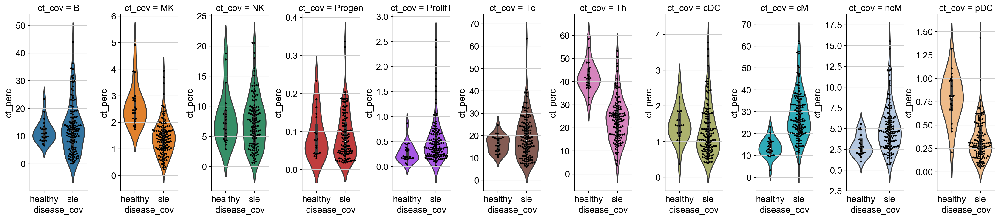

In [98]:
perc_plot = sns.catplot(x='disease_cov', y='ct_perc', hue='ct_cov', data=ind_perc, kind='violin', col='ct_cov', dodge=False, aspect=0.4, sharex=False, sharey=False)

for ct_i in list(range(len(ind_perc.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    sns.swarmplot(x="disease_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color="0", size=3, ax=perc_plot.axes[0,ct_i])

perc_plot.savefig(figdir+"/violin.ct_cov.png")
#fig,ax = plt.subplots(nrows=1,ncols=10, figsize=(20,5))
#fig.tight_layout()

##for ct_i in list(range(10)) :
##    ct = ind_perc.ct_cov.cat.categories[ct_i]
##    sns.boxplot(x="disease_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color=sc.pl.palettes.vega_20_scanpy[ct_i], ax=ax[ct_i])
##    sns.swarmplot(x="disease_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color="0", size=3, ax=ax[ct_i])

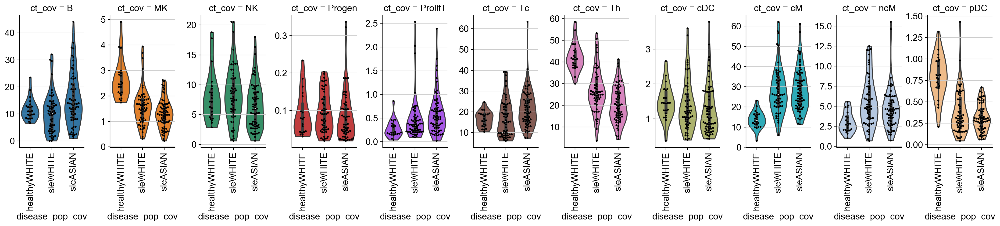

In [99]:
ind_perc['disease_pop_cov'] = pd.Categorical(ind_perc.apply(lambda row: row['disease_cov'] + row['pop_cov'], axis=1),
                                             categories=['healthyWHITE','sleWHITE','sleASIAN'],
                                             ordered=True)
perc_plot = sns.catplot(x='disease_pop_cov', y='ct_perc', hue='ct_cov', data=ind_perc, kind='violin', col='ct_cov', aspect=0.5, height=4, 
                        dodge=False, sharex=False, sharey=False, cut=0)
perc_plot.set_xticklabels(rotation=90)
perc_plot.fig.subplots_adjust(wspace=0.4)
##perc_plot.tight_layout()

for ct_i in list(range(len(ind_perc.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    sns.swarmplot(x="disease_pop_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color="0", size=3, ax=perc_plot.axes[0,ct_i])
    perc_plot.axes[0,ct_i].get_yaxis().label.set_visible(False)


perc_plot.savefig(figdir+"/violin.ct_cov_pop.png")

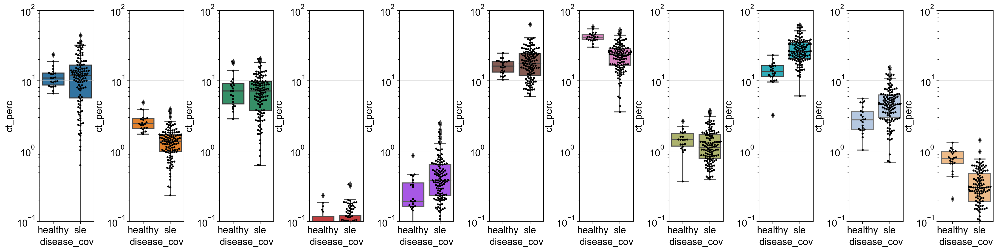

In [100]:
fig,ax = plt.subplots(nrows=1,ncols=11, figsize=(20,5))
fig.tight_layout()


for ct_i in list(range(11)) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ax[ct_i].set_yscale('log')
    ax[ct_i].set_ylim(0.1,100)
    sns.boxplot(x="disease_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color=sc.pl.palettes.vega_20_scanpy[ct_i], ax=ax[ct_i])
    sns.swarmplot(x="disease_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color="0", size=3, ax=ax[ct_i])

In [101]:
##ax = sns.catplot(x='disease_cov', y='ct_perc', hue='ct_cov', data=ind_perc, kind='box', col='ct_cov', height=8, aspect=1/4)
##ax.savefig("figures/boxplot.cat.png")

## Cell proportion analysis using all ImmVar samples

In [102]:
## Make proportion plots (Fig. 1D)

##adata_obs_small = adata.obs[(adata.obs.study_cov=="ImmVar") & (adata.obs.ind_cov.str.contains("IGTB")) | (~adata.obs.ind_cov.str.contains("IGTB") & (adata.obs.study_cov=="CLUES"))]
##adata_obs_small = adata.obs[(adata.obs.well.str.contains("immvar")) & (adata.obs.ind_cov.str.contains("IGTB")) | (~adata.obs.ind_cov.str.contains("IGTB") & ~adata.obs.well.str.contains("immvar"))]
adata_obs_small = adata.obs;##[(adata.obs.batch_cov.str.contains("lupus"))]

##ind_count = adata_obs_small.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov','batch_cov'])['ct_cov'].count()

## no batch_cov so that we aggregate the count for the two healthy controls
ind_count = adata_obs_small.groupby(['ind_cov','ct_cov','disease_cov','pop_cov','batch_cov'])['ct_cov'].count()

##ind_count = adata.obs.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()
##ind_count = adata.obs.groupby(['ind_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()

##ind_count = ind_count.reset_index(name="counts")
ind_count_sums = ind_count.groupby(["ind_cov","batch_cov"]).sum()
ind_count_sums = ind_count_sums.reset_index(name="counts")

##ind_perc = ind_count/ind_count.groupby(["ind_cov","batch_cov"]).transform(sum)*100
ind_perc = ind_count/ind_count.groupby(["ind_cov","batch_cov"]).transform(sum)*100
ind_perc = ind_perc.reset_index(name="ct_perc")

## filter samples that have < 100 cells
ind_perc = ind_perc[ind_perc.ind_cov.isin(ind_count_sums.ind_cov[ind_count_sums.counts > 100])]


In [103]:
print(ind_perc.shape)
print(ind_count_sums.shape)

## for now, let's filter out one of the reps for the healthies from UCSF only
ind_perc_broad = ind_perc[~ind_perc.batch_cov.str.contains("lupus")]
ind_perc_ucsf = ind_perc[ind_perc.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ct_cov','ind_cov'])
ind_perc = ind_perc_ucsf.append(ind_perc_broad);

ind_count_sums_broad = ind_count_sums[~ind_count_sums.batch_cov.str.contains("lupus")]
ind_count_sums_ucsf = ind_count_sums[ind_count_sums.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ind_cov'])
ind_count_sums = ind_count_sums_ucsf.append(ind_count_sums_broad);

print(ind_perc.shape)
print(ind_count_sums.shape)

##ind_count = ind_count.drop_duplicates(subset=['ct_cov','ind_cov'])

(2221, 6)
(206, 3)
(2035, 6)
(188, 3)


In [104]:
cg_cov = pd.DataFrame( {'ct_cov':['B','cM','ncM', 'Th', 'Tc', 'NK', 'ProlifT', 'cDC', 'pDC', 'MK', 'Progen'], 'cg_cov':['lymph', 'mono', 'mono', 'lymph','lymph', 'lymph', 'lymph', 'dc','dc', 'mk', 'progen']})
ind_perc.ind_cov = ind_perc.ind_cov.apply(lambda x: x.split('_')[0])
ind_count_sums.ind_cov = ind_count_sums.ind_cov.apply(lambda x: x.split('_')[0])
ind_perc = ind_perc.set_index('ct_cov').join(cg_cov.set_index('ct_cov'))
ind_perc.ind_cov = ind_perc.ind_cov.astype("str")
ind_perc.batch_cov = ind_perc.batch_cov.astype("str")
ind_perc.reset_index(inplace=True)
ind_perc.ct_cov = ind_perc.ct_cov.astype('category')
ind_perc.ct_cov = ind_perc.ct_cov.cat.reorder_categories(adata.obs.ct_cov.cat.categories.values)
## do this to get monos and lympho to have similar colors as the major cell types
ind_perc.cg_cov = ind_perc.cg_cov.astype('category')
ind_perc.cg_cov = ind_perc.cg_cov.cat.reorder_categories(["mono", "dc", "mk", "progen","lymph"])

print('as a proportion of total PBMC ')

for ct_i in list(range(11)) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = ind_perc.ct_perc[ind_perc.ct_cov==ct]
    disease = ind_perc.disease_cov[ind_perc.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    print('Cell type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), disease.astype(float))
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    print('Beta='+str(effect)+', pvalue='+str(pval))
    
    
    
print('\nwhite sle vs white healthy')

for ct_i in list(range(11)) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = ind_perc[ind_perc.pop_cov=="WHITE"].ct_perc[ind_perc.ct_cov==ct]
    disease = ind_perc[ind_perc.pop_cov=="WHITE"].disease_cov[ind_perc.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    print('Cell type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), disease.astype(float))
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    print('Beta='+str(effect)+', pvalue='+str(pval))
    
    
print('\nasian sle vs white healthy')

for ct_i in list(range(11)) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = ind_perc[((ind_perc.pop_cov=="WHITE") & (ind_perc.disease_cov=="healthy")) | ((ind_perc.pop_cov=="ASIAN") & (ind_perc.disease_cov=="sle"))].ct_perc[ind_perc.ct_cov==ct]
    disease = ind_perc[((ind_perc.pop_cov=="WHITE") & (ind_perc.disease_cov=="healthy")) | ((ind_perc.pop_cov=="ASIAN") & (ind_perc.disease_cov=="sle"))].disease_cov[ind_perc.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    print('Cell type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), disease.astype(float))
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    print('Beta='+str(effect)+', pvalue='+str(pval))
    
    
print('\nwhite sle vs asian sle')

for ct_i in list(range(11)) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = ind_perc[ind_perc.disease_cov=="sle"].ct_perc[ind_perc.ct_cov==ct]
    pop = ind_perc[ind_perc.disease_cov=="sle"].pop_cov[ind_perc.ct_cov==ct]
    pop = pop.astype("str")
    pop.values[pop=="ASIAN"] = 0
    pop.values[pop=="WHITE"] = 1
    pop = sm.add_constant(pop)
    ##data = data.assign(ct_perc=ct_perc)
    print('Cell type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), pop.astype(float))
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    print('Beta='+str(effect)+', pvalue='+str(pval))

as a proportion of total PBMC 
Cell type:B
Beta=0.25803274146974814, pvalue=0.8261994039235107
Cell type:MK
Beta=0.1712709400831908, pvalue=0.1347986510948563
Cell type:NK
Beta=0.9222182750048022, pvalue=0.15045156094979073
Cell type:Progen
Beta=-0.009819554751986037, pvalue=0.31494701574097195
Cell type:ProlifT
Beta=-0.23502499318668119, pvalue=5.27543811105561e-05
Cell type:Tc
Beta=-3.298672061786421, pvalue=0.00578207482776324
Cell type:Th
Beta=15.032139831400281, pvalue=1.0362920442541677e-22
Cell type:cDC
Beta=0.18543743401225643, pvalue=0.06086731702722329
Cell type:cM
Beta=-11.96149978214569, pvalue=1.5975651686805007e-14
Cell type:ncM
Beta=-1.5764319872037118, pvalue=3.791836810240907e-05
Cell type:pDC
Beta=0.5181420085581143, pvalue=3.285826383777878e-26

white sle vs white healthy
Cell type:B
Beta=2.9034940997794942, pvalue=0.008761230057635004
Cell type:MK
Beta=0.026989896864887373, pvalue=0.8556531947816901
Cell type:NK
Beta=-0.05723369101123166, pvalue=0.9412008281158715
C

## Next, let's plot the proportions

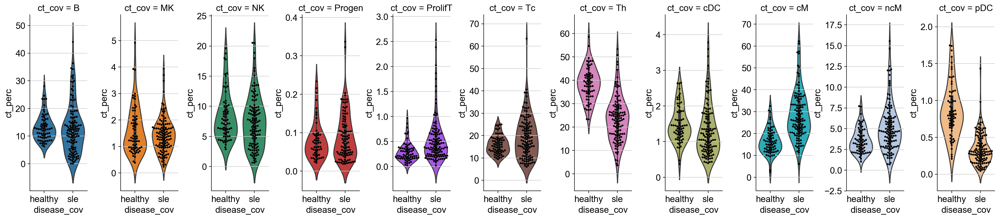

In [105]:
perc_plot = sns.catplot(x='disease_cov', y='ct_perc', hue='ct_cov', data=ind_perc, kind='violin', col='ct_cov', dodge=False, aspect=0.4, sharex=False, sharey=False)

for ct_i in list(range(len(ind_perc.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    sns.swarmplot(x="disease_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color="0", size=3, ax=perc_plot.axes[0,ct_i])

perc_plot.savefig(figdir+"/violin.ct_cov.png")
#fig,ax = plt.subplots(nrows=1,ncols=10, figsize=(20,5))
#fig.tight_layout()

##for ct_i in list(range(10)) :
##    ct = ind_perc.ct_cov.cat.categories[ct_i]
##    sns.boxplot(x="disease_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color=sc.pl.palettes.vega_20_scanpy[ct_i], ax=ax[ct_i])
##    sns.swarmplot(x="disease_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color="0", size=3, ax=ax[ct_i])

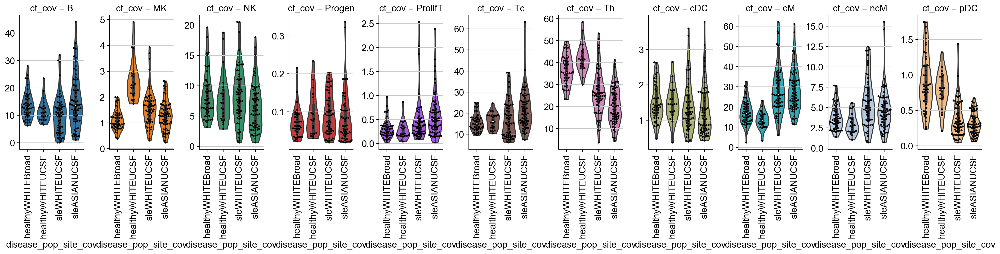

In [106]:
ind_perc['site'] = pd.Categorical(ind_perc.disease_cov, categories=['Broad','UCSF'])
ind_perc.site[ind_perc.batch_cov.str.contains("immvar")] = "Broad"
ind_perc.site[~ind_perc.batch_cov.str.contains("immvar")] = "UCSF"

ind_perc['disease_pop_cov'] = pd.Categorical(ind_perc.apply(lambda row: row['disease_cov'] + row['pop_cov'], axis=1),
                                             categories=['healthyWHITE','sleWHITE','sleASIAN'],
                                             ordered=True)

ind_perc['disease_pop_site_cov'] = pd.Categorical(ind_perc.apply(lambda row: row['disease_cov'] + row['pop_cov'] + row['site'], axis=1),
                                             categories=['healthyWHITEBroad','healthyWHITEUCSF','sleWHITEUCSF','sleASIANUCSF'],
                                             ordered=True)
perc_plot = sns.catplot(x='disease_pop_site_cov', y='ct_perc', hue='ct_cov', data=ind_perc, kind='violin', col='ct_cov', aspect=0.5, height=4, 
                        dodge=False, sharex=False, sharey=False, cut=0)
perc_plot.set_xticklabels(rotation=90)
perc_plot.fig.subplots_adjust(wspace=0.4)
##perc_plot.tight_layout()

for ct_i in list(range(len(ind_perc.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    sns.swarmplot(x="disease_pop_site_cov", y="ct_perc", data=ind_perc[ind_perc.ct_cov == ct], color="0", size=3, ax=perc_plot.axes[0,ct_i])
    perc_plot.axes[0,ct_i].get_yaxis().label.set_visible(False)


perc_plot.savefig(figdir+"/violin.ct_cov_pop_site.png")




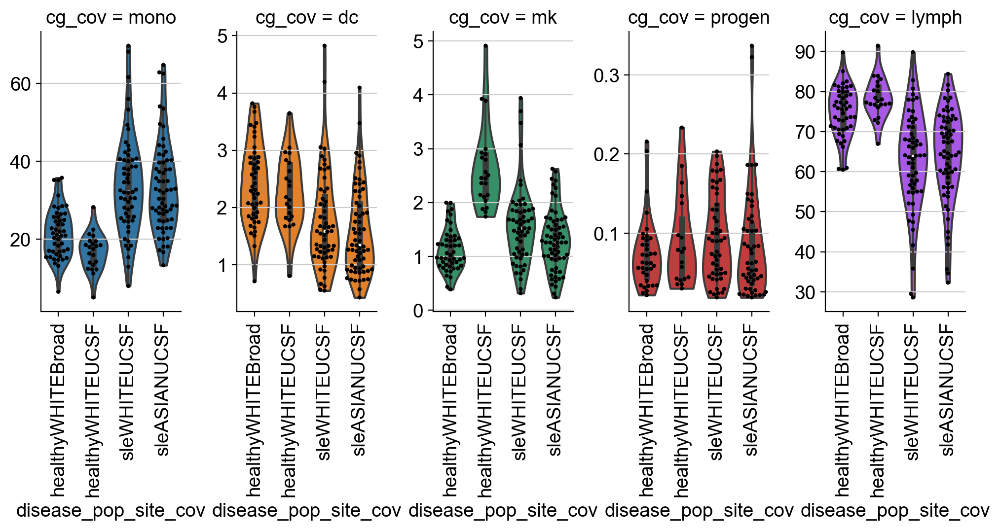

In [107]:
ind_group = ind_perc.groupby(['ind_cov','cg_cov','disease_cov','pop_cov','batch_cov','disease_pop_site_cov'])['ct_perc'].sum()
ind_group = ind_group.reset_index(name="cg_perc")
##ind_group.cg_cov = ind_group.cg_cov.astype('category')

group_plot = sns.catplot(x='disease_pop_site_cov', y='cg_perc', hue='cg_cov', data=ind_group, kind='violin', col='cg_cov', aspect=0.55, height=4, 
                        dodge=False, sharex=False, sharey=False, cut=0)
group_plot.set_xticklabels(rotation=90)
group_plot.fig.subplots_adjust(wspace=0.4)
##perc_plot.tight_layout()

for cg_i in list(range(len(ind_group.cg_cov.cat.categories))) :
    cg = ind_group.cg_cov.cat.categories[cg_i]
    sns.swarmplot(x="disease_pop_site_cov", y="cg_perc", data=ind_group[ind_group.cg_cov == cg], color="0", size=3, ax=group_plot.axes[0,cg_i])
    group_plot.axes[0,cg_i].get_yaxis().label.set_visible(False)

group_plot.savefig(figdir+"/violin.cg_cov_pop_site.png")

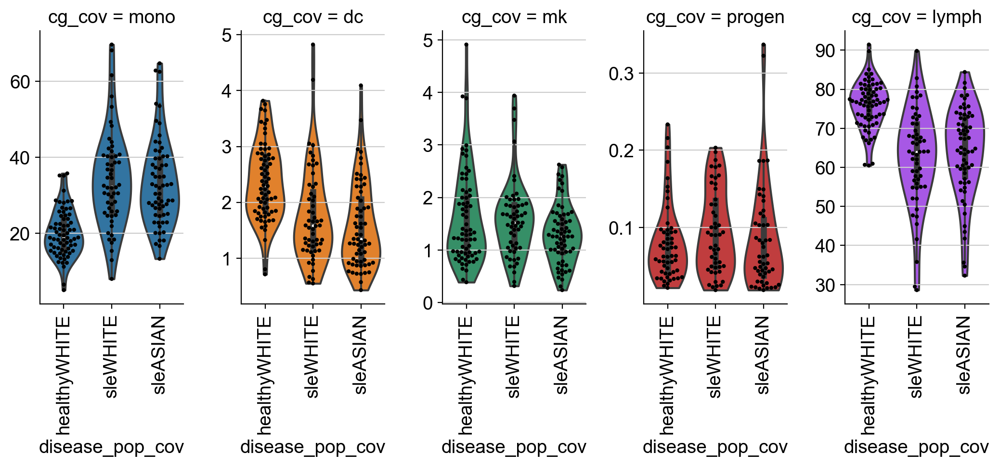

In [108]:
ind_group = ind_perc.groupby(['ind_cov','cg_cov','disease_cov','pop_cov','batch_cov','disease_pop_cov'])['ct_perc'].sum()
ind_group = ind_group.reset_index(name="cg_perc")
##ind_group.cg_cov = ind_group.cg_cov.astype('category')

group_plot = sns.catplot(x='disease_pop_cov', y='cg_perc', hue='cg_cov', data=ind_group, kind='violin', col='cg_cov', aspect=0.55, height=4, 
                        dodge=False, sharex=False, sharey=False, cut=0)
group_plot.set_xticklabels(rotation=90)
group_plot.fig.subplots_adjust(wspace=0.4)
##perc_plot.tight_layout()

for cg_i in list(range(len(ind_group.cg_cov.cat.categories))) :
    cg = ind_group.cg_cov.cat.categories[cg_i]
    sns.swarmplot(x="disease_pop_cov", y="cg_perc", data=ind_group[ind_group.cg_cov == cg], color="0", size=3, ax=group_plot.axes[0,cg_i])
    group_plot.axes[0,cg_i].get_yaxis().label.set_visible(False)

group_plot.savefig(figdir+"/violin.cg_cov_pop.png")

## leiden proportion analysis

In [109]:
# adata.obs.ct_cov = adata.obs.ct_cov.astype("str")
# # ## do some manual cell type assignment
# adata.obs.ct_cov.loc[adata.obs.leiden == "0"] = "B" ## good                                                                                    
# adata.obs.ct_cov.loc[adata.obs.leiden == "1"] = "Tc" ## good                                                                                    
# adata.obs.ct_cov.loc[adata.obs.leiden == "2"] = "NK" ## good                                                                                     
# adata.obs.ct_cov.loc[adata.obs.leiden == "3"] = "Tc" ## good                                                                                    
# adata.obs.ct_cov.loc[adata.obs.leiden == "4"] = "Tc" ## good                                                                                    
# adata.obs.ct_cov.loc[adata.obs.leiden == "5"] = "Th" ## good                                                                                    
# adata.obs.ct_cov.loc[adata.obs.leiden == "6"] = "cM" ## good                                                                                    
# adata.obs.ct_cov.loc[adata.obs.leiden == "7"] = "cM" ## good                                                                                    
# adata.obs.ct_cov.loc[adata.obs.leiden == "8"] = "Th" ## good                                                                                    
# adata.obs.ct_cov.loc[adata.obs.leiden == "9"] = "cM" ## good                                                                                    
# adata.obs.ct_cov.loc[adata.obs.leiden == "10"] = "Tc" ## good                                                                                  
# adata.obs.ct_cov.loc[adata.obs.leiden == "11"] = "ncM" ## good                                                                                    
# adata.obs.ct_cov.loc[adata.obs.leiden == "12"] = "B" ## good                                                                                   
# adata.obs.ct_cov.loc[adata.obs.leiden == "13"] = "cM" ## good                                                                                   
# adata.obs.ct_cov.loc[adata.obs.leiden == "14"] = "Th" ## good                                                                                  
# adata.obs.ct_cov.loc[adata.obs.leiden == "15"] = "Tc" ## good                                                                                   
# adata.obs.ct_cov.loc[adata.obs.leiden == "16"] = "Th" ## good                                                                                   
# adata.obs.ct_cov.loc[adata.obs.leiden == "17"] = "cM" ## good                                                                                  
# adata.obs.ct_cov.loc[adata.obs.leiden == "18"] = "cM" ## good                                                                              
# adata.obs.ct_cov.loc[adata.obs.leiden == "19"] = "Th" ## good                                                                               
# adata.obs.ct_cov.loc[adata.obs.leiden == "20"] = "cM" ## good                                                                                   
# adata.obs.ct_cov.loc[adata.obs.leiden == "21"] = "Tc" ## doublets or IFN activated T?                                                            
# adata.obs.ct_cov.loc[adata.obs.leiden == "22"] = "Th" ## good                                                                                   
# adata.obs.ct_cov.loc[adata.obs.leiden == "23"] = "DB" ## good                                                                                    
# adata.obs.ct_cov.loc[adata.obs.leiden == "24"] = "cDC" ## good                                                                                    
# adata.obs.ct_cov.loc[adata.obs.leiden == "25"] = "Th" ## good
# adata.obs.ct_cov.loc[adata.obs.leiden == "26"] = "B" ## good
# adata.obs.ct_cov.loc[adata.obs.leiden == "27"] = "ncM" ## good
# adata.obs.ct_cov.loc[adata.obs.leiden == "28"] = "NK" ## good
# adata.obs.ct_cov.loc[adata.obs.leiden == "29"] = "DB" ## good
# adata.obs.ct_cov.loc[adata.obs.leiden == "30"] = "DB" ## good
# adata.obs.ct_cov.loc[adata.obs.leiden == "31"] = "DB" ## good
# adata.obs.ct_cov.loc[adata.obs.leiden == "32"] = "pDC" ## good
# adata.obs.ct_cov.loc[adata.obs.leiden == "33"] = "Progen" ## good
# adata.obs.ct_cov.loc[adata.obs.leiden == "34"] = "ProlifT" ## good
# adata.obs.ct_cov.loc[adata.obs.leiden == "35"] = "MK" ## good
# adata.obs.ct_cov.loc[adata.obs.leiden == "36"] = "ProlifT" ## good
# adata.obs.ct_cov.loc[adata.obs.leiden == "37"] = "B" ## good
# adata.obs.ct_cov.loc[adata.obs.leiden == "38"] = "DB" ## good
# adata.obs.ct_cov.loc[adata.obs.leiden == "39"] = "MK" ## good
# adata.obs.ct_cov.loc[adata.obs.leiden == "40"] = "DB" ## good
# adata.obs.ct_cov.loc[adata.obs.leiden == "41"] = "DB" ## good
# adata.obs.ct_cov.loc[adata.obs.leiden == "42"] = "DB" ## good
# adata.obs.ct_cov.loc[adata.obs.leiden == "43"] = "DB" ## good
# adata.obs.ct_cov.loc[adata.obs.leiden == "44"] = "B" ## good



# adata.obs.ct_cov = adata.obs.ct_cov.astype('category')

In [110]:
# ct_counts=adata_obs_small.groupby(['ind_cov', 'pop_cov', 'disease_cov', 'batch_cov', 'leiden'])['leiden'].count()

# ##ind_count = ind_count.reset_index(name="counts")
# ct_counts_sums = ct_counts.groupby(["ind_cov","batch_cov"]).sum()
# ct_counts_sums = ct_counts_sums.reset_index(name="counts")

# ct_percs = ct_counts/ct_counts.groupby(["ind_cov","batch_cov"]).transform(sum)*100
# ct_percs = ct_percs.reset_index(name='ct_percs')

# ct_percs.ind_cov = ct_percs.ind_cov.apply(lambda x: x.split('_')[0])
# ct_percs.ind_cov = ct_percs.ind_cov.astype("str")
# ct_percs.reset_index(inplace=True)
# ct_percs.leiden = ct_percs.leiden.astype("category")
# ct_df=ct_percs.unstack(level=2, fill_value=0)

# ct_percs['site'] = pd.Categorical(ct_percs.disease_cov, categories=['Broad','UCSF'])
# ct_percs.site[ct_percs.batch_cov.str.contains("immvar")] = "Broad"
# ct_percs.site[~ct_percs.batch_cov.str.contains("immvar")] = "UCSF"

# ct_percs['disease_pop_cov'] = pd.Categorical(ct_percs.apply(lambda row: row['disease_cov'] + row['pop_cov'], axis=1),
#                                              categories=['healthyWHITE','sleWHITE','sleASIAN'],
#                                              ordered=True)

# ct_percs['disease_pop_site_cov'] = pd.Categorical(ct_percs.apply(lambda row: row['disease_cov'] + row['pop_cov'] + row['site'], axis=1),
#                                              categories=['healthyWHITEBroad','healthyWHITEUCSF','sleWHITEUCSF','sleASIANUCSF'],
#                                              ordered=True)


# ##plt.figure(figsize=(20,8))
# plot=sns.catplot(x='disease_pop_site_cov', y='ct_percs', hue='leiden', data=ct_percs, kind='violin', col='leiden', 
#                  dodge=False, aspect=0.5, height=4, sharex=False, sharey=False, palette=adata.uns['leiden_colors'], cut=0, col_wrap=10) #, palette=sc.pl.palettes.vega_20_scanpy
# plot.set_xticklabels(rotation=90)
# plot.fig.subplots_adjust(wspace=0.4)

# # for ct_i in list(range(len(ct_percs.leiden.cat.categories))) :
# #     ct = ct_percs.leiden.cat.categories[ct_i]
# #     sns.swarmplot(x="disease_pop_site_cov", y="ct_percs", data=ct_percs[ct_percs.leiden == ct], color="0", size=3, ax=plot.axes[ct_i//10,ct_i%10])
# #     plot.axes[0,ct_i].get_yaxis().label.set_visible(False)

# #plot.savefig(figdir+"/violin.cd4_pop.png")
# #plt.subplots_adjust(wspace=0.03)

# Figure 1E: Correlation with EHR

## Some initial data wrangling

ok, there should be 127 lupus patients and 42 immvar donors, we only have estimated PBMC numbers for 11 of them so the final joined table will only have 

In [69]:
## Let's grab the clinical and labs data and compare to our single cell estimates
clues_clinical = pd.read_csv("v2.clinical.data.txt", index_col=False, sep="\t")
clues_clinical.genotypeid = clues_clinical.genotypeid.apply(lambda x: x.split('_')[0])
clues_clinical.subjectid = clues_clinical.subjectid.astype("str")
joined = ind_perc.join(ind_count_sums.set_index(['ind_cov','batch_cov']), on=['ind_cov','batch_cov']);
joined = joined.join(clues_clinical.set_index('genotypeid'), on='ind_cov')
##joined = ind_perc.join(clues_clinical.set_index('genotypeid'), on='ind_cov')

t1_labs = pd.read_csv("T1labs.csv",sep=",")
t1_labs.SubjectID = t1_labs.SubjectID.astype("str")
joined = joined.join(t1_labs.set_index('SubjectID'), on='subjectid')

### test new code
joined.AbsBaso = joined.AbsBaso/1000
joined.AbsEosino = joined.AbsEosino/1000
joined.AbsLympho = joined.AbsLympho/1000
joined.AbsNeutro = joined.AbsNeutro/1000
joined.AbsMono = joined.AbsMono/1000

joined = joined.assign(pbmc = joined.WhiteBloodCell-joined.AbsNeutro-joined.AbsEosino-joined.AbsBaso)

##joined[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']] = joined[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']].astype(str)

## now let's add in white blood cell counts for the immvar patients
immvar_pbmc = pd.read_csv("immvar.pbmc.csv", index_col=False, sep=",")
immvar_pbmc.pbmc = immvar_pbmc.pbmc - (np.mean(immvar_pbmc.pbmc) - np.mean(joined.pbmc))
## this is not the most efficient code but will suffice for now
for i in list(range(12)) :
    igtb = immvar_pbmc.immvarid[i]
    joined.pbmc[joined.ind_cov==igtb] = immvar_pbmc.pbmc[i]

joined.pbmc = joined.pbmc.fillna(0)
joined = joined.assign(estimate=joined.ct_perc/100*joined.pbmc)

joined['disease_pop_cov'] = joined.apply(lambda row: row['disease_cov'] + row['pop_cov'], axis=1)
joined[["ind_cov","disease_cov","ct_cov","disease_pop_cov"]] = joined[["ind_cov","disease_cov","ct_cov","disease_pop_cov"]].astype('str')
joined.plaquenilnow = joined.plaquenilnow.fillna(0)
joined.cellceptnow = joined.cellceptnow.fillna(0)
joined.steroralnow = joined.steroralnow.fillna(0)
joined.acrlymphopenia = joined.acrlymphopenia.fillna(0)
joined.sledaiscore = joined.sledaiscore.fillna(0)
joined.WhiteBloodCell = joined.WhiteBloodCell.fillna(0)
joined.AbsMono = joined.AbsMono.fillna(0)
joined.AbsLympho = joined.AbsLympho.fillna(0)
joined.AbsNeutro = joined.AbsNeutro.fillna(0)
joined.AbsEosino = joined.AbsEosino.fillna(0)
joined.AbsBaso = joined.AbsBaso.fillna(0)
joined.PlatCount = joined.PlatCount.fillna(0)
joined.pbmc = joined.pbmc.fillna(0)
joined.subjectid = joined.subjectid.fillna(0)



/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [70]:
indices = ['ind_cov',"disease_cov","disease_pop_cov","batch_cov", "pbmc","counts","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia","sledaiscore"];

joined_pivot = joined.pivot_table(index=indices, columns=["ct_cov"], values=["estimate"])
joined_pivot.reset_index(inplace=True)
joined_pivot.to_csv(name+"_joined_pivot_estimates.txt")

## this does not require the pbmc counts
joined_pivot_perc = joined.pivot_table(index=indices, columns="ct_cov", values="ct_perc")
joined_pivot_perc.reset_index(inplace=True)
joined_pivot_perc.to_csv(name+"_joined_pivot_ct_perc.txt")

joined_pivot.disease_cov = pd.Categorical(joined_pivot.disease_cov,categories=['healthy','sle'], ordered=True)

##filter joined
joined = joined[joined.pbmc >= 0]
joined = joined[joined.pbmc < 10]

joined_pivot = joined_pivot[joined_pivot.pbmc >= 0]
joined_pivot = joined_pivot[joined_pivot.pbmc < 10]


##joined_agg = joined.groupby(['ind_cov','subjectid','disease_cov','ct_group','WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount','pbmc'])['ct_perc'].sum()

ehr_indices = ['subjectid','WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount','cg_cov']
##joined_agg = joined.groupby(['ind_cov','subjectid','disease_cov','disease_pop_cov','ct_group','plaquenilnow','cellceptnow','steroralnow',"acrlymphopenia","sledaiscore",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount','pbmc'])['ct_perc'].sum()
joined_agg = joined.groupby(indices+ehr_indices)['ct_perc'].sum()

joined_agg = joined_agg.reset_index(name='cg_perc')

joined_agg[['WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount','pbmc']] = joined_agg[['WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount','pbmc']].astype(float)

joined_agg = joined_agg.assign(estimate=joined_agg.cg_perc/100*joined_agg.pbmc)
##joined_agg[["subjectid","disease_cov",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']] = joined_agg[["subjectid","disease_cov",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']].astype(str)
joined_agg[["subjectid","disease_cov","cg_cov"]] = joined_agg[["subjectid","disease_cov","cg_cov"]].astype(str)
joined_agg_pivot = joined_agg.pivot_table(index=['ind_cov', "subjectid", "pbmc","disease_cov","disease_pop_cov",'plaquenilnow','cellceptnow','steroralnow',"acrlymphopenia","sledaiscore","WhiteBloodCell","AbsMono",'AbsBaso',"AbsLympho","AbsNeutro","AbsEosino","PlatCount"], columns="cg_cov", values="estimate")
##joined_agg_pivot = joined_agg.pivot_table(index=indices+ehr_indices, columns="ct_group", values="estimate")
joined_agg_pivot.reset_index(inplace=True);

joined_agg[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']] = joined_agg[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']].astype(float)
joined_agg_pivot[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']] = joined_agg_pivot[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']].astype(float)


joined_agg_pivot_perc = joined_agg.pivot_table(index=['ind_cov', "subjectid", "pbmc","disease_cov",'disease_pop_cov','plaquenilnow','cellceptnow','steroralnow',"acrlymphopenia","sledaiscore","WhiteBloodCell","AbsMono",'AbsBaso',"AbsLympho","AbsNeutro","AbsEosino","PlatCount"], columns="cg_cov", values="cg_perc")
##joined_agg_pivot_perc = joined_agg.pivot_table(index=indices+ehr_indices, columns="ct_group", values="ct_perc")
joined_agg_pivot_perc.reset_index(inplace=True);
joined_agg_pivot_perc = joined_agg_pivot_perc.assign(PercMono = joined_agg_pivot_perc.AbsMono/joined_agg_pivot_perc.pbmc*100)
joined_agg_pivot_perc = joined_agg_pivot_perc.assign(PercLympho = joined_agg_pivot_perc.AbsLympho/joined_agg_pivot_perc.pbmc*100)

##joined_agg[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']] = joined_agg[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']].astype(float)
joined_agg_pivot_perc[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']] = joined_agg_pivot[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']].astype(float)

## filter for some really bad samples
joined_agg_pivot_clues = joined_agg_pivot[joined_agg_pivot.AbsMono > 5/1000]
joined_agg_pivot_clues = joined_agg_pivot_clues[joined_agg_pivot.AbsLympho > 5/1000]
joined_agg_pivot_clues = joined_agg_pivot_clues[joined_agg_pivot.WhiteBloodCell > 0]

joined_agg_clues = joined_agg[joined_agg.AbsMono > 5/1000]
joined_agg_clues = joined_agg_clues[joined_agg.AbsLympho > 5/1000]
joined_agg_clues = joined_agg_clues[joined_agg.WhiteBloodCell > 0]


## filter for some really bad samples
joined_agg_pivot_perc_clues = joined_agg_pivot_perc[joined_agg_pivot_perc.AbsMono > 5/1000]
joined_agg_pivot_perc_clues = joined_agg_pivot_perc_clues[joined_agg_pivot_perc.AbsLympho > 5/1000]
joined_agg_pivot_perc_clues = joined_agg_pivot_perc_clues[joined_agg_pivot_perc.WhiteBloodCell > 0]

/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:54: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:55: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:58: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:59: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:64: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:65: UserWarning: Boolean Series key will be reindexed to match DataFrame index.


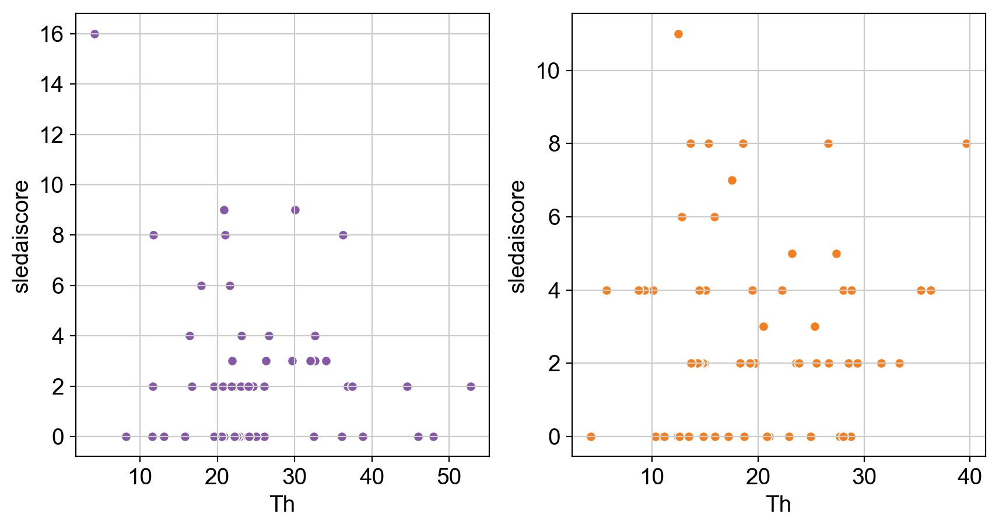

In [71]:
fig,ax = plt.subplots(nrows=1,ncols=2, figsize=(10,5))
sns.scatterplot(x='Th', y='sledaiscore', data=joined_pivot_perc[joined_pivot_perc.disease_pop_cov=="sleWHITE"], color='#8559A5',ax=ax[0])
sns.scatterplot(x='Th', y='sledaiscore', data=joined_pivot_perc[joined_pivot_perc.disease_pop_cov=="sleASIAN"], color='#F47F20',ax=ax[1])

## Plot correlation for monocytes and lymphocytes

(0.9660444703282641, 1.554090627336992e-63)
(0.8815638515427816, 5.176917217561941e-36)


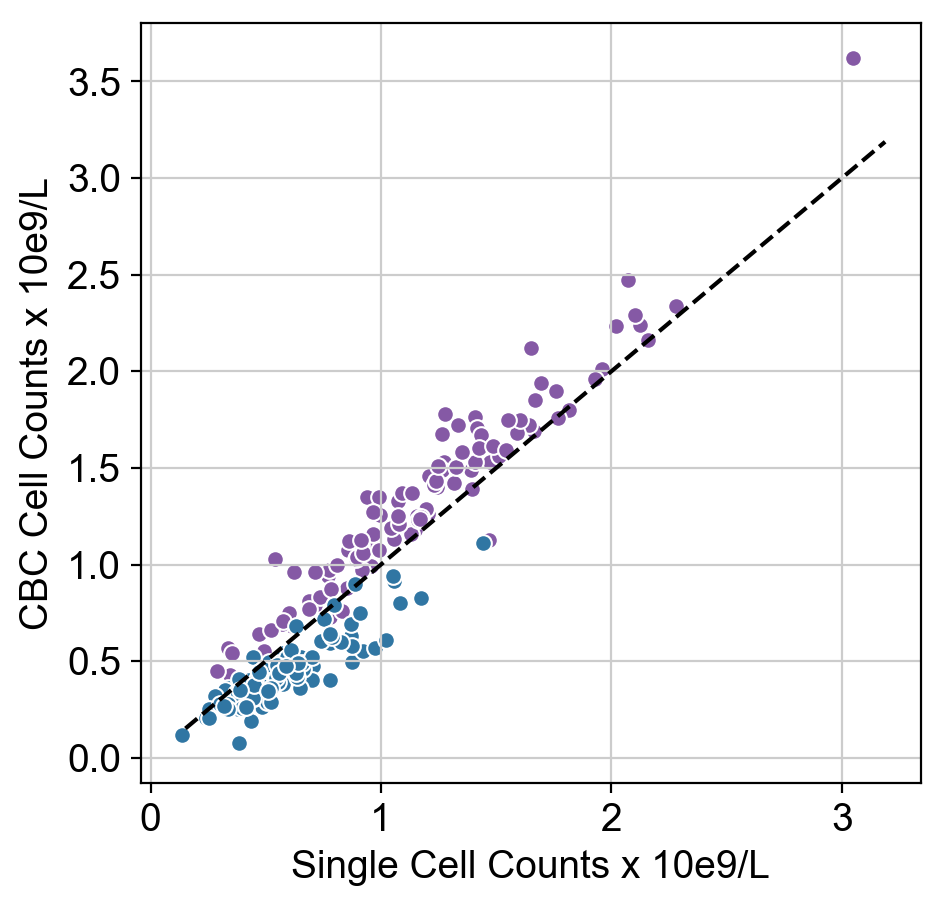

In [72]:
## calculate correlation
lympho_cor = stats.pearsonr(joined_agg_pivot_clues.lymph, joined_agg_pivot_clues.AbsLympho)
mono_cor = stats.pearsonr(joined_agg_pivot_clues.mono, joined_agg_pivot_clues.AbsMono)

fig,ax = plt.subplots(nrows=1,ncols=1, figsize=(5,5))
#fig.tight_layout()

sns.scatterplot(x='lymph', y='AbsLympho', data=joined_agg_pivot_clues, color='#8559A5',ax=ax)
ax.plot(ax.get_xlim(), ax.get_xlim(), '--', color='#000000')

sns.scatterplot(x='mono', y='AbsMono', data=joined_agg_pivot_clues, color='#3076A3',ax=ax)
ax.set(xlabel="Single Cell Counts x 10e9/L", ylabel="CBC Cell Counts x 10e9/L")

##ax[1].set(xlabel="Single Cell Counts x 10e9/L", ylabel="CBC Cell Counts x 10e9/L")
##ax[1].plot(ax[1].get_xlim(), ax[1].get_xlim(), '--', color='#000000')

fig.savefig(figdir+"ct.corr.png")

print(lympho_cor)
print(mono_cor)

(0.8630069068294509, 6.544201491825154e-33)
(0.8630069068294509, 6.544201491825154e-33)


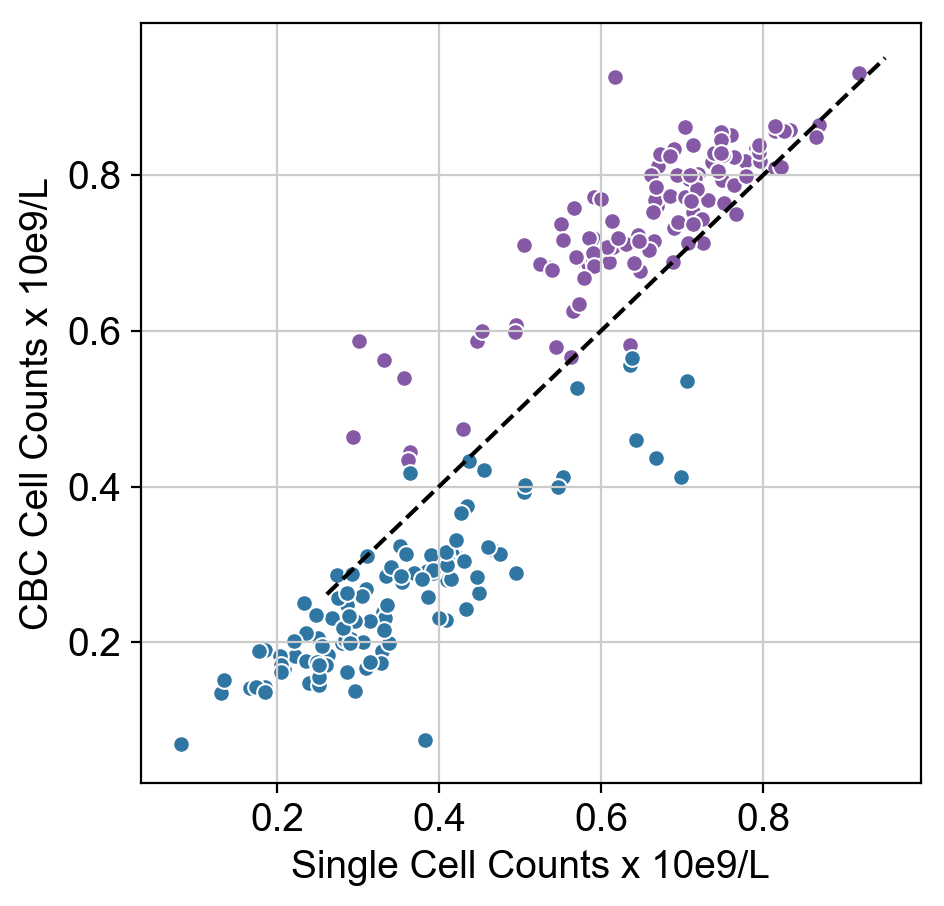

In [73]:
## calculate correlation
mono_frac = joined_agg_pivot_clues.mono/(joined_agg_pivot_clues.lymph+joined_agg_pivot_clues.mono);
lympho_frac = joined_agg_pivot_clues.lymph/(joined_agg_pivot_clues.lymph+joined_agg_pivot_clues.mono);

Lympho_frac = joined_agg_pivot_clues.AbsLympho/(joined_agg_pivot_clues.AbsLympho+joined_agg_pivot_clues.AbsMono)
Mono_frac = joined_agg_pivot_clues.AbsMono/(joined_agg_pivot_clues.AbsLympho+joined_agg_pivot_clues.AbsMono)


lympho_cor = stats.pearsonr(lympho_frac, Lympho_frac)
mono_cor = stats.pearsonr(mono_frac, Mono_frac)

fig,ax = plt.subplots(nrows=1,ncols=1, figsize=(5,5))
#fig.tight_layout()

sns.scatterplot(x=lympho_frac, y=Lympho_frac, data=joined_agg_pivot_clues, color='#8559A5',ax=ax)
ax.plot(ax.get_xlim(), ax.get_xlim(), '--', color='#000000')

sns.scatterplot(x=mono_frac, y=Mono_frac, data=joined_agg_pivot_clues, color='#3076A3',ax=ax)
ax.set(xlabel="Single Cell Counts x 10e9/L", ylabel="CBC Cell Counts x 10e9/L")

##ax[1].set(xlabel="Single Cell Counts x 10e9/L", ylabel="CBC Cell Counts x 10e9/L")
##ax[1].plot(ax[1].get_xlim(), ax[1].get_xlim(), '--', color='#000000')

print(lympho_cor)
print(mono_cor)

(0.8251587092525078, 8.49151452758607e-28)
(0.8574660834995506, 4.515419395940838e-32)


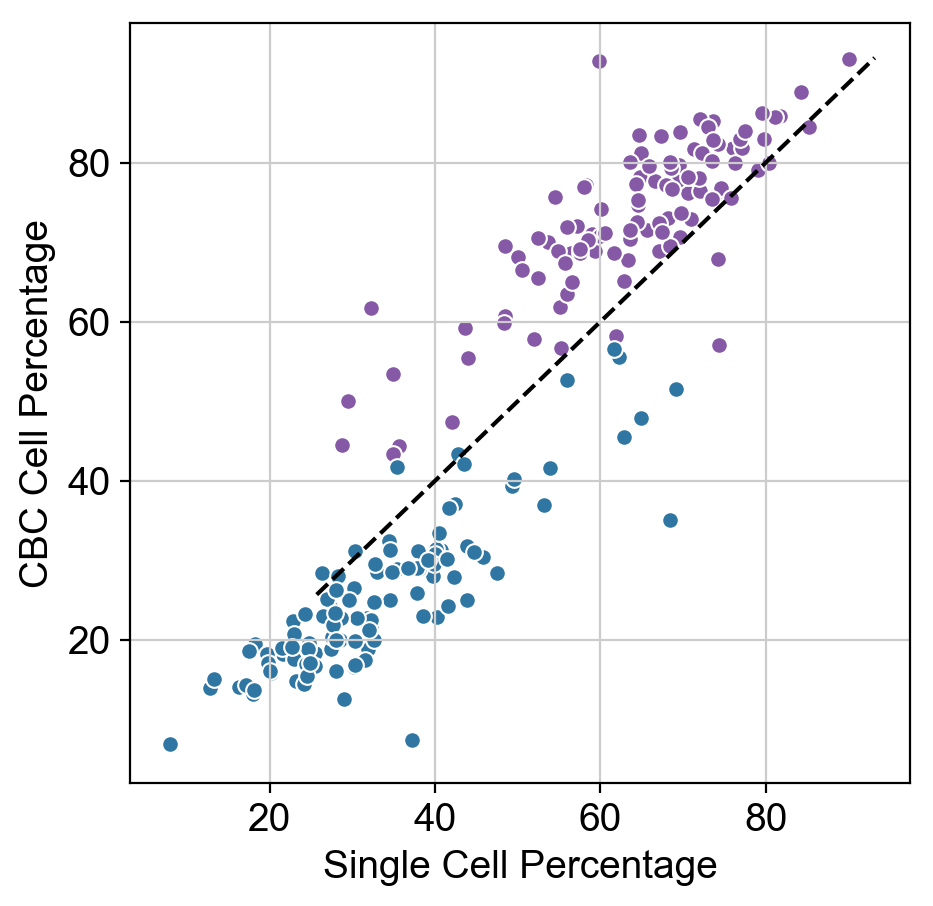

In [74]:
## calculate correlation
lympho_cor = stats.pearsonr(joined_agg_pivot_perc_clues.lymph, joined_agg_pivot_perc_clues.PercLympho)
mono_cor = stats.pearsonr(joined_agg_pivot_perc_clues.mono, joined_agg_pivot_perc_clues.PercMono)

fig,ax = plt.subplots(nrows=1,ncols=1, figsize=(5,5))
#fig.tight_layout()

sns.scatterplot(x='lymph', y='PercLympho', data=joined_agg_pivot_perc_clues, color='#8559A5',ax=ax)
ax.plot(ax.get_xlim(), ax.get_xlim(), '--', color='#000000')

sns.scatterplot(x='mono', y='PercMono', data=joined_agg_pivot_perc_clues, color='#3076A3',ax=ax)
ax.set(xlabel="Single Cell Percentage", ylabel="CBC Cell Percentage")

##ax[1].set(xlabel="Single Cell Counts x 10e9/L", ylabel="CBC Cell Counts x 10e9/L")
##ax[1].plot(ax[1].get_xlim(), ax[1].get_xlim(), '--', color='#000000')

fig.savefig(figdir+"ct.corr.perc.png")

print(lympho_cor)
print(mono_cor)

## Plot cell abundance

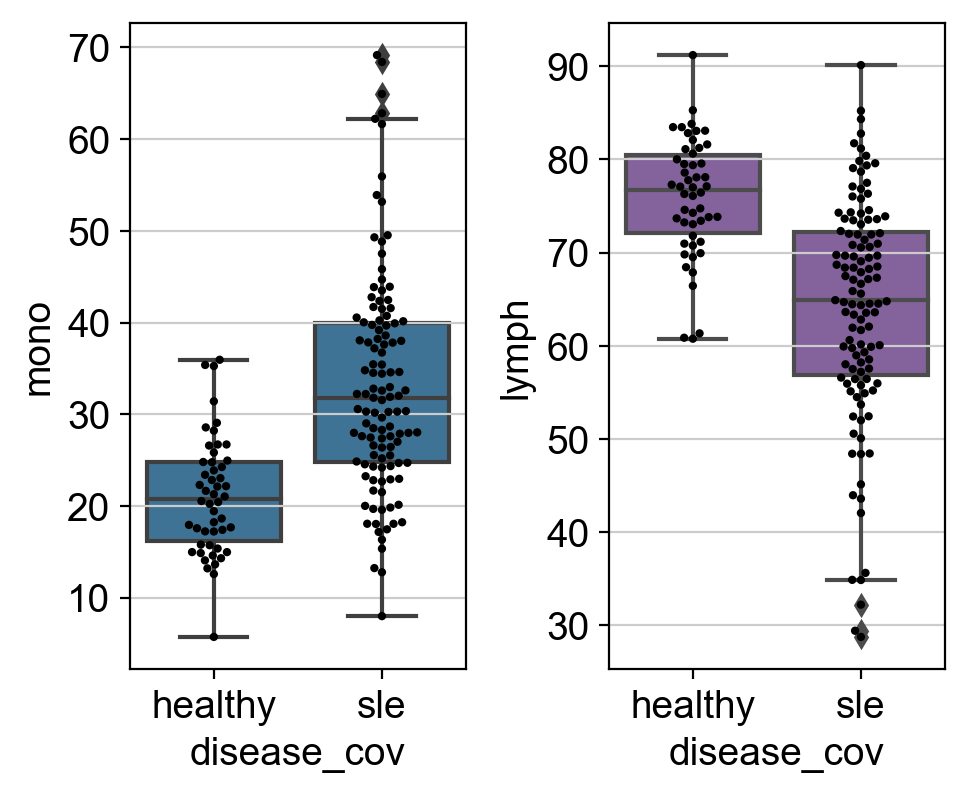

In [75]:
## now let's also plot the monocyte and lymphocyte counts between sle and control
## immvar samples are
##IGTB1290 IGTB1372 IGTB141 IGTB143 IGTB1506 IGTB1539 IGTB1540 IGTB1542 IGTB1575 IGTB1650 IGTB1921 IGTB195 IGTB256 IGTB469 IGTB498 IGTB508 IGTB514 IGTB645 IGTB670 IGTB826 IGTB884 IGTB986

joined_agg.disease_cov = pd.Categorical(joined_agg.disease_cov,categories=['healthy','sle'], ordered=True)
joined_agg_pivot_perc.disease_cov = pd.Categorical(joined_agg_pivot_perc.disease_cov,categories=['healthy','sle'], ordered=True)


fig,ax = plt.subplots(nrows=1,ncols=2, figsize=(5,4))
fig.tight_layout()

for cg_i in [0, 1] :
    cg = ['mono', 'lymph'][cg_i]
##    sns.boxplot(x="disease_cov", y=cg, data=joined_agg_pivot[~(joined_agg_pivot.AbsMono < 5/1000)], color=['#F47F20','#8559A5','#7f7f7f'][cg_i], ax=ax[cg_i])
##    sns.swarmplot(x="disease_cov", y=cg, data=joined_agg_pivot[~(joined_agg_pivot.AbsMono < 5/1000)], color="0", size=3, ax=ax[cg_i])
    sns.boxplot(x="disease_cov", y=cg, data=joined_agg_pivot_perc[~(joined_agg_pivot_perc.mono == 0)], color=['#3076A3','#8559A5','#7f7f7f'][cg_i], ax=ax[cg_i])
    sns.swarmplot(x="disease_cov", y=cg, data=joined_agg_pivot_perc[~(joined_agg_pivot_perc.mono == 0)], color="0", size=3, ax=ax[cg_i])

    
fig.savefig(figdir+"/mono.lymph.perc.png")

## now let's also plot the monocyte and lymphocyte counts between sle and control
## immvar samples are
##IGTB1290 IGTB1372 IGTB141 IGTB143 IGTB1506 IGTB1539 IGTB1540 IGTB1542 IGTB1575 IGTB1650 IGTB1921 IGTB195 IGTB256 IGTB469 IGTB498 IGTB508 IGTB514 IGTB645 IGTB670 IGTB826 IGTB884 IGTB986

# ##joined_agg.disease_cov = pd.Categorical(joined_agg.disease_cov,categories=['healthy','sle'], ordered=True)
# joined_agg_pivot_perc.disease_cov = pd.Categorical(joined_agg_pivot_perc.disease_cov,categories=['healthy','sle'], ordered=True)


# fig,ax = plt.subplots(nrows=1,ncols=3, figsize=(10,8))
# fig.tight_layout()

# for cg_i in [0, 1,2] :
#     cg = ['mono', 'lymph','lymph'][cg_i]
#     sns.boxplot(x="disease_cov", y=cg, data=joined_agg_pivot_perc[~(joined_agg_pivot_perc.AbsMono < 5/1000)], color=['#ff7f0e','#d62728','#7f7f7f'][cg_i], ax=ax[cg_i])
#     sns.swarmplot(x="disease_cov", y=cg, data=joined_agg_pivot_perc[~(joined_agg_pivot_perc.AbsMono < 5/1000)], color="0", size=3, ax=ax[cg_i])


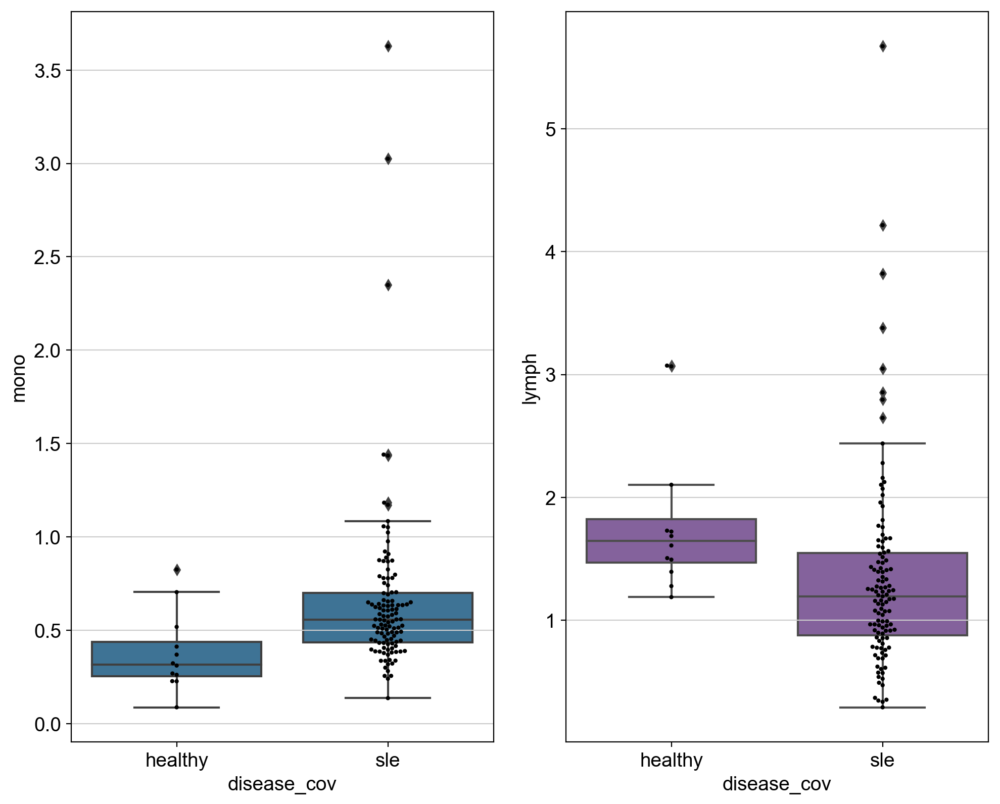

In [76]:
## now let's also plot the monocyte and lymphocyte counts between sle and control
## immvar samples are
##IGTB1290 IGTB1372 IGTB141 IGTB143 IGTB1506 IGTB1539 IGTB1540 IGTB1542 IGTB1575 IGTB1650 IGTB1921 IGTB195 IGTB256 IGTB469 IGTB498 IGTB508 IGTB514 IGTB645 IGTB670 IGTB826 IGTB884 IGTB986

joined_agg.disease_cov = pd.Categorical(joined_agg.disease_cov,categories=['healthy','sle'], ordered=True)
joined_agg_pivot.disease_cov = pd.Categorical(joined_agg_pivot.disease_cov,categories=['healthy','sle'], ordered=True)


fig,ax = plt.subplots(nrows=1,ncols=2, figsize=(10,8))
fig.tight_layout()

for cg_i in [0, 1] :
    cg = ['mono', 'lymph'][cg_i]
##    sns.boxplot(x="disease_cov", y=cg, data=joined_agg_pivot[~(joined_agg_pivot.AbsMono < 5/1000)], color=['#F47F20','#8559A5','#7f7f7f'][cg_i], ax=ax[cg_i])
##    sns.swarmplot(x="disease_cov", y=cg, data=joined_agg_pivot[~(joined_agg_pivot.AbsMono < 5/1000)], color="0", size=3, ax=ax[cg_i])
    sns.boxplot(x="disease_cov", y=cg, data=joined_agg_pivot[~(joined_agg_pivot.mono == 0)], color=['#3076A3','#8559A5','#7f7f7f'][cg_i], ax=ax[cg_i])
    sns.swarmplot(x="disease_cov", y=cg, data=joined_agg_pivot[~(joined_agg_pivot.mono == 0)], color="0", size=3, ax=ax[cg_i])

    

## now let's also plot the monocyte and lymphocyte counts between sle and control
## immvar samples are
##IGTB1290 IGTB1372 IGTB141 IGTB143 IGTB1506 IGTB1539 IGTB1540 IGTB1542 IGTB1575 IGTB1650 IGTB1921 IGTB195 IGTB256 IGTB469 IGTB498 IGTB508 IGTB514 IGTB645 IGTB670 IGTB826 IGTB884 IGTB986

# ##joined_agg.disease_cov = pd.Categorical(joined_agg.disease_cov,categories=['healthy','sle'], ordered=True)
# joined_agg_pivot_perc.disease_cov = pd.Categorical(joined_agg_pivot_perc.disease_cov,categories=['healthy','sle'], ordered=True)


# fig,ax = plt.subplots(nrows=1,ncols=3, figsize=(10,8))
# fig.tight_layout()

# for cg_i in [0, 1,2] :
#     cg = ['mono', 'lymph','lymph'][cg_i]
#     sns.boxplot(x="disease_cov", y=cg, data=joined_agg_pivot_perc[~(joined_agg_pivot_perc.AbsMono < 5/1000)], color=['#ff7f0e','#d62728','#7f7f7f'][cg_i], ax=ax[cg_i])
#     sns.swarmplot(x="disease_cov", y=cg, data=joined_agg_pivot_perc[~(joined_agg_pivot_perc.AbsMono < 5/1000)], color="0", size=3, ax=ax[cg_i])


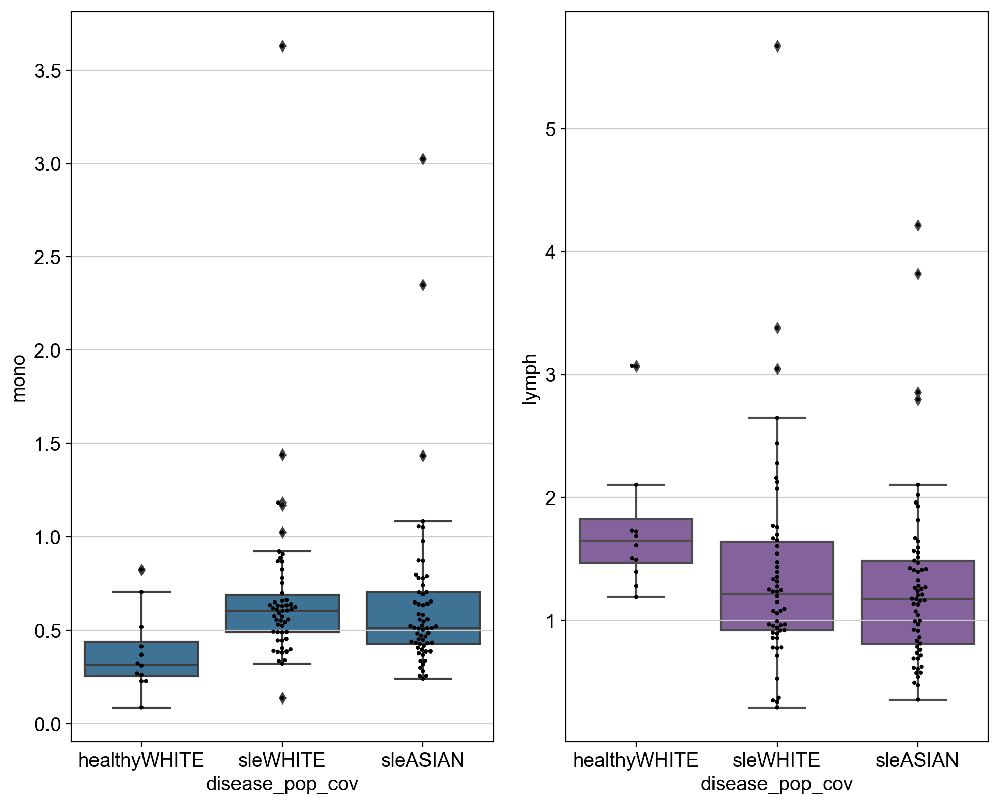

In [77]:
## now let's also plot the monocyte and lymphocyte counts between sle and control
## immvar samples are
##IGTB1290 IGTB1372 IGTB141 IGTB143 IGTB1506 IGTB1539 IGTB1540 IGTB1542 IGTB1575 IGTB1650 IGTB1921 IGTB195 IGTB256 IGTB469 IGTB498 IGTB508 IGTB514 IGTB645 IGTB670 IGTB826 IGTB884 IGTB986

joined_agg.disease_pop_cov = pd.Categorical(joined_agg.disease_pop_cov,categories=['healthyWHITE','sleWHITE','sleASIAN'], ordered=True)
joined_agg_pivot.disease_pop_cov = pd.Categorical(joined_agg_pivot.disease_pop_cov,categories=['healthyWHITE','sleWHITE','sleASIAN'], ordered=True)


fig,ax = plt.subplots(nrows=1,ncols=2, figsize=(10,8))
fig.tight_layout()

for cg_i in [0, 1] :
    cg = ['mono', 'lymph'][cg_i]
    sns.boxplot(x="disease_pop_cov", y=cg, data=joined_agg_pivot[~(joined_agg_pivot.mono == 0)], color=['#3076A3','#8559A5','#7f7f7f'][cg_i], ax=ax[cg_i])
    sns.swarmplot(x="disease_pop_cov", y=cg, data=joined_agg_pivot[~(joined_agg_pivot.mono == 0)], color="0", size=3, ax=ax[cg_i])

    
## now let's also plot the monocyte and lymphocyte counts between sle and control
## immvar samples are
##IGTB1290 IGTB1372 IGTB141 IGTB143 IGTB1506 IGTB1539 IGTB1540 IGTB1542 IGTB1575 IGTB1650 IGTB1921 IGTB195 IGTB256 IGTB469 IGTB498 IGTB508 IGTB514 IGTB645 IGTB670 IGTB826 IGTB884 IGTB986

# ##joined_agg.disease_cov = pd.Categorical(joined_agg.disease_cov,categories=['healthy','sle'], ordered=True)
# joined_agg_pivot_perc.disease_cov = pd.Categorical(joined_agg_pivot_perc.disease_cov,categories=['healthy','sle'], ordered=True)


# fig,ax = plt.subplots(nrows=1,ncols=3, figsize=(10,8))
# fig.tight_layout()

# for cg_i in [0, 1,2] :
#     cg = ['mono', 'lymph','lymph'][cg_i]
#     sns.boxplot(x="disease_cov", y=cg, data=joined_agg_pivot_perc[~(joined_agg_pivot_perc.AbsMono < 5/1000)], color=['#ff7f0e','#d62728','#7f7f7f'][cg_i], ax=ax[cg_i])
#     sns.swarmplot(x="disease_cov", y=cg, data=joined_agg_pivot_perc[~(joined_agg_pivot_perc.AbsMono < 5/1000)], color="0", size=3, ax=ax[cg_i])


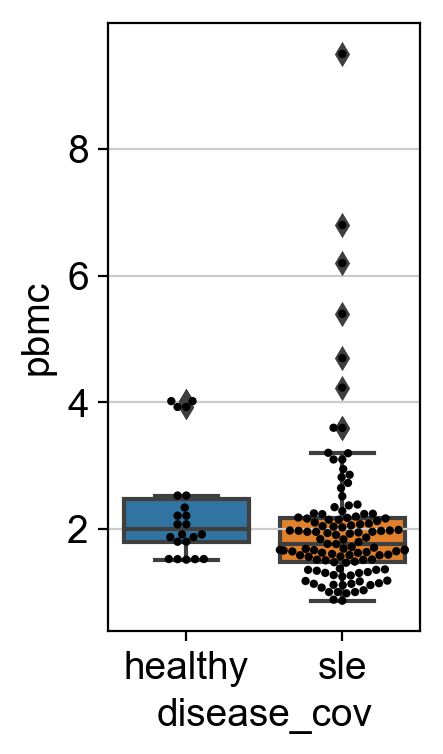

In [78]:
fig,ax = plt.subplots()
fig.set_size_inches(2,4)
ax = sns.boxplot(x="disease_cov", y="pbmc", data=joined_pivot[~(joined_pivot.pbmc == 0)])
ax = sns.swarmplot(x="disease_cov", y="pbmc", data=joined_pivot[~(joined_pivot.pbmc == 0)], color="0", size=3)


/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: FutureWarning: read_table is deprecated, use read_csv instead.
  


Cell type:Progen,Race:White or Caucasian
Beta=0.026421768048560033, pvalue=0.25650563848207053
Cell type:Progen,Race:Black or African American
Beta=-0.0447331932773108, pvalue=0.21628339429165347
Cell type:Progen,Race:Asian
Beta=-0.015488095238095247, pvalue=0.4957218204336783
Cell type:Progen,Race:White or Caucasian
Beta=-0.4990948275862069, pvalue=8.000617380532096e-09
Cell type:Progen,Race:Black or African American
Beta=-0.7360336134453774, pvalue=0.0001811104138938749
Cell type:Progen,Race:Asian
Beta=-0.7384702380952379, pvalue=1.659635608701236e-14


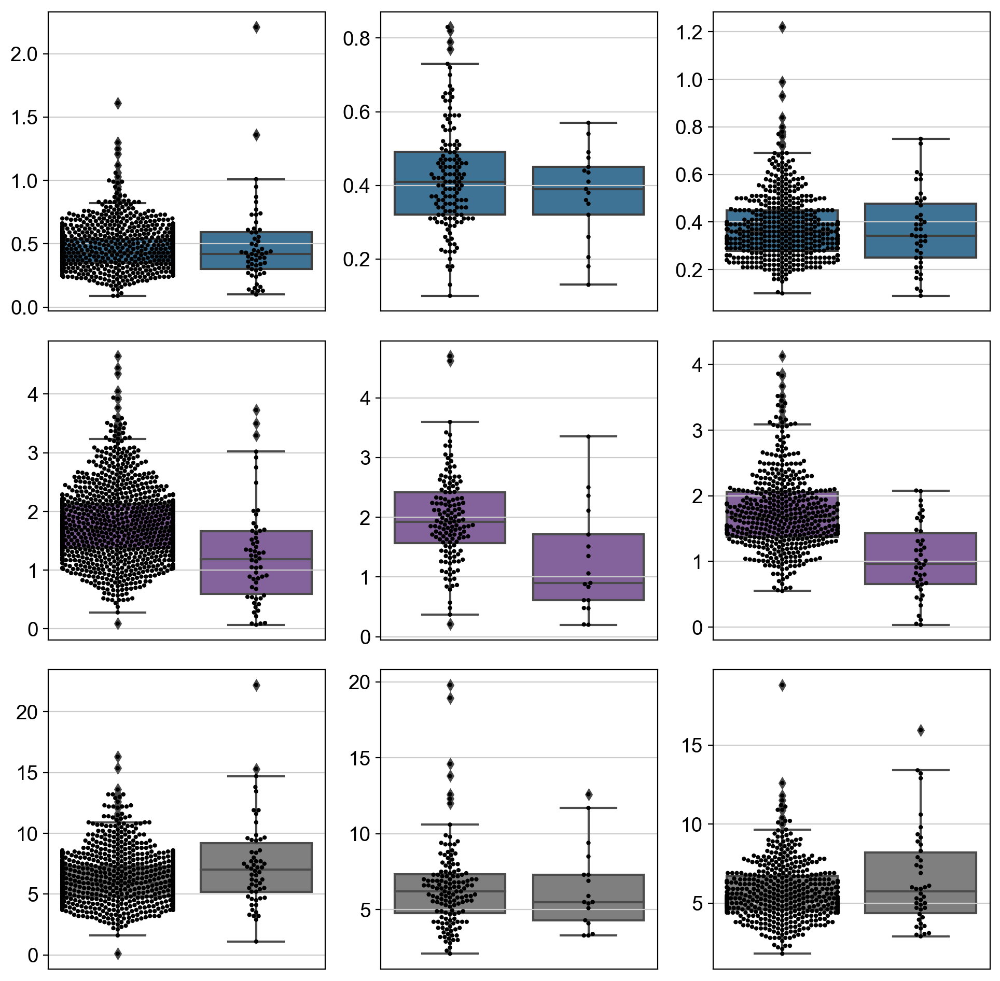

In [79]:
## Now let's analyze the EHR data
ehr = pd.read_table("meena_lupus_2017-11-15.csv", sep=",")
ehr_pivot = ehr.pivot_table(index=['Patient_ID',"Lab_Age","Patient_Sex","Patient_Race","CASE"],columns="Lab_Name",values="Lab_Value")
ehr_pivot.reset_index(inplace=True)
ehr_pivot = ehr_pivot[ehr_pivot['monocyte abs count'] < 5]
ehr_pivot = ehr_pivot[ehr_pivot['lymphocyte abs cnt'] < 6]

fig,ax = plt.subplots(nrows=3,ncols=3, figsize=(10,10))
fig.tight_layout()
plt.subplots_adjust(wspace=0.2, hspace=0.1)

## find samples with both monocyte and lymphocyte count
for cg_i in [0, 1, 2] :
    cg = ['monocyte abs count', 'lymphocyte abs cnt', 'wbc count'][cg_i]
    for r_i in [0,1,2] :
        race = ['White or Caucasian', 'Black or African American', 'Asian'][r_i]
        sns.boxplot(x="CASE", y=cg, data=ehr_pivot[ehr_pivot.Patient_Race==race], color=['#3076A3','#8559A5','#7f7f7f'][cg_i], ax=ax[cg_i,r_i])
        sns.swarmplot(x="CASE", y=cg, data=ehr_pivot[ehr_pivot.Patient_Race==race], color="0", size=3, ax=ax[cg_i,r_i])
        ax[cg_i,r_i].get_xaxis().set_visible(False)
        ax[cg_i,r_i].get_yaxis().label.set_visible(False)


fig.savefig(figdir+"/ehr.boxplot.png")

##perc_plot = sns.catplot(x='CASE', y='Lab_Value', col='Lab_Name', data=ehr, kind='violin', row='Patient_Race', dodge=False, aspect=0.4, sharex=False, sharey=False)

## test for differences in abundance
for cg_i in [0, 1] :
    cg = ['monocyte abs count', 'lymphocyte abs cnt'][cg_i]
    for race in ['White or Caucasian', 'Black or African American', 'Asian'] :
        abundance = ehr_pivot[ehr_pivot.Patient_Race==race][cg].values
        disease = ehr_pivot.CASE[ehr_pivot.Patient_Race==race]
        disease = sm.add_constant(disease)
        print('Cell type:'+ ct +",Race:"+race)
        est=sm.OLS(abundance.astype(float), disease.astype(float))
        est=est.fit()
        effect=est.params[1]
        pval=est.pvalues[1]
        print('Beta='+str(effect)+', pvalue='+str(pval))
        


/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:13: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  del sys.path[0]
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:13: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  del sys.path[0]
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:13: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  del sys.path[0]
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:13: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  del sys.path[0]
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:13: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  del sys.path[0]
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:13: UserWarning: Boolean Series key will be reindexed to mat

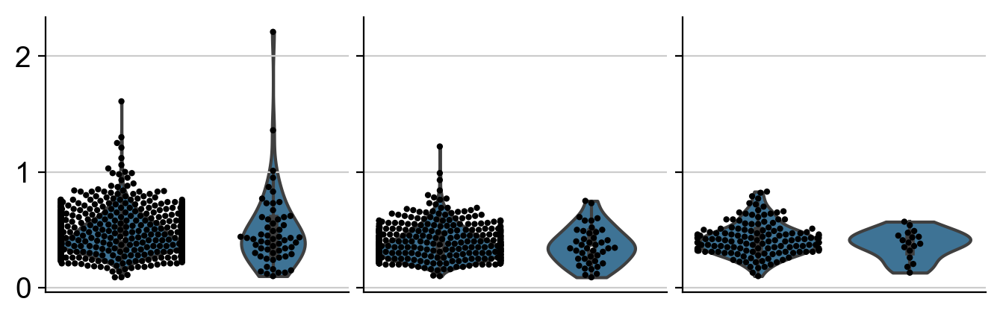

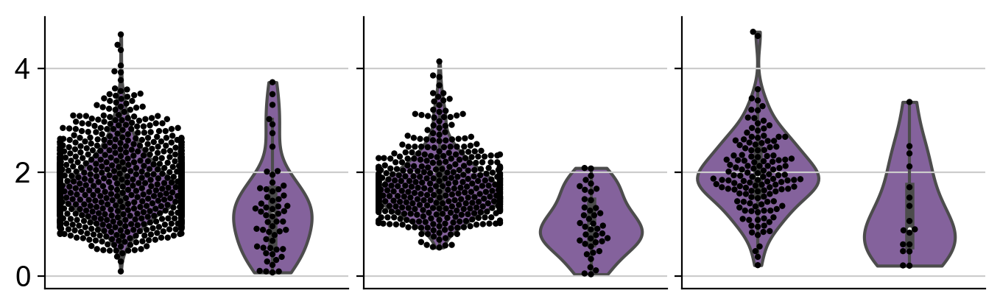

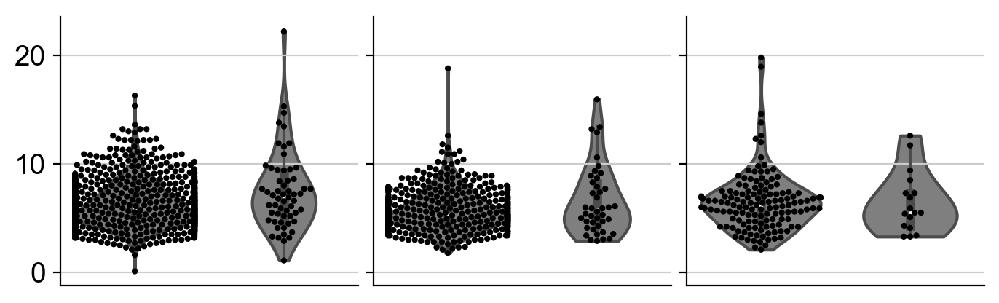

In [80]:
## Now let's analyze the EHR data
ehr_pivot_small = ehr_pivot[ehr_pivot.Patient_Race.isin(['White or Caucasian', 'Black or African American', 'Asian'])]

ehr_pivot_small_melt = ehr_pivot_small.melt(id_vars=['Patient_Race','CASE'], value_vars=["lymphocyte abs cnt", "monocyte abs count", "wbc count"])

for cg_i in [0, 1, 2] :
    cg = ['monocyte abs count', 'lymphocyte abs cnt', 'wbc count'][cg_i]
    ehr_plot = sns.catplot(x='CASE', y=cg, col='Patient_Race', data=ehr_pivot_small, kind='violin', color=['#3076A3','#8559A5','#7f7f7f'][cg_i], height = 3, aspect=0.9, dodge=False, sharex=False, sharey=True, cut=0)
    ehr_plot.fig.subplots_adjust(wspace=0.05)
    
    for r_i in [0,1,2] :
        race = ['White or Caucasian', 'Asian', 'Black or African American'][r_i]
        sns.swarmplot(x="CASE", y=cg, data=ehr_pivot_small[ehr_pivot.Patient_Race==race], color="0", size=3, ax=ehr_plot.axes[0,r_i])
        ehr_plot.axes[0,r_i].get_yaxis().label.set_visible(False)
        ehr_plot.axes[0,r_i].get_xaxis().label.set_visible(False)
        ehr_plot.axes[0,r_i].get_xaxis().set_visible(False)
        ##ehr_plot.axes[0,r_i].get_xaxis().ticklabels.set_visible(False)
        ##ehr_plot.axes[0,r_i].setxaxislabelsticklabels.set_visible(False)
        ehr_plot.set_titles(row_template = '', col_template = '')

    ##ax[cg_i,r_i].get_xaxis().set_visible(False)
    ##ax[cg_i,r_i].get_yaxis().label.set_visible(False)
    ##    ehr_plot.set_xticklabels(rotation=90)
    ehr_plot.savefig(figdir+cg+".violin.ehr.png")

##fig.savefig(figdir+"/ehr.violin.png")

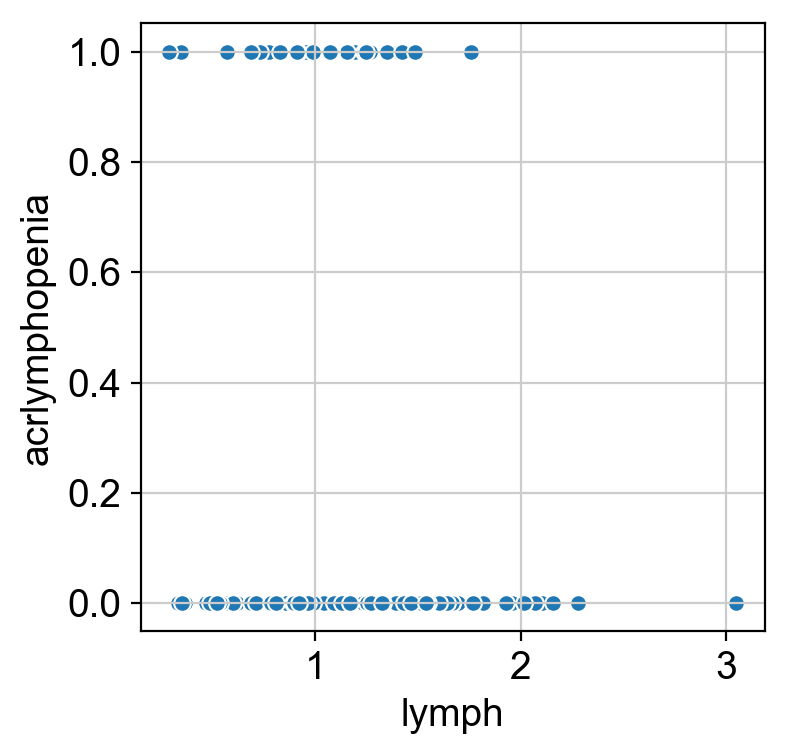

In [81]:
sns.scatterplot(joined_agg_pivot_clues.lymph, joined_agg_pivot_clues.acrlymphopenia)

## test

In [82]:
ifn = pd.read_table("v2.ifn.sig.txt", sep=" ", index_col=False)
ifn.name = ifn.name.apply(lambda x: x.split('_')[0])
joined2 = ifn.join(joined.set_index("ind_cov"), on="name")
joined_pivot2 = joined2.pivot_table(index=['name',"disease_cov","pbmc","ifn","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="ct_cov", values="estimate")
joined_pivot2.reset_index(inplace=True)

print(joined_pivot2[joined_pivot2.pbmc < 0])
joined_pivot2 = joined_pivot2[joined_pivot2.pbmc > 0]

print(joined_pivot2[joined_pivot2.pbmc > 10])
joined_pivot2 = joined_pivot2[joined_pivot2.pbmc < 10]


Empty DataFrame
Columns: [name, disease_cov, pbmc, ifn, plaquenilnow, cellceptnow, steroralnow, acrlymphopenia, B, MK, NK, Progen, ProlifT, Tc, Th, cDC, cM, ncM, pDC]
Index: []
Empty DataFrame
Columns: [name, disease_cov, pbmc, ifn, plaquenilnow, cellceptnow, steroralnow, acrlymphopenia, B, MK, NK, Progen, ProlifT, Tc, Th, cDC, cM, ncM, pDC]
Index: []


/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: read_table is deprecated, use read_csv instead.
  """Entry point for launching an IPython kernel.


In [83]:
joined2.ct_cov = joined2.ct_cov.astype("category")
joined2.ct_cov = joined2.ct_cov.cat.reorder_categories(['cM', 'ncM', 'cDC', 'pDC', 'Th', 'Tc', 'NK', 'ProlifT', 'B', 'MK', 'Progen'])

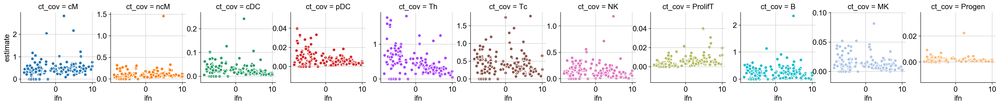

In [84]:
g = sns.FacetGrid(joined2, col="ct_cov",  hue="ct_cov", aspect=0.8, height=3, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy)
g = g.map(plt.scatter, "ifn", "estimate", edgecolor="w")
g.fig.subplots_adjust(wspace=0.2)
g.savefig(figdir+"/ifn.ct_cov.png")

In [85]:
ifn = pd.read_table("v2.ifn.sig.txt", sep=" ", index_col=False)
ifn.name = ifn.name.apply(lambda x: x.split('_')[0])
joined2 = ifn.join(joined.set_index("ind_cov"), on="name")
joined_pivot2 = joined2.pivot_table(index=['name',"disease_cov","pbmc","ifn","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="ct_cov", values="ct_perc")
joined_pivot2.reset_index(inplace=True)

print(joined_pivot2[joined_pivot2.pbmc < 0])
joined_pivot2 = joined_pivot2[joined_pivot2.pbmc > 0]

print(joined_pivot2[joined_pivot2.pbmc > 10])
joined_pivot2 = joined_pivot2[joined_pivot2.pbmc < 10]


Empty DataFrame
Columns: [name, disease_cov, pbmc, ifn, plaquenilnow, cellceptnow, steroralnow, acrlymphopenia, B, MK, NK, Progen, ProlifT, Tc, Th, cDC, cM, ncM, pDC]
Index: []
Empty DataFrame
Columns: [name, disease_cov, pbmc, ifn, plaquenilnow, cellceptnow, steroralnow, acrlymphopenia, B, MK, NK, Progen, ProlifT, Tc, Th, cDC, cM, ncM, pDC]
Index: []


/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: read_table is deprecated, use read_csv instead.
  """Entry point for launching an IPython kernel.


In [86]:
joined2.ct_cov = joined2.ct_cov.astype("category")
joined2.ct_cov = joined2.ct_cov.cat.reorder_categories(['cM', 'ncM', 'cDC', 'pDC', 'Th', 'Tc', 'NK', 'ProlifT', 'B', 'MK', 'Progen'])

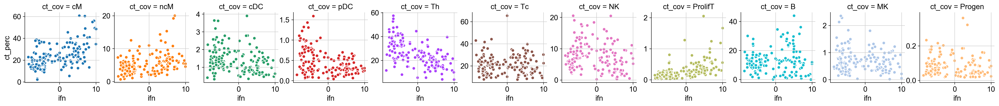

In [87]:
g = sns.FacetGrid(joined2, col="ct_cov",  hue="ct_cov", aspect=0.8, height=3, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy)
g = g.map(plt.scatter, "ifn", "ct_perc", edgecolor="w")
g.fig.subplots_adjust(wspace=0.2)
g.savefig(figdir+"/ifn.ct_cov.png")

# Supplementary figures

## Take a look at the effects of treatment

/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


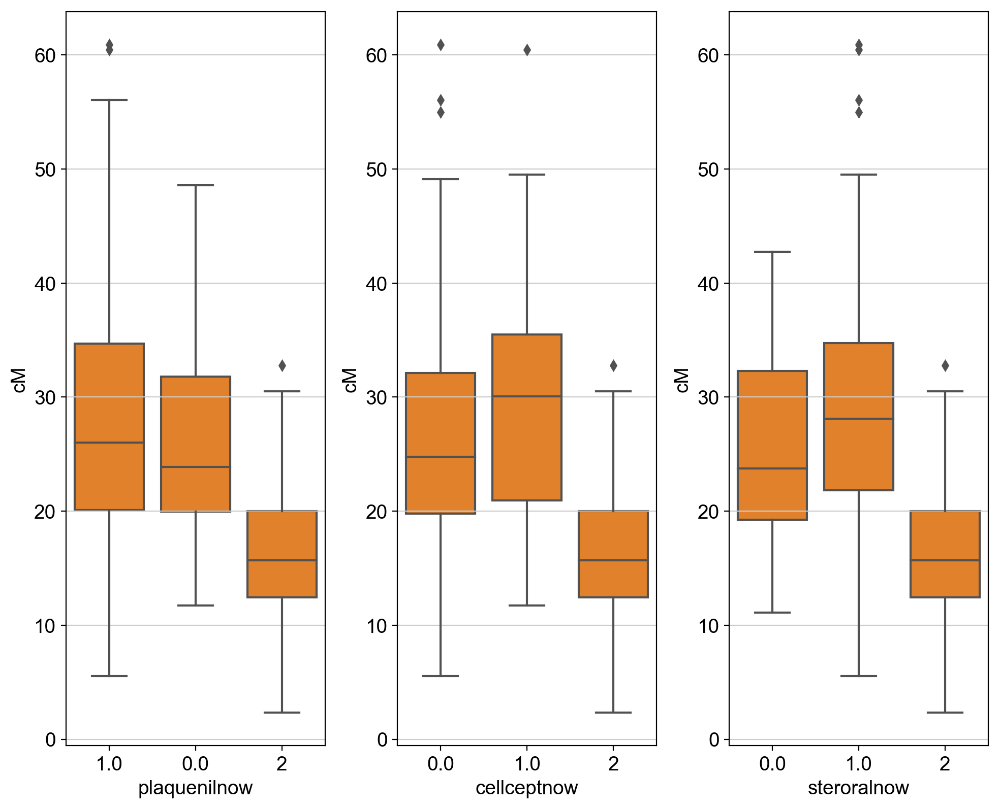

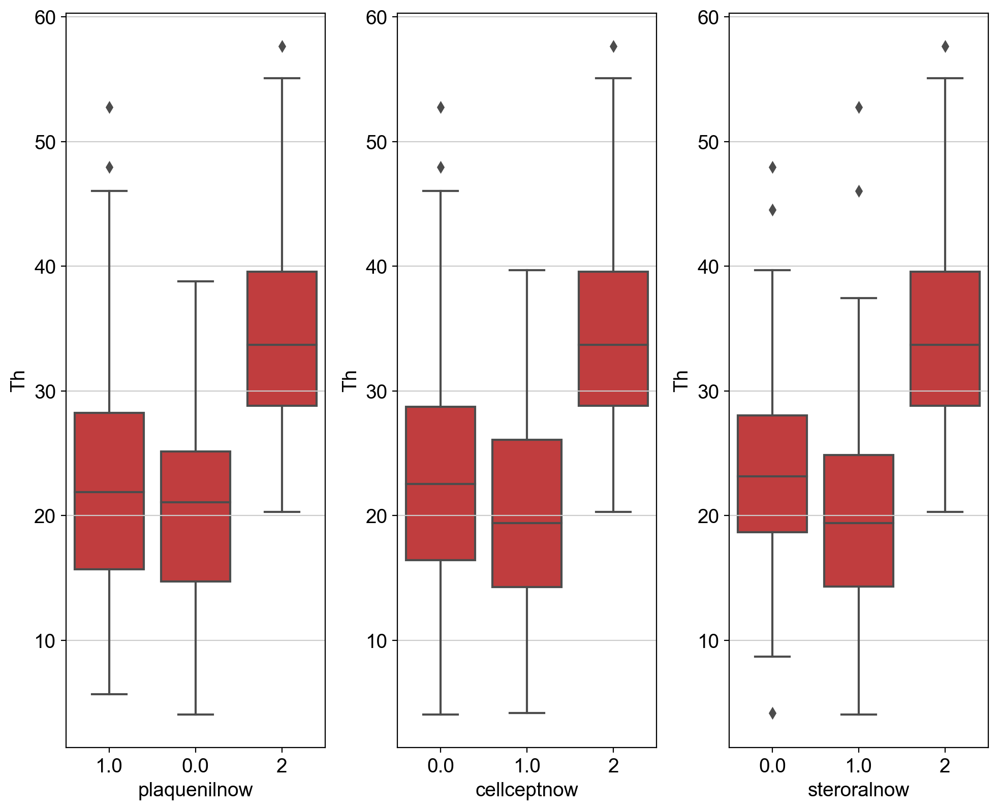

In [88]:
fig,ax = plt.subplots(nrows=1,ncols=3, figsize=(10,8))
fig.tight_layout()

joined_pivot_perc.plaquenilnow[(joined_pivot_perc.disease_cov=="healthy")] = "2";
joined_pivot_perc.cellceptnow[(joined_pivot_perc.disease_cov=="healthy")] = "2";
joined_pivot_perc.steroralnow[(joined_pivot_perc.disease_cov=="healthy")] = "2";

for drug_i in [0, 1,2] :
    drug = ["plaquenilnow", "cellceptnow", "steroralnow"][drug_i]
    ##cg = ['mono', 'lymph','lymph'][cg_i]
    sns.boxplot(x=drug, y="cM", data=joined_pivot_perc, color='#ff7f0e', ax=ax[drug_i])

fig,ax = plt.subplots(nrows=1,ncols=3, figsize=(10,8))
fig.tight_layout()

for drug_i in [0, 1,2] :
    drug = ["plaquenilnow", "cellceptnow", "steroralnow"][drug_i]
    ##cg = ['mono', 'lymph','lymph'][cg_i]
    sns.boxplot(x=drug, y="Th", data=joined_pivot_perc, color='#d62728', ax=ax[drug_i])


/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:

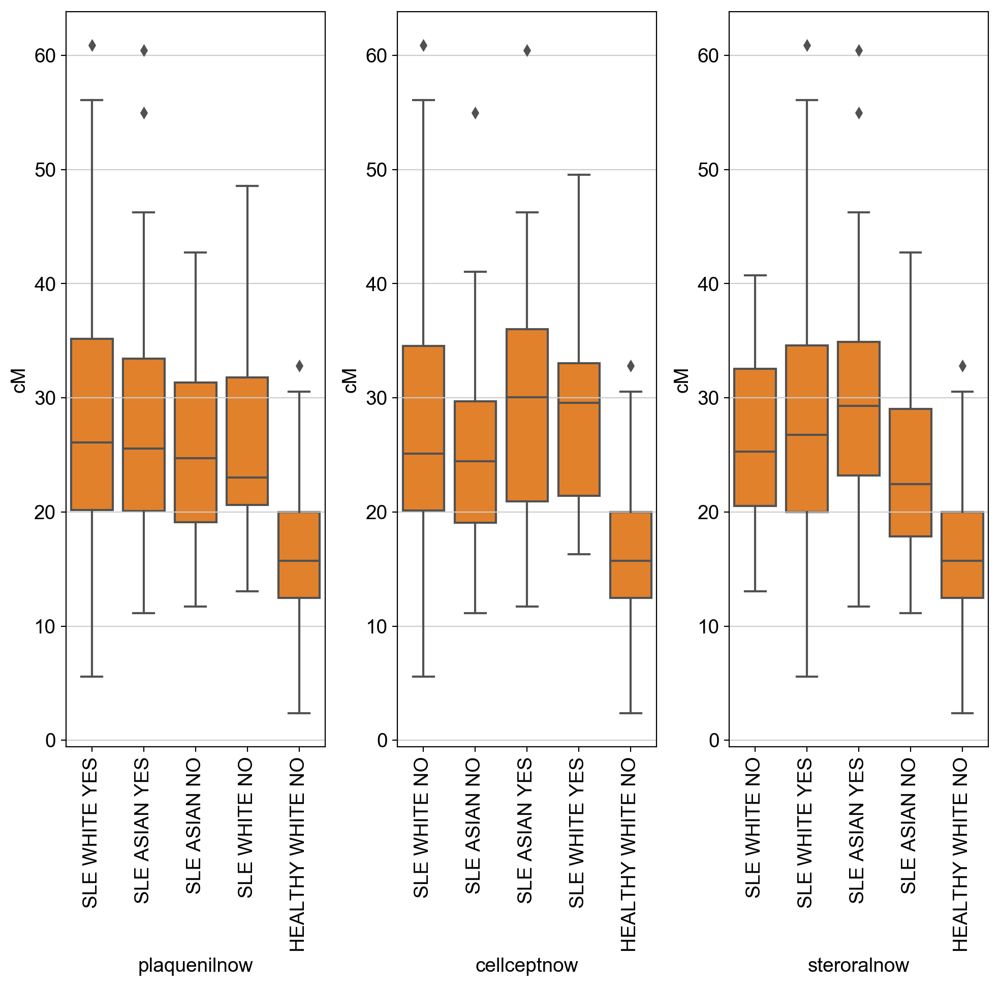

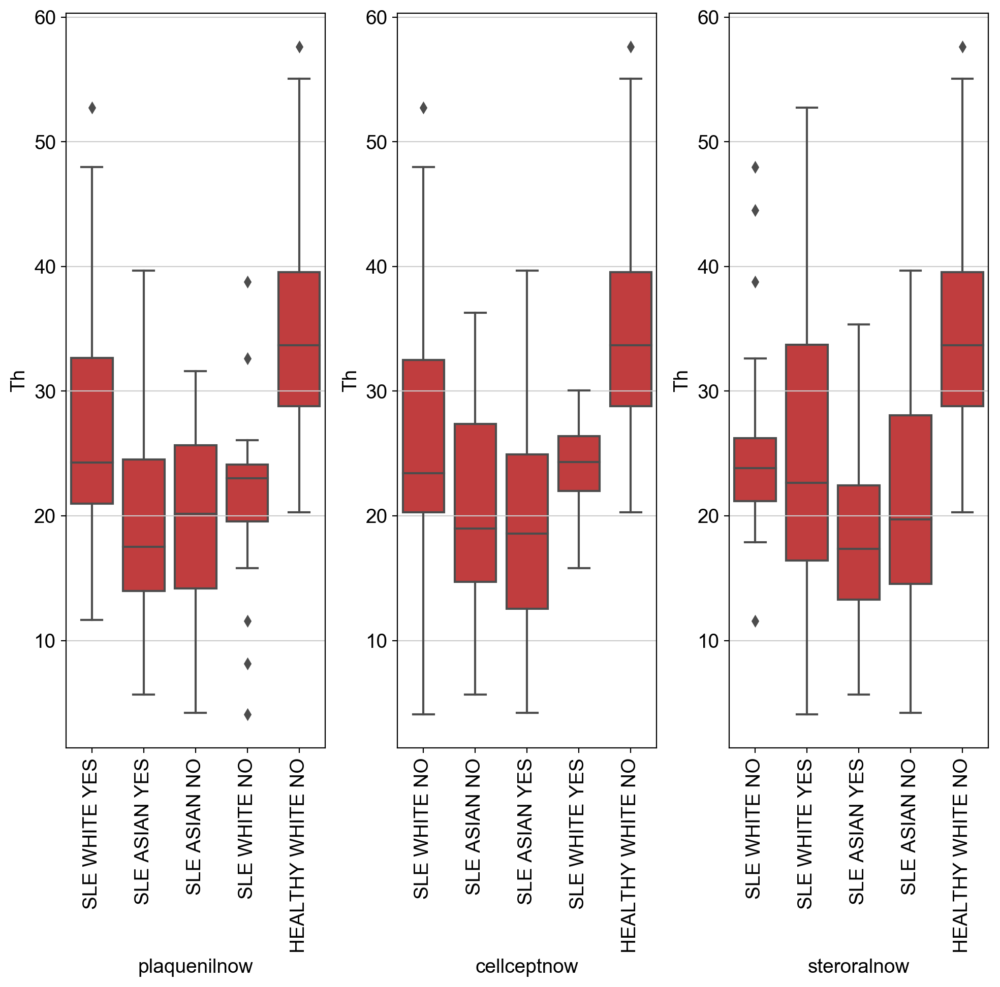

In [89]:
fig,ax = plt.subplots(nrows=1,ncols=3, figsize=(10,8))
fig.tight_layout()

joined_pivot_perc.plaquenilnow[(joined_pivot_perc.disease_pop_cov=="healthyWHITE")] = "HEALTHY WHITE NO";
joined_pivot_perc.plaquenilnow[(joined_pivot_perc.disease_pop_cov=="sleWHITE") & (joined_pivot_perc.plaquenilnow==1)] = "SLE WHITE YES";
joined_pivot_perc.plaquenilnow[(joined_pivot_perc.disease_pop_cov=="sleWHITE") & (joined_pivot_perc.plaquenilnow==0)] = "SLE WHITE NO";
joined_pivot_perc.plaquenilnow[(joined_pivot_perc.disease_pop_cov=="sleASIAN") & (joined_pivot_perc.plaquenilnow==1)] = "SLE ASIAN YES";
joined_pivot_perc.plaquenilnow[(joined_pivot_perc.disease_pop_cov=="sleASIAN") & (joined_pivot_perc.plaquenilnow==0)] = "SLE ASIAN NO";

joined_pivot_perc.cellceptnow[(joined_pivot_perc.disease_pop_cov=="healthyWHITE")] = "HEALTHY WHITE NO";
joined_pivot_perc.cellceptnow[(joined_pivot_perc.disease_pop_cov=="sleWHITE") & (joined_pivot_perc.cellceptnow==1)] = "SLE WHITE YES";
joined_pivot_perc.cellceptnow[(joined_pivot_perc.disease_pop_cov=="sleWHITE") & (joined_pivot_perc.cellceptnow==0)] = "SLE WHITE NO";
joined_pivot_perc.cellceptnow[(joined_pivot_perc.disease_pop_cov=="sleASIAN") & (joined_pivot_perc.cellceptnow==1)] = "SLE ASIAN YES";
joined_pivot_perc.cellceptnow[(joined_pivot_perc.disease_pop_cov=="sleASIAN") & (joined_pivot_perc.cellceptnow==0)] = "SLE ASIAN NO";

joined_pivot_perc.steroralnow[(joined_pivot_perc.disease_pop_cov=="healthyWHITE")] = "HEALTHY WHITE NO";
joined_pivot_perc.steroralnow[(joined_pivot_perc.disease_pop_cov=="sleWHITE") & (joined_pivot_perc.steroralnow==1)] = "SLE WHITE YES";
joined_pivot_perc.steroralnow[(joined_pivot_perc.disease_pop_cov=="sleWHITE") & (joined_pivot_perc.steroralnow==0)] = "SLE WHITE NO";
joined_pivot_perc.steroralnow[(joined_pivot_perc.disease_pop_cov=="sleASIAN") & (joined_pivot_perc.steroralnow==1)] = "SLE ASIAN YES";
joined_pivot_perc.steroralnow[(joined_pivot_perc.disease_pop_cov=="sleASIAN") & (joined_pivot_perc.steroralnow==0)] = "SLE ASIAN NO";

for drug_i in [0, 1,2] :
    drug = ["plaquenilnow", "cellceptnow", "steroralnow"][drug_i]
    ##cg = ['mono', 'lymph','lymph'][cg_i]
    p = sns.boxplot(x=drug, y="cM", data=joined_pivot_perc, color='#ff7f0e', ax=ax[drug_i])
    p.set_xticklabels(ax[drug_i].get_xticklabels(), rotation=90)
    
fig,ax = plt.subplots(nrows=1,ncols=3, figsize=(10,8))
fig.tight_layout()

for drug_i in [0, 1,2] :
    drug = ["plaquenilnow", "cellceptnow", "steroralnow"][drug_i]
    ##cg = ['mono', 'lymph','lymph'][cg_i]
    p = sns.boxplot(x=drug, y="Th", data=joined_pivot_perc, color='#d62728', ax=ax[drug_i])
    p.set_xticklabels(ax[drug_i].get_xticklabels(), rotation=90)
